___

<p style="text-align: center;"><img src="https://docs.google.com/uc?id=1lY0Uj5R04yMY3-ZppPWxqCr5pvBLYPnV" class="img-fluid" 
alt="CLRSWY"></p>

## <p style="background-color:#FDFEFE; font-family:newtimeroman; color:#9d4f8c; font-size:100%; text-align:center; border-radius:10px 10px;">WAY TO REINVENT YOURSELF</p>

## <p style="background-color:#FDFEFE; font-family:newtimeroman; color:#060108; font-size:200%; text-align:center; border-radius:10px 10px;">DA & DVwPY</p>

## <p style="background-color:#FDFEFE; font-family:newtimeroman; color:#060108; font-size:200%; text-align:center; border-radius:10px 10px;">The Exploratory Data Analysis (EDA) Project</p>

<img src=https://i.ibb.co/wJW61Y2/Used-cars.jpg width="700" height="200">

## <p style="background-color:#FDFEFE; font-family:newtimeroman; color:#060108; font-size:200%; text-align:center; border-radius:10px 10px;">AutoScout Car Price Prediction EDA</p>



## Introduction
Welcome to "***AutoScout Exploratory Data Analysis (EDA) Project***". This is the project of completing ***Data Analysis & Data Visualization*** Courses and a successful hand-over is mandatory for getting certification for both courses. **Auto Scout** data used in this project scraped from the Website of an online car trading company in 2022, and contains many features of 13 different car makes including 594 models. In this project, you will have the opportunity to apply many commonly used algorithms for Data Cleaning and Exploratory Data Analysis by using a variety of Python libraries, such as Numpy, Pandas, Matplotlib, Seaborn, Scipy, and then you will get a clean dataset for your analysis and pretictive modelling in Machine Learning Path. So you will have the chance to use all the skills you have already learned in the Data Analysis and Visualization courses.

**``In this context, the project consists of 3 parts in general:``**
* **The first part** is related to ``'Data Cleaning'``. It deals with Incorrect Headers, Incorrect Format, Anomalies, and Dropping useless columns.
* **The second part** is related to ``'Filling Data'``, in other words 'Imputation'. It deals with Missing Values. Categorical to numeric transformation, Encoding, is done as well.
* **The third part** is related to ``'Handling Outliers of Data'`` via Visualization libraries. So, some insights will be extracted.

**``SPECIAL NOTE:``**  However, you are ``free to create your own style``. You do ``NOT`` have to stick to the steps above. Nevertheless, we, the DA & DV instructors, recommend you study each part separately to create a source notebook for your further studies. 

In order to build your Portfolio in terms of the GitHub account, you need to push your solution file up to your own repository.

Please after solving the task, commit your notebook to GitHub and submit its link to LMS page where the project is settled down.

**BE NOTED:** Please ``DO NOT FORGET`` to click the submit button.

### Some Reminders on Exploratory data analysis (EDA)

Exploratory data analysis (EDA) is an especially important activity in the routine of a data analyst or scientist. It enables an in depth understanding of the dataset, define or discard hypotheses and create predictive models on a solid basis. It uses data manipulation techniques and several statistical tools to describe and understand the relationship between variables and how these can impact business. By means of EDA, we can obtain meaningful insights that can impact analysis under the following questions (If a checklist is good enough for pilots to use every flight, it’s good enough for data scientists to use with every dataset).
1. What question are you trying to solve (or prove wrong)?
2. What kind of data do you have?
3. What’s missing from the data?
4. Where are the outliers?
5. How can you add, change or remove features to get more out of your data?

**``Exploratory data analysis (EDA)``** is often an **iterative brainstorming process** where you pose a question, review the data, and develop further questions to investigate before beginning model development work. The image below shows how the brainstorming phase is connected with that of understanding the variables and how this in turn is connected again with the brainstorming phase.<br>

<img src=https://i.ibb.co/k0MC950/EDA-Process.png width="300" height="100">

[Image Credit: Andrew D.](https://towardsdatascience.com/exploratory-data-analysis-in-python-a-step-by-step-process-d0dfa6bf94ee)



# PART- 1 `( Data Cleaning )`

## Import & Basic work

In [21]:
#importing essenstial libraries
import numpy as np
import pandas as pd
import seaborn as sns 
import matplotlib.pyplot as plt
import re

import warnings
warnings.filterwarnings("ignore")
warnings.warn("this will not show")

#Remove display restrictions
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)

pd.set_option('display.max_rows', None)
pd.set_option('display.expand_frame_repr', True)
pd.set_option('display.width', 1000)  # Adjust the desired width

In [22]:
df = pd.read_json("as24_cars.zip")

## General Functions

In [23]:
# Let's remember our User Defined Function for first looking to the columns

def first_looking(col):
    print("column name    : ", col)  # Prints out related column name
    print("--------------------------------")
    print("per_of_nulls   : ", "%", round(df[col].isnull().sum()*100 / df.shape[0], 2))  # Calculates the percentage of Null values for related column
    print("num_of_nulls   : ", df[col].isnull().sum())  # Prints out the total number of Null values for related column
    print("num_of_uniques : ", df[col].astype(str).nunique())  # Prints out the number of unique values for related column
    print("--------------------------------")
    print(df[col].value_counts(dropna = False))  # Prints out the number of occurance for unique values in the related column

In [24]:
# Function to clean up values in the database
def list_destroyer(col):
    return df[col].astype('str').apply(lambda x: x.split(',')[1] if  len(x.split(','))>1  else np.nan)

## Column Cleaning

In [25]:
df.head(3).T

,0,1,2
make_model,Mercedes-Benz A 160,Mercedes-Benz EQE 350,Mercedes-Benz A 45 AMG
short_description,CDi,350+,S 4Matic+ 8G-DCT
make,\nMercedes-Benz\n,\nMercedes-Benz\n,\nMercedes-Benz\n
model,"[\n, A 160 ,\n]","[\n, EQE 350 ,\n]","[\n, A 45 AMG ,\n]"
location,"P.I. EL PALMAR C/FORJA 6, 11500 PUERTO DE SAN...","APARTADO DE CORREOS 1032, 26140 LOGROÑO, ES","PORT. TARRACO, MOLL DE LLEVANT, Nº 5, LOC. 6-8..."
price,"€ 16,950.-","€ 80,900.-","€ 69,900.-"
Body type,"[\n, Compact, \n]","[\n, Compact, \n]","[\n, Compact, \n]"
Type,"[\n, Used, \n]","[\n, Pre-registered, \n]","[\n, Used, \n]"
Doors,"[\n, 5, \n]","[\n, 4, \n]","[\n, 5, \n]"
Country version,"[\n, Spain, \n]","[\n, Spain, \n]","[\n, Spain, \n]"


In [26]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 29480 entries, 0 to 29479
Data columns (total 58 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   make_model                28630 non-null  object 
 1   short_description         28630 non-null  object 
 2   make                      28630 non-null  object 
 3   model                     28630 non-null  object 
 4   location                  28630 non-null  object 
 5   price                     28630 non-null  object 
 6   Body type                 28630 non-null  object 
 7   Type                      28630 non-null  object 
 8   Doors                     28271 non-null  object 
 9   Country version           16889 non-null  object 
 10  Offer number              23100 non-null  object 
 11  Warranty                  15784 non-null  object 
 12  Mileage                   28629 non-null  object 
 13  First registration        28628 non-null  object 
 14  Gearbo

In [27]:
df.describe().T

,count,mean,std,min,25%,50%,75%,max
Production date,5908.0,2017.998307,6.49298,1954.0,2018.0,2019.0,2021.0,2022.0


### General

In [28]:
pip install skimpy

Note: you may need to restart the kernel to use updated packages.


In [29]:
from skimpy import clean_columns

In [30]:
df = clean_columns(df)

50 column names have been cleaned

In [31]:
#check how many rows in each column have null values
df.isnull().sum()

make_model                   850
short_description            850
make                         850
model                        850
location                     850
price                        850
body_type                    850
type                         850
doors                       1209
country_version            12591
offer_number                6380
warranty                   13696
mileage                      851
first_registration           852
gearbox                     1098
fuel_type                   2637
colour                      2574
paint                      14985
desc                        1433
seller                       850
seats                       3975
power                       1422
engine_size                 2253
gears                      10526
co_emissions               10886
manufacturer_colour         7693
drivetrain                 12587
cylinders                  10628
fuel_consumption            6095
comfort_&_convenience       4047
entertainm

In [32]:
# Calculate the percentage of missing values for each column
missing_percentage = df.isnull().sum() * 100 / len(df)

# Get a list of columns where the percentage of missing values is more than 80%
columns_to_drop = missing_percentage[missing_percentage > 80].index
print(columns_to_drop)

Index(['last_service', 'other_fuel_types', 'power_consumption', 'fuel_consumption_wltp', 'co_emissions_wltp', 'available_from', 'taxi_or_rental_car', 'availability', 'last_timing_belt_change', 'electric_range_wltp', 'power_consumption_wltp', 'battery_ownership'], dtype='object')


In [33]:
# Drop these columns from the DataFrame
df = df.drop(columns_to_drop, axis=1)

In [34]:
df.shape

(29480, 46)

In [35]:
df.head()

,make_model,short_description,make,model,location,price,body_type,type,doors,country_version,offer_number,warranty,mileage,first_registration,gearbox,fuel_type,colour,paint,desc,seller,seats,power,engine_size,gears,co_emissions,manufacturer_colour,drivetrain,cylinders,fuel_consumption,comfort_&_convenience,entertainment_&_media,safety_&_security,extras,empty_weight,model_code,general_inspection,full_service_history,non_smoker_vehicle,emission_class,emissions_sticker,upholstery_colour,upholstery,production_date,previous_owner,energy_efficiency_class,co_efficiency
0,Mercedes-Benz A 160,CDi,\nMercedes-Benz\n,"[\n, A 160 ,\n]","P.I. EL PALMAR C/FORJA 6, 11500 PUERTO DE SAN...","€ 16,950.-","[\n, Compact, \n]","[\n, Used, \n]","[\n, 5, \n]","[\n, Spain, \n]","[\n, 7468157, \n]","[\n, 24 months, \n]","120,200 km",06/2016,[\nManual\n],Diesel,Black,Metallic,"[ , Precio al contado: 16950 euros, , , Vehí...",Dealer,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,Mercedes-Benz EQE 350,350+,\nMercedes-Benz\n,"[\n, EQE 350 ,\n]","APARTADO DE CORREOS 1032, 26140 LOGROÑO, ES","€ 80,900.-","[\n, Compact, \n]","[\n, Pre-registered, \n]","[\n, 4, \n]","[\n, Spain, \n]","[\n, 7054863, \n]","[\n, 24 months, \n]","5,000 km",06/2022,[\nAutomatic\n],Electric,NaN,NaN,"[ , Precio al contado: 88900 euros, , AUTO OJ...",Dealer,"[\n, 5, \n]",[\n215 kW (292 hp)\n],[\n1 cc\n],[\n9\n],0 g/km (comb.),Negro Obsidiana,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,Mercedes-Benz A 45 AMG,S 4Matic+ 8G-DCT,\nMercedes-Benz\n,"[\n, A 45 AMG ,\n]","PORT. TARRACO, MOLL DE LLEVANT, Nº 5, LOC. 6-8...","€ 69,900.-","[\n, Compact, \n]","[\n, Used, \n]","[\n, 5, \n]","[\n, Spain, \n]","[\n, 7410454, \n]","[\n, 12 months, \n]","18,900 km",07/2020,[\nAutomatic\n],Gasoline,Grey,NaN,"[Gris MANUFAKTUR mountaingrau magno, , Linea/...",Dealer,"[\n, 5, \n]",[\n310 kW (421 hp)\n],"[\n1,991 cc\n]",[\n8\n],NaN,Mountaingrau magno,"[\n, 4WD, \n]",[\n4\n],"[[8.4 l/100 km (comb.)], [10.9 l/100 km (city)...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,Mercedes-Benz A 35 AMG,4Matic+ 7G-DCT,\nMercedes-Benz\n,"[\n, A 35 AMG ,\n]","Carrer de Provença, 31 Local, 8029 BARCELONA, ES","€ 46,990.-","[\n, Compact, \n]","[\n, Used, \n]","[\n, 5, \n]","[\n, Spain, \n]","[\n, 7464503, \n]","[\n, 12 months, \n]","18,995 km",01/2020,[\nAutomatic\n],Gasoline,Yellow,NaN,"[ , Precio al contado: 48990 euros, , , BONI...",Dealer,"[\n, 5, \n]",[\n225 kW (306 hp)\n],"[\n1,991 cc\n]",[\n7\n],NaN,Amarillo Sol,"[\n, 4WD, \n]",[\n4\n],"[[7.3 l/100 km (comb.)], [9.3 l/100 km (city)]...","[Air conditioning, Automatic climate control, ...",[USB],"[ABS, Central door lock, Driver-side airbag, E...",[Sport seats],NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,Mercedes-Benz A 45 AMG,200CDI BE Line 4M 7G-DCT,\nMercedes-Benz\n,"[\n, A 45 AMG ,\n]","CARRIL ARAGONES 4, 30007 CASILLAS, ES","€ 16,800.-","[\n, Compact, \n]","[\n, Used, \n]","[\n, 5, \n]","[\n, Spain, \n]","[\n, 7127931, \n]","[\n, 12 months, \n]","197,000 km",09/2015,[\nAutomatic\n],Diesel,White,Metallic,"[ , Precio al contado: 17400 euros, , Vehícul...",Dealer,"[\n, 5, \n]",[\n100 kW (136 hp)\n],"[\n2,143 cc\n]",[\n7\n],NaN,NaN,"[\n, 4WD, \n]",[\n4\n],"[[4.9 l/100 km (comb.)], [5.7 l/100 km (city)]...","[Air conditioning, Electrical side mirrors, Mu...","[Bluetooth, CD player, MP3, USB]","[ABS, Central door lock, Driver-side airbag, E...",NaN,"[\n1,545 kg\n]",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [36]:
## Drop unecessary columns

df.drop(["comfort_&_convenience","entertainment_&_media","extras","safety_&_security", "location", "desc", "paint", "short_description","manufacturer_colour", "non_smoker_vehicle","emissions_sticker","upholstery_colour", "upholstery"], axis = 1, inplace = True)

In [37]:
df.head()

,make_model,make,model,price,body_type,type,doors,country_version,offer_number,warranty,mileage,first_registration,gearbox,fuel_type,colour,seller,seats,power,engine_size,gears,co_emissions,drivetrain,cylinders,fuel_consumption,empty_weight,model_code,general_inspection,full_service_history,emission_class,production_date,previous_owner,energy_efficiency_class,co_efficiency
0,Mercedes-Benz A 160,\nMercedes-Benz\n,"[\n, A 160 ,\n]","€ 16,950.-","[\n, Compact, \n]","[\n, Used, \n]","[\n, 5, \n]","[\n, Spain, \n]","[\n, 7468157, \n]","[\n, 24 months, \n]","120,200 km",06/2016,[\nManual\n],Diesel,Black,Dealer,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,Mercedes-Benz EQE 350,\nMercedes-Benz\n,"[\n, EQE 350 ,\n]","€ 80,900.-","[\n, Compact, \n]","[\n, Pre-registered, \n]","[\n, 4, \n]","[\n, Spain, \n]","[\n, 7054863, \n]","[\n, 24 months, \n]","5,000 km",06/2022,[\nAutomatic\n],Electric,NaN,Dealer,"[\n, 5, \n]",[\n215 kW (292 hp)\n],[\n1 cc\n],[\n9\n],0 g/km (comb.),NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,Mercedes-Benz A 45 AMG,\nMercedes-Benz\n,"[\n, A 45 AMG ,\n]","€ 69,900.-","[\n, Compact, \n]","[\n, Used, \n]","[\n, 5, \n]","[\n, Spain, \n]","[\n, 7410454, \n]","[\n, 12 months, \n]","18,900 km",07/2020,[\nAutomatic\n],Gasoline,Grey,Dealer,"[\n, 5, \n]",[\n310 kW (421 hp)\n],"[\n1,991 cc\n]",[\n8\n],NaN,"[\n, 4WD, \n]",[\n4\n],"[[8.4 l/100 km (comb.)], [10.9 l/100 km (city)...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,Mercedes-Benz A 35 AMG,\nMercedes-Benz\n,"[\n, A 35 AMG ,\n]","€ 46,990.-","[\n, Compact, \n]","[\n, Used, \n]","[\n, 5, \n]","[\n, Spain, \n]","[\n, 7464503, \n]","[\n, 12 months, \n]","18,995 km",01/2020,[\nAutomatic\n],Gasoline,Yellow,Dealer,"[\n, 5, \n]",[\n225 kW (306 hp)\n],"[\n1,991 cc\n]",[\n7\n],NaN,"[\n, 4WD, \n]",[\n4\n],"[[7.3 l/100 km (comb.)], [9.3 l/100 km (city)]...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,Mercedes-Benz A 45 AMG,\nMercedes-Benz\n,"[\n, A 45 AMG ,\n]","€ 16,800.-","[\n, Compact, \n]","[\n, Used, \n]","[\n, 5, \n]","[\n, Spain, \n]","[\n, 7127931, \n]","[\n, 12 months, \n]","197,000 km",09/2015,[\nAutomatic\n],Diesel,White,Dealer,"[\n, 5, \n]",[\n100 kW (136 hp)\n],"[\n2,143 cc\n]",[\n7\n],NaN,"[\n, 4WD, \n]",[\n4\n],"[[4.9 l/100 km (comb.)], [5.7 l/100 km (city)]...","[\n1,545 kg\n]",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


### Model


In [38]:
df.model[0]

['\n, A 160 ,\n']

In [39]:
#clean the Column Model to just show the model names
df.model = df.model.astype("str").apply(lambda x:re.findall( ", ([a-zA-Z0-9 ]+)"  ,x   )[0] if len(re.findall( ", ([a-zA-Z0-9 ]+)"  ,x   ))>0 else np.nan )

In [40]:
df.model.sample(100)

29130             S60 
28916             V40 
13500           Ibiza 
22850            Puma 
22101         Mustang 
28609             V60 
15965          Duster 
6994           Megane 
4510         Insignia 
27912            XC90 
11421            Tipo 
16432          Dokker 
28729             V60 
5186              ZOE 
10433           Coupe 
20294         Qashqai 
734            SL 500 
13983         Octavia 
7818              206 
24666          TUCSON 
16455          Jogger 
19906         Skyline 
16682         Sandero 
11606            Tipo 
16168          Duster 
28912             V90 
21530          Mondeo 
27511            XC90 
11709            Tipo 
18750         Avensis 
16227          Dokker 
28108            XC40 
11861            500X 
5726           Laguna 
25934             C30 
6532     Grand Scenic 
4682            Astra 
7780              307 
7048             Clio 
16392           Logan 
8112              308 
7659              207 
6200           Kadjar 
22172      

In [41]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 29480 entries, 0 to 29479
Data columns (total 33 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   make_model               28630 non-null  object 
 1   make                     28630 non-null  object 
 2   model                    28630 non-null  object 
 3   price                    28630 non-null  object 
 4   body_type                28630 non-null  object 
 5   type                     28630 non-null  object 
 6   doors                    28271 non-null  object 
 7   country_version          16889 non-null  object 
 8   offer_number             23100 non-null  object 
 9   warranty                 15784 non-null  object 
 10  mileage                  28629 non-null  object 
 11  first_registration       28628 non-null  object 
 12  gearbox                  28382 non-null  object 
 13  fuel_type                26843 non-null  object 
 14  colour                

In [42]:
df.head()

,make_model,make,model,price,body_type,type,doors,country_version,offer_number,warranty,mileage,first_registration,gearbox,fuel_type,colour,seller,seats,power,engine_size,gears,co_emissions,drivetrain,cylinders,fuel_consumption,empty_weight,model_code,general_inspection,full_service_history,emission_class,production_date,previous_owner,energy_efficiency_class,co_efficiency
0,Mercedes-Benz A 160,\nMercedes-Benz\n,A 160,"€ 16,950.-","[\n, Compact, \n]","[\n, Used, \n]","[\n, 5, \n]","[\n, Spain, \n]","[\n, 7468157, \n]","[\n, 24 months, \n]","120,200 km",06/2016,[\nManual\n],Diesel,Black,Dealer,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,Mercedes-Benz EQE 350,\nMercedes-Benz\n,EQE 350,"€ 80,900.-","[\n, Compact, \n]","[\n, Pre-registered, \n]","[\n, 4, \n]","[\n, Spain, \n]","[\n, 7054863, \n]","[\n, 24 months, \n]","5,000 km",06/2022,[\nAutomatic\n],Electric,NaN,Dealer,"[\n, 5, \n]",[\n215 kW (292 hp)\n],[\n1 cc\n],[\n9\n],0 g/km (comb.),NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,Mercedes-Benz A 45 AMG,\nMercedes-Benz\n,A 45 AMG,"€ 69,900.-","[\n, Compact, \n]","[\n, Used, \n]","[\n, 5, \n]","[\n, Spain, \n]","[\n, 7410454, \n]","[\n, 12 months, \n]","18,900 km",07/2020,[\nAutomatic\n],Gasoline,Grey,Dealer,"[\n, 5, \n]",[\n310 kW (421 hp)\n],"[\n1,991 cc\n]",[\n8\n],NaN,"[\n, 4WD, \n]",[\n4\n],"[[8.4 l/100 km (comb.)], [10.9 l/100 km (city)...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,Mercedes-Benz A 35 AMG,\nMercedes-Benz\n,A 35 AMG,"€ 46,990.-","[\n, Compact, \n]","[\n, Used, \n]","[\n, 5, \n]","[\n, Spain, \n]","[\n, 7464503, \n]","[\n, 12 months, \n]","18,995 km",01/2020,[\nAutomatic\n],Gasoline,Yellow,Dealer,"[\n, 5, \n]",[\n225 kW (306 hp)\n],"[\n1,991 cc\n]",[\n7\n],NaN,"[\n, 4WD, \n]",[\n4\n],"[[7.3 l/100 km (comb.)], [9.3 l/100 km (city)]...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,Mercedes-Benz A 45 AMG,\nMercedes-Benz\n,A 45 AMG,"€ 16,800.-","[\n, Compact, \n]","[\n, Used, \n]","[\n, 5, \n]","[\n, Spain, \n]","[\n, 7127931, \n]","[\n, 12 months, \n]","197,000 km",09/2015,[\nAutomatic\n],Diesel,White,Dealer,"[\n, 5, \n]",[\n100 kW (136 hp)\n],"[\n2,143 cc\n]",[\n7\n],NaN,"[\n, 4WD, \n]",[\n4\n],"[[4.9 l/100 km (comb.)], [5.7 l/100 km (city)]...","[\n1,545 kg\n]",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [43]:
df.shape

(29480, 33)

In [44]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 29480 entries, 0 to 29479
Data columns (total 33 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   make_model               28630 non-null  object 
 1   make                     28630 non-null  object 
 2   model                    28630 non-null  object 
 3   price                    28630 non-null  object 
 4   body_type                28630 non-null  object 
 5   type                     28630 non-null  object 
 6   doors                    28271 non-null  object 
 7   country_version          16889 non-null  object 
 8   offer_number             23100 non-null  object 
 9   warranty                 15784 non-null  object 
 10  mileage                  28629 non-null  object 
 11  first_registration       28628 non-null  object 
 12  gearbox                  28382 non-null  object 
 13  fuel_type                26843 non-null  object 
 14  colour                

In [45]:
df['model'] = df['model'].astype("string")


### Make

In [46]:
#Clean Column "Make"
df.make = df.make.astype(str).str.replace('\n', '')
df.make

0        Mercedes-Benz
1        Mercedes-Benz
2        Mercedes-Benz
3        Mercedes-Benz
4        Mercedes-Benz
5        Mercedes-Benz
6        Mercedes-Benz
7        Mercedes-Benz
8        Mercedes-Benz
9        Mercedes-Benz
10       Mercedes-Benz
11       Mercedes-Benz
12       Mercedes-Benz
13       Mercedes-Benz
14       Mercedes-Benz
15       Mercedes-Benz
16       Mercedes-Benz
17       Mercedes-Benz
18       Mercedes-Benz
19       Mercedes-Benz
20       Mercedes-Benz
21       Mercedes-Benz
22       Mercedes-Benz
23       Mercedes-Benz
24       Mercedes-Benz
25       Mercedes-Benz
26       Mercedes-Benz
27       Mercedes-Benz
28       Mercedes-Benz
29       Mercedes-Benz
30       Mercedes-Benz
31       Mercedes-Benz
32       Mercedes-Benz
33       Mercedes-Benz
34       Mercedes-Benz
35       Mercedes-Benz
36       Mercedes-Benz
37       Mercedes-Benz
38       Mercedes-Benz
39       Mercedes-Benz
40       Mercedes-Benz
41       Mercedes-Benz
42       Mercedes-Benz
43       Me

In [47]:
df.head()

,make_model,make,model,price,body_type,type,doors,country_version,offer_number,warranty,mileage,first_registration,gearbox,fuel_type,colour,seller,seats,power,engine_size,gears,co_emissions,drivetrain,cylinders,fuel_consumption,empty_weight,model_code,general_inspection,full_service_history,emission_class,production_date,previous_owner,energy_efficiency_class,co_efficiency
0,Mercedes-Benz A 160,Mercedes-Benz,A 160,"€ 16,950.-","[\n, Compact, \n]","[\n, Used, \n]","[\n, 5, \n]","[\n, Spain, \n]","[\n, 7468157, \n]","[\n, 24 months, \n]","120,200 km",06/2016,[\nManual\n],Diesel,Black,Dealer,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,Mercedes-Benz EQE 350,Mercedes-Benz,EQE 350,"€ 80,900.-","[\n, Compact, \n]","[\n, Pre-registered, \n]","[\n, 4, \n]","[\n, Spain, \n]","[\n, 7054863, \n]","[\n, 24 months, \n]","5,000 km",06/2022,[\nAutomatic\n],Electric,NaN,Dealer,"[\n, 5, \n]",[\n215 kW (292 hp)\n],[\n1 cc\n],[\n9\n],0 g/km (comb.),NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,Mercedes-Benz A 45 AMG,Mercedes-Benz,A 45 AMG,"€ 69,900.-","[\n, Compact, \n]","[\n, Used, \n]","[\n, 5, \n]","[\n, Spain, \n]","[\n, 7410454, \n]","[\n, 12 months, \n]","18,900 km",07/2020,[\nAutomatic\n],Gasoline,Grey,Dealer,"[\n, 5, \n]",[\n310 kW (421 hp)\n],"[\n1,991 cc\n]",[\n8\n],NaN,"[\n, 4WD, \n]",[\n4\n],"[[8.4 l/100 km (comb.)], [10.9 l/100 km (city)...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,Mercedes-Benz A 35 AMG,Mercedes-Benz,A 35 AMG,"€ 46,990.-","[\n, Compact, \n]","[\n, Used, \n]","[\n, 5, \n]","[\n, Spain, \n]","[\n, 7464503, \n]","[\n, 12 months, \n]","18,995 km",01/2020,[\nAutomatic\n],Gasoline,Yellow,Dealer,"[\n, 5, \n]",[\n225 kW (306 hp)\n],"[\n1,991 cc\n]",[\n7\n],NaN,"[\n, 4WD, \n]",[\n4\n],"[[7.3 l/100 km (comb.)], [9.3 l/100 km (city)]...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,Mercedes-Benz A 45 AMG,Mercedes-Benz,A 45 AMG,"€ 16,800.-","[\n, Compact, \n]","[\n, Used, \n]","[\n, 5, \n]","[\n, Spain, \n]","[\n, 7127931, \n]","[\n, 12 months, \n]","197,000 km",09/2015,[\nAutomatic\n],Diesel,White,Dealer,"[\n, 5, \n]",[\n100 kW (136 hp)\n],"[\n2,143 cc\n]",[\n7\n],NaN,"[\n, 4WD, \n]",[\n4\n],"[[4.9 l/100 km (comb.)], [5.7 l/100 km (city)]...","[\n1,545 kg\n]",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


### body_type

In [48]:
#Clean column "body_type"
list_destroyer('body_type')

0                  Compact
1                  Compact
2                  Compact
3                  Compact
4                  Compact
5                  Compact
6                  Compact
7                  Compact
8                  Compact
9                  Compact
10                 Compact
11                 Compact
12                 Compact
13                 Compact
14                 Compact
15                 Compact
16                 Compact
17                 Compact
18                 Compact
19                 Compact
20                 Compact
21                 Compact
22                 Compact
23                 Compact
24                 Compact
25                 Compact
26                 Compact
27                 Compact
28                 Compact
29                 Compact
30                 Compact
31                 Compact
32                 Compact
33                 Compact
34                 Compact
35                 Compact
36                 Compact
3

In [49]:
#Clean column "body_type"
df.body_type = df.body_type.astype('str').apply(lambda x: x.split(',')[1] if  len(x.split(','))>1 else np.nan)

### type

In [50]:
#Clean column "type"
df.type = list_destroyer('type')

### doors

In [51]:
#Clean column "doors"
df.doors = list_destroyer('doors')
list_destroyer('doors')

0       NaN
1       NaN
2       NaN
3       NaN
4       NaN
5       NaN
6       NaN
7       NaN
8       NaN
9       NaN
10      NaN
11      NaN
12      NaN
13      NaN
14      NaN
15      NaN
16      NaN
17      NaN
18      NaN
19      NaN
20      NaN
21      NaN
22      NaN
23      NaN
24      NaN
25      NaN
26      NaN
27      NaN
28      NaN
29      NaN
30      NaN
31      NaN
32      NaN
33      NaN
34      NaN
35      NaN
36      NaN
37      NaN
38      NaN
39      NaN
40      NaN
41      NaN
42      NaN
43      NaN
44      NaN
45      NaN
46      NaN
47      NaN
48      NaN
49      NaN
50      NaN
51      NaN
52      NaN
53      NaN
54      NaN
55      NaN
56      NaN
57      NaN
58      NaN
59      NaN
60      NaN
61      NaN
62      NaN
63      NaN
64      NaN
65      NaN
66      NaN
67      NaN
68      NaN
69      NaN
70      NaN
71      NaN
72      NaN
73      NaN
74      NaN
75      NaN
76      NaN
77      NaN
78      NaN
79      NaN
80      NaN
81      NaN
82      NaN
83  

### country_version

In [52]:
#Clean column "country_version"
df.country_version = list_destroyer('country_version')
list_destroyer('country_version')

0       NaN
1       NaN
2       NaN
3       NaN
4       NaN
5       NaN
6       NaN
7       NaN
8       NaN
9       NaN
10      NaN
11      NaN
12      NaN
13      NaN
14      NaN
15      NaN
16      NaN
17      NaN
18      NaN
19      NaN
20      NaN
21      NaN
22      NaN
23      NaN
24      NaN
25      NaN
26      NaN
27      NaN
28      NaN
29      NaN
30      NaN
31      NaN
32      NaN
33      NaN
34      NaN
35      NaN
36      NaN
37      NaN
38      NaN
39      NaN
40      NaN
41      NaN
42      NaN
43      NaN
44      NaN
45      NaN
46      NaN
47      NaN
48      NaN
49      NaN
50      NaN
51      NaN
52      NaN
53      NaN
54      NaN
55      NaN
56      NaN
57      NaN
58      NaN
59      NaN
60      NaN
61      NaN
62      NaN
63      NaN
64      NaN
65      NaN
66      NaN
67      NaN
68      NaN
69      NaN
70      NaN
71      NaN
72      NaN
73      NaN
74      NaN
75      NaN
76      NaN
77      NaN
78      NaN
79      NaN
80      NaN
81      NaN
82      NaN
83  

### offer_number

In [53]:
#Clean column "offer_number"
df.offer_number = list_destroyer('offer_number')
list_destroyer('offer_number')

0       NaN
1       NaN
2       NaN
3       NaN
4       NaN
5       NaN
6       NaN
7       NaN
8       NaN
9       NaN
10      NaN
11      NaN
12      NaN
13      NaN
14      NaN
15      NaN
16      NaN
17      NaN
18      NaN
19      NaN
20      NaN
21      NaN
22      NaN
23      NaN
24      NaN
25      NaN
26      NaN
27      NaN
28      NaN
29      NaN
30      NaN
31      NaN
32      NaN
33      NaN
34      NaN
35      NaN
36      NaN
37      NaN
38      NaN
39      NaN
40      NaN
41      NaN
42      NaN
43      NaN
44      NaN
45      NaN
46      NaN
47      NaN
48      NaN
49      NaN
50      NaN
51      NaN
52      NaN
53      NaN
54      NaN
55      NaN
56      NaN
57      NaN
58      NaN
59      NaN
60      NaN
61      NaN
62      NaN
63      NaN
64      NaN
65      NaN
66      NaN
67      NaN
68      NaN
69      NaN
70      NaN
71      NaN
72      NaN
73      NaN
74      NaN
75      NaN
76      NaN
77      NaN
78      NaN
79      NaN
80      NaN
81      NaN
82      NaN
83  

In [54]:
df.offer_number.value_counts()

 1                                                28
 L-Vorlauf 2023                                   10
 20                                                9
 30                                                9
 RE82542                                           8
 12                                                8
 SE63327                                           7
 PC57566                                           7
 10                                                7
 UC99209                                           7
 46                                                7
 CH04939                                           7
 GH09538                                           7
 HN48086                                           7
 YA14051                                           7
 AB-99115                                          7
 VR68485                                           7
 MA43845                                           7
 CB35330                                      

In [55]:
df['offer_number'] = df['offer_number'].astype("string")

### warranty

In [56]:
#Clean column "warranty"
df.warranty = list_destroyer('warranty')
list_destroyer('warranty')

0       NaN
1       NaN
2       NaN
3       NaN
4       NaN
5       NaN
6       NaN
7       NaN
8       NaN
9       NaN
10      NaN
11      NaN
12      NaN
13      NaN
14      NaN
15      NaN
16      NaN
17      NaN
18      NaN
19      NaN
20      NaN
21      NaN
22      NaN
23      NaN
24      NaN
25      NaN
26      NaN
27      NaN
28      NaN
29      NaN
30      NaN
31      NaN
32      NaN
33      NaN
34      NaN
35      NaN
36      NaN
37      NaN
38      NaN
39      NaN
40      NaN
41      NaN
42      NaN
43      NaN
44      NaN
45      NaN
46      NaN
47      NaN
48      NaN
49      NaN
50      NaN
51      NaN
52      NaN
53      NaN
54      NaN
55      NaN
56      NaN
57      NaN
58      NaN
59      NaN
60      NaN
61      NaN
62      NaN
63      NaN
64      NaN
65      NaN
66      NaN
67      NaN
68      NaN
69      NaN
70      NaN
71      NaN
72      NaN
73      NaN
74      NaN
75      NaN
76      NaN
77      NaN
78      NaN
79      NaN
80      NaN
81      NaN
82      NaN
83  

In [177]:
df['warranty_in_month'] = df['warranty'].str.extract('(\d+)').astype(float)
df = df.drop(columns=['warranty'])

In [179]:
df.head().T

,0,1,2,3,4
make_model,Mercedes-Benz A 160,Mercedes-Benz EQE 350,Mercedes-Benz A 45 AMG,Mercedes-Benz A 35 AMG,Mercedes-Benz A 45 AMG
make,Mercedes-Benz,Mercedes-Benz,Mercedes-Benz,Mercedes-Benz,Mercedes-Benz
model,A 160,EQE 350,A 45 AMG,A 35 AMG,A 45 AMG
price,16950,80900,69900,46990,16800
body_type,Compact,Compact,Compact,Compact,Compact
type,Used,Pre-registered,Used,Used,Used
doors,5,4,5,5,5
country_version,Spain,Spain,Spain,Spain,Spain
offer_number,7468157,7054863,7410454,7464503,7127931
first_registration,2016-06-01 00:00:00,2022-06-01 00:00:00,2020-07-01 00:00:00,2020-01-01 00:00:00,2015-09-01 00:00:00


### seats

In [57]:
#Clean column "seats"
df.seats = list_destroyer('seats')
list_destroyer('seats')

0       NaN
1       NaN
2       NaN
3       NaN
4       NaN
5       NaN
6       NaN
7       NaN
8       NaN
9       NaN
10      NaN
11      NaN
12      NaN
13      NaN
14      NaN
15      NaN
16      NaN
17      NaN
18      NaN
19      NaN
20      NaN
21      NaN
22      NaN
23      NaN
24      NaN
25      NaN
26      NaN
27      NaN
28      NaN
29      NaN
30      NaN
31      NaN
32      NaN
33      NaN
34      NaN
35      NaN
36      NaN
37      NaN
38      NaN
39      NaN
40      NaN
41      NaN
42      NaN
43      NaN
44      NaN
45      NaN
46      NaN
47      NaN
48      NaN
49      NaN
50      NaN
51      NaN
52      NaN
53      NaN
54      NaN
55      NaN
56      NaN
57      NaN
58      NaN
59      NaN
60      NaN
61      NaN
62      NaN
63      NaN
64      NaN
65      NaN
66      NaN
67      NaN
68      NaN
69      NaN
70      NaN
71      NaN
72      NaN
73      NaN
74      NaN
75      NaN
76      NaN
77      NaN
78      NaN
79      NaN
80      NaN
81      NaN
82      NaN
83  

### drivetrain

In [58]:
#Clean column "drivetrain"
df.drivetrain = list_destroyer('drivetrain')
list_destroyer('drivetrain')

0       NaN
1       NaN
2       NaN
3       NaN
4       NaN
5       NaN
6       NaN
7       NaN
8       NaN
9       NaN
10      NaN
11      NaN
12      NaN
13      NaN
14      NaN
15      NaN
16      NaN
17      NaN
18      NaN
19      NaN
20      NaN
21      NaN
22      NaN
23      NaN
24      NaN
25      NaN
26      NaN
27      NaN
28      NaN
29      NaN
30      NaN
31      NaN
32      NaN
33      NaN
34      NaN
35      NaN
36      NaN
37      NaN
38      NaN
39      NaN
40      NaN
41      NaN
42      NaN
43      NaN
44      NaN
45      NaN
46      NaN
47      NaN
48      NaN
49      NaN
50      NaN
51      NaN
52      NaN
53      NaN
54      NaN
55      NaN
56      NaN
57      NaN
58      NaN
59      NaN
60      NaN
61      NaN
62      NaN
63      NaN
64      NaN
65      NaN
66      NaN
67      NaN
68      NaN
69      NaN
70      NaN
71      NaN
72      NaN
73      NaN
74      NaN
75      NaN
76      NaN
77      NaN
78      NaN
79      NaN
80      NaN
81      NaN
82      NaN
83  

### cylinders

In [59]:
df.cylinders.value_counts()

[\n4\n]     13068
[\n3\n]      3258
[\n6\n]      1013
[\n5\n]       799
[\n8\n]       539
[\n2\n]       103
[\n0\n]        35
[\n1\n]        21
[\n12\n]        8
[\n7\n]         6
[\n26\n]        1
[\n16\n]        1
Name: cylinders, dtype: int64

In [60]:
#Function to extract the numbers from column "cylinders"
df.cylinders = df.cylinders.astype('str').apply(lambda x: re.findall("[0-9]+",x)[0] if len(re.findall("[0-9]+",x)) > 0 else np.nan).astype("float") 

In [61]:
df.cylinders.value_counts()

4.0     13068
3.0      3258
6.0      1013
5.0       799
8.0       539
2.0       103
0.0        35
1.0        21
12.0        8
7.0         6
26.0        1
16.0        1
Name: cylinders, dtype: int64

### gearbox

In [62]:
#Clear "gearbox" column
df.gearbox = df.gearbox.explode().str.strip("\n")

### gears

In [63]:
#Clear "gears" column
df.gears = df.gears.explode().str.strip("\n")

### engine_size

In [64]:
first_looking('engine_size')

column name    :  engine_size
--------------------------------
per_of_nulls   :  % 7.64
num_of_nulls   :  2253
num_of_uniques :  468
--------------------------------
NaN                2253
[\n1,598 cc\n]     2099
[\n999 cc\n]       2068
[\n1,969 cc\n]     1929
[\n1,461 cc\n]     1110
[\n1,998 cc\n]     1000
[\n998 cc\n]        925
[\n1,199 cc\n]      867
[\n1,498 cc\n]      782
[\n1,997 cc\n]      665
[\n1,968 cc\n]      625
[\n1,984 cc\n]      580
[\n1,332 cc\n]      510
[\n1,798 cc\n]      473
[\n1,560 cc\n]      472
[\n898 cc\n]        405
[\n1,499 cc\n]      397
[\n1,197 cc\n]      382
[\n1,242 cc\n]      373
[\n1,995 cc\n]      352
[\n1,991 cc\n]      351
[\n1,368 cc\n]      348
[\n1,248 cc\n]      322
[\n2,435 cc\n]      302
[\n1,600 cc\n]      252
[\n2,143 cc\n]      242
[\n1,364 cc\n]      226
[\n1,500 cc\n]      210
[\n5,038 cc\n]      204
[\n3,982 cc\n]      203
[\n1,950 cc\n]      202
[\n1,591 cc\n]      201
[\n1,956 cc\n]      195
[\n2,000 cc\n]      191
[\n3,498 cc\n]    

In [65]:
df.engine_size = df.engine_size.explode().str.strip("\n")

In [95]:
# remove "cc" and ",", then convert to float
df['engine_size_cc'] = df['engine_size'].str.replace('cc', '').str.replace(',', '').astype(float)


In [96]:
df = df.drop(columns=['engine_size'])

### power --> power_hp

In [66]:
first_looking("power")

column name    :  power
--------------------------------
per_of_nulls   :  % 4.82
num_of_nulls   :  1422
num_of_uniques :  352
--------------------------------
[\n110 kW (150 hp)\n]      1992
NaN                        1422
[\n96 kW (131 hp)\n]       1356
[\n88 kW (120 hp)\n]       1182
[\n81 kW (110 hp)\n]       1166
[\n66 kW (90 hp)\n]        1110
[\n103 kW (140 hp)\n]      1033
[\n85 kW (116 hp)\n]       1002
[\n74 kW (101 hp)\n]        892
[\n140 kW (190 hp)\n]       787
[\n51 kW (69 hp)\n]         701
[\n70 kW (95 hp)\n]         685
[\n100 kW (136 hp)\n]       681
[\n55 kW (75 hp)\n]         515
[\n92 kW (125 hp)\n]        477
[\n147 kW (200 hp)\n]       458
[\n125 kW (170 hp)\n]       422
[\n120 kW (163 hp)\n]       418
[\n80 kW (109 hp)\n]        349
[\n132 kW (179 hp)\n]       339
[\n90 kW (122 hp)\n]        318
[\n135 kW (184 hp)\n]       296
[\n173 kW (235 hp)\n]       249
[\n118 kW (160 hp)\n]       247
[\n115 kW (156 hp)\n]       246
[\n130 kW (177 hp)\n]       241
[\n84 kW

In [67]:
df.power = df.power.explode().str.strip("\n")

In [68]:
df.head()

,make_model,make,model,price,body_type,type,doors,country_version,offer_number,warranty,mileage,first_registration,gearbox,fuel_type,colour,seller,seats,power,engine_size,gears,co_emissions,drivetrain,cylinders,fuel_consumption,empty_weight,model_code,general_inspection,full_service_history,emission_class,production_date,previous_owner,energy_efficiency_class,co_efficiency
0,Mercedes-Benz A 160,Mercedes-Benz,A 160,"€ 16,950.-",Compact,Used,5,Spain,7468157,24 months,"120,200 km",06/2016,Manual,Diesel,Black,Dealer,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,Mercedes-Benz EQE 350,Mercedes-Benz,EQE 350,"€ 80,900.-",Compact,Pre-registered,4,Spain,7054863,24 months,"5,000 km",06/2022,Automatic,Electric,NaN,Dealer,5,215 kW (292 hp),1 cc,9,0 g/km (comb.),NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,Mercedes-Benz A 45 AMG,Mercedes-Benz,A 45 AMG,"€ 69,900.-",Compact,Used,5,Spain,7410454,12 months,"18,900 km",07/2020,Automatic,Gasoline,Grey,Dealer,5,310 kW (421 hp),"1,991 cc",8,NaN,4WD,4.0,"[[8.4 l/100 km (comb.)], [10.9 l/100 km (city)...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,Mercedes-Benz A 35 AMG,Mercedes-Benz,A 35 AMG,"€ 46,990.-",Compact,Used,5,Spain,7464503,12 months,"18,995 km",01/2020,Automatic,Gasoline,Yellow,Dealer,5,225 kW (306 hp),"1,991 cc",7,NaN,4WD,4.0,"[[7.3 l/100 km (comb.)], [9.3 l/100 km (city)]...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,Mercedes-Benz A 45 AMG,Mercedes-Benz,A 45 AMG,"€ 16,800.-",Compact,Used,5,Spain,7127931,12 months,"197,000 km",09/2015,Automatic,Diesel,White,Dealer,5,100 kW (136 hp),"2,143 cc",7,NaN,4WD,4.0,"[[4.9 l/100 km (comb.)], [5.7 l/100 km (city)]...","[\n1,545 kg\n]",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [69]:
df["power_hp"] = df.power.str.extract('(\d+) hp')[0].astype('float')
df.drop('power', axis=1, inplace=True)


In [70]:
df.head()

,make_model,make,model,price,body_type,type,doors,country_version,offer_number,warranty,mileage,first_registration,gearbox,fuel_type,colour,seller,seats,engine_size,gears,co_emissions,drivetrain,cylinders,fuel_consumption,empty_weight,model_code,general_inspection,full_service_history,emission_class,production_date,previous_owner,energy_efficiency_class,co_efficiency,power_hp
0,Mercedes-Benz A 160,Mercedes-Benz,A 160,"€ 16,950.-",Compact,Used,5,Spain,7468157,24 months,"120,200 km",06/2016,Manual,Diesel,Black,Dealer,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,Mercedes-Benz EQE 350,Mercedes-Benz,EQE 350,"€ 80,900.-",Compact,Pre-registered,4,Spain,7054863,24 months,"5,000 km",06/2022,Automatic,Electric,NaN,Dealer,5,1 cc,9,0 g/km (comb.),NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,292.0
2,Mercedes-Benz A 45 AMG,Mercedes-Benz,A 45 AMG,"€ 69,900.-",Compact,Used,5,Spain,7410454,12 months,"18,900 km",07/2020,Automatic,Gasoline,Grey,Dealer,5,"1,991 cc",8,NaN,4WD,4.0,"[[8.4 l/100 km (comb.)], [10.9 l/100 km (city)...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,421.0
3,Mercedes-Benz A 35 AMG,Mercedes-Benz,A 35 AMG,"€ 46,990.-",Compact,Used,5,Spain,7464503,12 months,"18,995 km",01/2020,Automatic,Gasoline,Yellow,Dealer,5,"1,991 cc",7,NaN,4WD,4.0,"[[7.3 l/100 km (comb.)], [9.3 l/100 km (city)]...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,306.0
4,Mercedes-Benz A 45 AMG,Mercedes-Benz,A 45 AMG,"€ 16,800.-",Compact,Used,5,Spain,7127931,12 months,"197,000 km",09/2015,Automatic,Diesel,White,Dealer,5,"2,143 cc",7,NaN,4WD,4.0,"[[4.9 l/100 km (comb.)], [5.7 l/100 km (city)]...","[\n1,545 kg\n]",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,136.0


### empty_weight

In [71]:
df.head()

,make_model,make,model,price,body_type,type,doors,country_version,offer_number,warranty,mileage,first_registration,gearbox,fuel_type,colour,seller,seats,engine_size,gears,co_emissions,drivetrain,cylinders,fuel_consumption,empty_weight,model_code,general_inspection,full_service_history,emission_class,production_date,previous_owner,energy_efficiency_class,co_efficiency,power_hp
0,Mercedes-Benz A 160,Mercedes-Benz,A 160,"€ 16,950.-",Compact,Used,5,Spain,7468157,24 months,"120,200 km",06/2016,Manual,Diesel,Black,Dealer,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,Mercedes-Benz EQE 350,Mercedes-Benz,EQE 350,"€ 80,900.-",Compact,Pre-registered,4,Spain,7054863,24 months,"5,000 km",06/2022,Automatic,Electric,NaN,Dealer,5,1 cc,9,0 g/km (comb.),NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,292.0
2,Mercedes-Benz A 45 AMG,Mercedes-Benz,A 45 AMG,"€ 69,900.-",Compact,Used,5,Spain,7410454,12 months,"18,900 km",07/2020,Automatic,Gasoline,Grey,Dealer,5,"1,991 cc",8,NaN,4WD,4.0,"[[8.4 l/100 km (comb.)], [10.9 l/100 km (city)...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,421.0
3,Mercedes-Benz A 35 AMG,Mercedes-Benz,A 35 AMG,"€ 46,990.-",Compact,Used,5,Spain,7464503,12 months,"18,995 km",01/2020,Automatic,Gasoline,Yellow,Dealer,5,"1,991 cc",7,NaN,4WD,4.0,"[[7.3 l/100 km (comb.)], [9.3 l/100 km (city)]...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,306.0
4,Mercedes-Benz A 45 AMG,Mercedes-Benz,A 45 AMG,"€ 16,800.-",Compact,Used,5,Spain,7127931,12 months,"197,000 km",09/2015,Automatic,Diesel,White,Dealer,5,"2,143 cc",7,NaN,4WD,4.0,"[[4.9 l/100 km (comb.)], [5.7 l/100 km (city)]...","[\n1,545 kg\n]",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,136.0


In [72]:
first_looking("empty_weight")

column name    :  empty_weight
--------------------------------
per_of_nulls   :  % 39.76
num_of_nulls   :  11722
num_of_uniques :  1219
--------------------------------
NaN                11722
[\n1,395 kg\n]       233
[\n1,055 kg\n]       224
[\n1,423 kg\n]       216
[\n1,165 kg\n]       200
[\n1,320 kg\n]       192
[\n1,280 kg\n]       179
[\n1,090 kg\n]       129
[\n1,370 kg\n]       120
[\n1,615 kg\n]       113
[\n1,472 kg\n]       112
[\n1,310 kg\n]       112
[\n1,315 kg\n]       109
[\n1,350 kg\n]       108
[\n1,701 kg\n]       107
[\n1,050 kg\n]       104
[\n905 kg\n]          97
[\n1,390 kg\n]        94
[\n1,485 kg\n]        92
[\n1,735 kg\n]        90
[\n1,295 kg\n]        88
[\n1,355 kg\n]        86
[\n1,275 kg\n]        84
[\n1,345 kg\n]        83
[\n1,430 kg\n]        83
[\n1,425 kg\n]        81
[\n1,040 kg\n]        80
[\n1,365 kg\n]        79
[\n1,245 kg\n]        79
[\n1,500 kg\n]        78
[\n1,135 kg\n]        77
[\n980 kg\n]          76
[\n1,505 kg\n]        75
[\n1,

In [73]:
df.empty_weight = df.empty_weight.explode().str.strip("\n")

In [74]:
df.empty_weight.explode().str.strip("\n")

0              NaN
1              NaN
2              NaN
3              NaN
4         1,545 kg
5         1,465 kg
6              NaN
7         1,450 kg
8              NaN
9         1,365 kg
10        1,295 kg
11        1,555 kg
12        1,445 kg
13        1,330 kg
14        1,545 kg
15             NaN
16             NaN
17             NaN
18        1,445 kg
19        1,555 kg
20        1,425 kg
21        1,455 kg
22        1,350 kg
23             NaN
24             NaN
25        1,425 kg
26             NaN
27             NaN
28        1,555 kg
29             NaN
30             NaN
31             NaN
32        1,680 kg
33             NaN
34        1,395 kg
35        1,350 kg
36        1,445 kg
37             NaN
38             NaN
39        1,295 kg
40             NaN
41             NaN
42             NaN
43        1,425 kg
44        1,450 kg
45        1,445 kg
46        1,445 kg
47        1,425 kg
48        1,425 kg
49        1,350 kg
50        1,445 kg
51        1,475 kg
52          

In [75]:
df.empty_weight.value_counts()

1,395 kg     233
1,055 kg     224
1,423 kg     216
1,165 kg     200
1,320 kg     192
1,280 kg     179
1,090 kg     129
1,370 kg     120
1,615 kg     113
1,310 kg     112
1,472 kg     112
1,315 kg     109
1,350 kg     108
1,701 kg     107
1,050 kg     104
905 kg        97
1,390 kg      94
1,485 kg      92
1,735 kg      90
1,295 kg      88
1,355 kg      86
1,275 kg      84
1,345 kg      83
1,430 kg      83
1,425 kg      81
1,040 kg      80
1,365 kg      79
1,245 kg      79
1,500 kg      78
1,135 kg      77
980 kg        76
1,505 kg      75
1,255 kg      73
1,305 kg      70
975 kg        70
1,180 kg      69
1,015 kg      69
1,065 kg      67
1,445 kg      67
1,680 kg      65
1,375 kg      64
1,439 kg      64
1,115 kg      63
1,045 kg      61
1,260 kg      60
1,733 kg      60
1,480 kg      58
1,575 kg      58
1,465 kg      58
1,265 kg      57
950 kg        56
1,463 kg      55
1,845 kg      55
1,270 kg      54
1,610 kg      53
1,429 kg      53
1,330 kg      53
1,360 kg      53
1,235 kg      

In [180]:
df['empty_weight'] = df['empty_weight'].astype(str)
df['empty_weight'] = df['empty_weight'].str.replace(',', '').str.replace(' kg', '').astype(float)

In [182]:
df.head().T

,0,1,2,3,4
make_model,Mercedes-Benz A 160,Mercedes-Benz EQE 350,Mercedes-Benz A 45 AMG,Mercedes-Benz A 35 AMG,Mercedes-Benz A 45 AMG
make,Mercedes-Benz,Mercedes-Benz,Mercedes-Benz,Mercedes-Benz,Mercedes-Benz
model,A 160,EQE 350,A 45 AMG,A 35 AMG,A 45 AMG
price,16950,80900,69900,46990,16800
body_type,Compact,Compact,Compact,Compact,Compact
type,Used,Pre-registered,Used,Used,Used
doors,5,4,5,5,5
country_version,Spain,Spain,Spain,Spain,Spain
offer_number,7468157,7054863,7410454,7464503,7127931
first_registration,2016-06-01 00:00:00,2022-06-01 00:00:00,2020-07-01 00:00:00,2020-01-01 00:00:00,2015-09-01 00:00:00


In [78]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 29480 entries, 0 to 29479
Data columns (total 33 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   make_model               28630 non-null  object 
 1   make                     29480 non-null  object 
 2   model                    28630 non-null  string 
 3   price                    28630 non-null  object 
 4   body_type                28630 non-null  object 
 5   type                     28630 non-null  object 
 6   doors                    28271 non-null  object 
 7   country_version          16889 non-null  object 
 8   offer_number             23100 non-null  string 
 9   warranty                 15784 non-null  object 
 10  mileage                  28629 non-null  object 
 11  first_registration       28628 non-null  object 
 12  gearbox                  28382 non-null  object 
 13  fuel_type                26843 non-null  object 
 14  colour                

In [79]:
df.head()

,make_model,make,model,price,body_type,type,doors,country_version,offer_number,warranty,mileage,first_registration,gearbox,fuel_type,colour,seller,seats,engine_size,gears,co_emissions,drivetrain,cylinders,fuel_consumption,empty_weight,model_code,general_inspection,full_service_history,emission_class,production_date,previous_owner,energy_efficiency_class,co_efficiency,power_hp
0,Mercedes-Benz A 160,Mercedes-Benz,A 160,"€ 16,950.-",Compact,Used,5,Spain,7468157,24 months,"120,200 km",06/2016,Manual,Diesel,Black,Dealer,NaN,NaN,NaN,NaN,NaN,NaN,NaN,nan,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,Mercedes-Benz EQE 350,Mercedes-Benz,EQE 350,"€ 80,900.-",Compact,Pre-registered,4,Spain,7054863,24 months,"5,000 km",06/2022,Automatic,Electric,NaN,Dealer,5,1 cc,9,0 g/km (comb.),NaN,NaN,NaN,nan,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,292.0
2,Mercedes-Benz A 45 AMG,Mercedes-Benz,A 45 AMG,"€ 69,900.-",Compact,Used,5,Spain,7410454,12 months,"18,900 km",07/2020,Automatic,Gasoline,Grey,Dealer,5,"1,991 cc",8,NaN,4WD,4.0,"[[8.4 l/100 km (comb.)], [10.9 l/100 km (city)...",nan,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,421.0
3,Mercedes-Benz A 35 AMG,Mercedes-Benz,A 35 AMG,"€ 46,990.-",Compact,Used,5,Spain,7464503,12 months,"18,995 km",01/2020,Automatic,Gasoline,Yellow,Dealer,5,"1,991 cc",7,NaN,4WD,4.0,"[[7.3 l/100 km (comb.)], [9.3 l/100 km (city)]...",nan,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,306.0
4,Mercedes-Benz A 45 AMG,Mercedes-Benz,A 45 AMG,"€ 16,800.-",Compact,Used,5,Spain,7127931,12 months,"197,000 km",09/2015,Automatic,Diesel,White,Dealer,5,"2,143 cc",7,NaN,4WD,4.0,"[[4.9 l/100 km (comb.)], [5.7 l/100 km (city)]...","1,545 kg",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,136.0


In [80]:
df.duplicated()

TypeError: unhashable type: 'list'

### price

In [142]:
df.price.isnull().sum()

0

In [159]:
df['price'] = df['price'].str.replace(r'\D', '', regex=True).astype(float)


AttributeError: Can only use .str accessor with string values!

In [137]:
df = df.dropna(subset=['price'])

In [139]:
df.dropna(subset=['price'], inplace=True)

In [156]:
df.price

0         16950.000
1         80900.000
2         69900.000
3         46990.000
4         16800.000
5          4690.000
6         22550.000
7         26900.000
8         44999.000
9         23900.000
10        14200.000
11        37999.000
12        23999.000
13        24400.000
14        16999.000
15         7450.000
16        38999.000
17        41900.000
18        29800.000
19        37490.000
20        21000.000
21        26800.000
22        32900.000
23        32950.000
24        64900.000
25        21000.000
26        67900.000
27        13999.000
28        29990.000
29         8300.000
30        32950.000
31        32950.000
32        36900.000
33        29800.000
34        18390.000
35        25900.000
36        25400.000
37        29000.000
38        29900.000
39        14490.000
40        20630.000
41        27500.000
42         8490.000
43        23850.000
44        35500.000
45        29900.000
46        25900.000
47        16700.000
48        23850.000
49        27460.000


In [164]:
import plotly.express as px

<Axes: xlabel='price', ylabel='Count'>

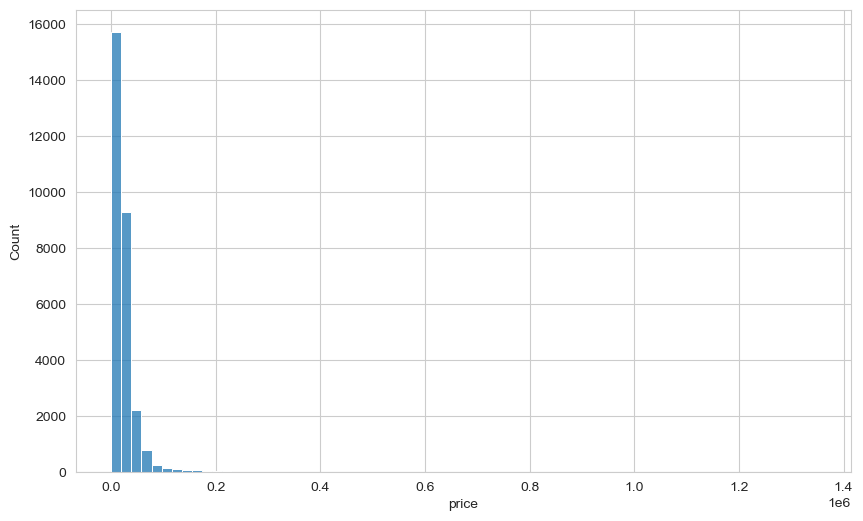

In [173]:
sns.histplot(df.price, bins =70)

In [163]:
df.head().T

,0,1,2,3,4
make_model,Mercedes-Benz A 160,Mercedes-Benz EQE 350,Mercedes-Benz A 45 AMG,Mercedes-Benz A 35 AMG,Mercedes-Benz A 45 AMG
make,Mercedes-Benz,Mercedes-Benz,Mercedes-Benz,Mercedes-Benz,Mercedes-Benz
model,A 160,EQE 350,A 45 AMG,A 35 AMG,A 45 AMG
price,16950,80900,69900,46990,16800
body_type,Compact,Compact,Compact,Compact,Compact
type,Used,Pre-registered,Used,Used,Used
doors,5,4,5,5,5
country_version,Spain,Spain,Spain,Spain,Spain
offer_number,7468157,7054863,7410454,7464503,7127931
warranty,24 months,24 months,12 months,12 months,12 months


In [160]:
df['price'] = df['price'].astype(int)

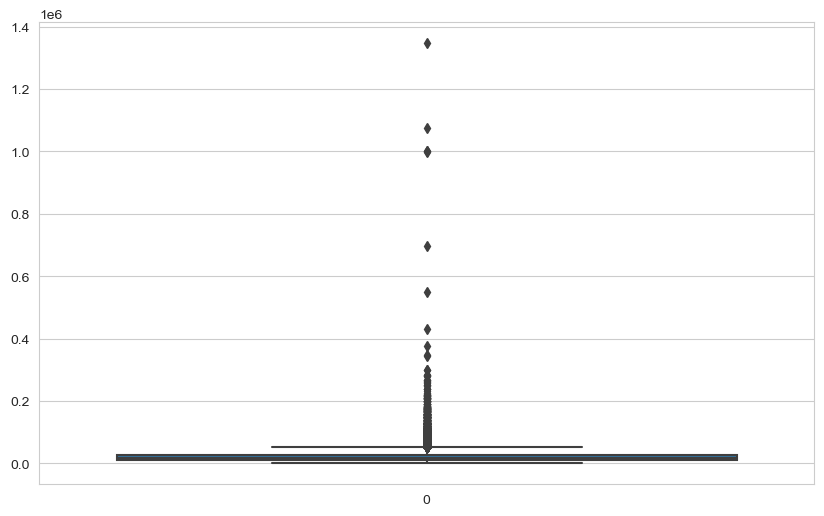

In [161]:
sns.boxplot(df.price);

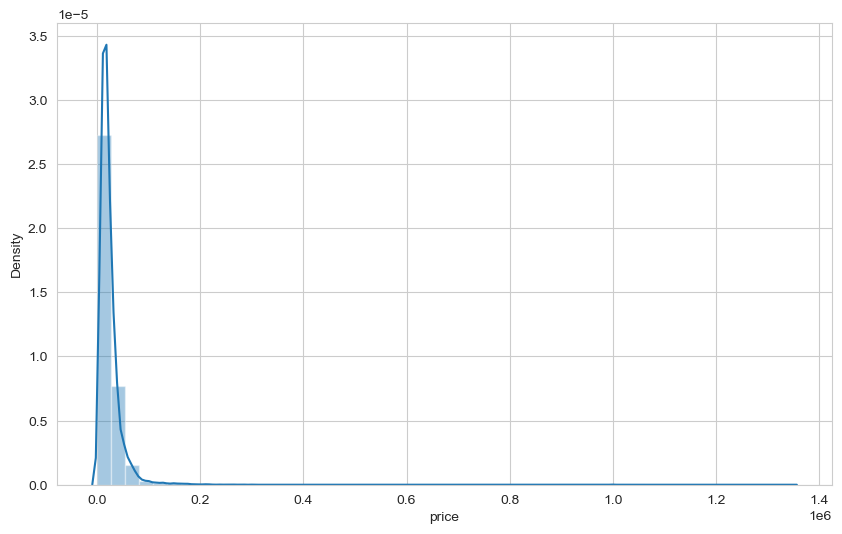

In [162]:
sns.distplot(df.price);

### make_model

In [90]:
df.make_model.value_counts(dropna=False)

Renault Megane              863
NaN                         850
SEAT Leon                   787
Volvo V40                   740
Dacia Sandero               730
Hyundai i30                 706
Volvo C70                   692
Opel Astra                  675
Ford Mustang                663
Peugeot 308                 537
Ford Focus                  495
Nissan Qashqai              490
SEAT Ibiza                  442
Fiat 500                    440
Fiat Tipo                   430
Renault Clio                417
Ford Fiesta                 400
Nissan Micra                390
Fiat 500X                   376
Skoda Octavia               371
Opel Corsa                  366
Volvo XC60                  364
Dacia Duster                349
Toyota Yaris                332
Volvo V60                   309
Opel Insignia               290
Peugeot 208                 262
Skoda Fabia                 251
Fiat 500C                   249
Toyota Auris                231
Volvo C30                   231
Peugeot 

In [92]:
df['make_model'] = df['make_model'].astype(str)

### fuel_consumption --> comb, city, country

In [97]:
first_looking("fuel_consumption")

column name    :  fuel_consumption
--------------------------------
per_of_nulls   :  % 20.68
num_of_nulls   :  6095
num_of_uniques :  3453
--------------------------------
NaN                                                                              6095
[[0 l/100 km (comb.)]]                                                            330
[[0 l/100 km (comb.)], [0 l/100 km (city)], [0 l/100 km (country)]]               306
[[3.4 l/100 km (comb.)], [3.7 l/100 km (city)], [3.2 l/100 km (country)]]         170
[[4 l/100 km (comb.)]]                                                            149
[[3.9 l/100 km (comb.)]]                                                          133
[[3.8 l/100 km (comb.)], [4.2 l/100 km (city)], [3.6 l/100 km (country)]]         110
[[5.1 l/100 km (comb.)], [6.4 l/100 km (city)], [4.3 l/100 km (country)]]         105
[[5.4 l/100 km (comb.)], [6.2 l/100 km (city)], [5 l/100 km (country)]]           101
[[3.7 l/100 km (comb.)], [4.4 l/100 km (city)], [3.3 

In [81]:
def extract_fuel_consumption(value, type):
    pattern = re.compile(r'(\d+\.?\d*) l/100 km \(' + type + '\)')
    matches = pattern.findall(str(value))
    return float(matches[0]) if matches else None

In [82]:
df['fuel_consumption_comb'] = df['fuel_consumption'].apply(lambda x: extract_fuel_consumption(x, 'comb.'))
df['fuel_consumption_city'] = df['fuel_consumption'].apply(lambda x: extract_fuel_consumption(x, 'city'))
df['fuel_consumption_country'] = df['fuel_consumption'].apply(lambda x: extract_fuel_consumption(x, 'country'))


In [84]:
df = df.drop(columns=['fuel_consumption'])

### first_registration

In [90]:
first_looking("first_registration")

column name    :  first_registration
--------------------------------
per_of_nulls   :  % 2.89
num_of_nulls   :  852
num_of_uniques :  656
--------------------------------
NaN        852
08/2022    454
06/2022    428
05/2019    420
06/2019    418
07/2019    416
07/2022    412
06/2018    396
01/2019    390
05/2022    375
03/2019    372
05/2018    366
12/2021    364
03/2018    353
07/2018    349
04/2019    323
04/2022    317
06/2021    316
07/2020    315
09/2022    313
02/2019    309
01/2018    299
08/2018    294
08/2019    285
01/2022    282
03/2021    278
04/2018    275
05/2021    270
11/2018    267
03/2022    263
07/2021    261
02/2018    260
01/2020    251
04/2017    249
02/2020    248
03/2017    247
10/2021    238
10/2018    233
02/2022    232
05/2017    231
06/2020    230
06/2017    229
09/2021    225
12/2018    223
09/2020    218
11/2020    215
12/2020    214
01/2017    214
09/2019    208
11/2017    207
08/2020    207
07/2017    205
08/2021    197
09/2017    189
02/2021    188
10/

In [91]:
df['first_registration'] = pd.to_datetime(df['first_registration'], format='%m/%Y')

### mileage_km

In [110]:
df.mileage.value_counts()

10 km           586
1 km            172
50 km           133
100 km          119
5,000 km        118
5 km            114
20 km           101
15 km            91
100,000 km       79
3,000 km         77
90,000 km        72
8,000 km         66
2 km             66
160,000 km       64
6,000 km         64
60,000 km        62
10,000 km        60
150,000 km       59
140,000 km       59
15,000 km        58
1,500 km         54
80,000 km        54
130,000 km       53
120,000 km       53
85,000 km        52
1,000 km         51
110,000 km       50
200,000 km       50
9,900 km         49
65,000 km        48
9,500 km         48
170,000 km       48
50,000 km        48
89,000 km        47
75,000 km        47
55,000 km        45
125,000 km       45
70,000 km        44
2,500 km         43
4,500 km         43
30,000 km        42
25,000 km        42
500 km           41
9 km             41
20,000 km        41
3,500 km         40
190,000 km       40
45,000 km        40
99,000 km        40
180,000 km       39


In [111]:
df['mileage_km'] = df['mileage'].str.replace('km', '').str.replace(',', '').astype(float)
df = df.drop(columns=['mileage'])

### fuel_type

In [115]:
df.fuel_type.value_counts()

Gasoline                                                                                              8532
Diesel                                                                                                5911
Super 95                                                                                              3557
Diesel (Particle filter)                                                                              2816
Regular/Benzine 91                                                                                    2065
Super E10 95                                                                                          1016
Regular/Benzine 91 (Particle filter)                                                                   555
Super 95 (Particle filter)                                                                             537
Super E10 95 (Particle filter)                                                                         324
Regular/Benzine E10 91               

In [121]:
# Consolidate similar categories
df['fuel_type'] = df['fuel_type'].str.replace(r' \(Particle filter\)', '', regex=True)

In [124]:
df = df.drop(columns=['fuel_type_consolidated'])

KeyError: "['fuel_type_consolidated'] not found in axis"

In [125]:
df.fuel_type.value_counts(dropna=False)

Gasoline                                                                                              8728
Diesel                                                                                                8727
Super 95                                                                                              4094
NaN                                                                                                   2637
Regular/Benzine 91                                                                                    2620
Super E10 95                                                                                          1340
Regular/Benzine E10 91                                                                                 286
Others                                                                                                 213
Electric                                                                                               188
Super Plus 98                        

### co_emissions

In [188]:
df.co_emissions.value_counts()

0 g/km (comb.)         1038
119 g/km (comb.)        393
124 g/km (comb.)        340
129 g/km (comb.)        319
114 g/km (comb.)        313
99 g/km (comb.)         312
115 g/km (comb.)        304
139 g/km (comb.)        298
109 g/km (comb.)        265
108 g/km (comb.)        262
149 g/km (comb.)        255
125 g/km (comb.)        255
123 g/km (comb.)        230
138 g/km (comb.)        230
130 g/km (comb.)        227
120 g/km (comb.)        218
117 g/km (comb.)        214
110 g/km (comb.)        213
127 g/km (comb.)        211
126 g/km (comb.)        204
111 g/km (comb.)        204
104 g/km (comb.)        197
112 g/km (comb.)        186
95 g/km (comb.)         183
107 g/km (comb.)        179
135 g/km (comb.)        178
116 g/km (comb.)        175
154 g/km (comb.)        173
134 g/km (comb.)        171
145 g/km (comb.)        170
122 g/km (comb.)        169
133 g/km (comb.)        165
178 g/km (comb.)        164
113 g/km (comb.)        161
106 g/km (comb.)        158
128 g/km (comb.)    

In [189]:
df['co_emissions_g_km'] = df['co_emissions'].str.extract('(\d+)').astype(float)


In [191]:
df = df.drop(columns=['co_emissions'])

### Current

In [192]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 28630 entries, 0 to 29478
Data columns (total 35 columns):
 #   Column                    Non-Null Count  Dtype         
---  ------                    --------------  -----         
 0   make_model                28630 non-null  object        
 1   make                      28630 non-null  object        
 2   model                     28630 non-null  string        
 3   price                     28630 non-null  int64         
 4   body_type                 28630 non-null  object        
 5   type                      28630 non-null  object        
 6   doors                     28271 non-null  object        
 7   country_version           16889 non-null  object        
 8   offer_number              23100 non-null  string        
 9   first_registration        28628 non-null  datetime64[ns]
 10  gearbox                   28382 non-null  object        
 11  fuel_type                 26843 non-null  object        
 12  colour            

In [193]:
df.head().T

,0,1,2,3,4
make_model,Mercedes-Benz A 160,Mercedes-Benz EQE 350,Mercedes-Benz A 45 AMG,Mercedes-Benz A 35 AMG,Mercedes-Benz A 45 AMG
make,Mercedes-Benz,Mercedes-Benz,Mercedes-Benz,Mercedes-Benz,Mercedes-Benz
model,A 160,EQE 350,A 45 AMG,A 35 AMG,A 45 AMG
price,16950,80900,69900,46990,16800
body_type,Compact,Compact,Compact,Compact,Compact
type,Used,Pre-registered,Used,Used,Used
doors,5,4,5,5,5
country_version,Spain,Spain,Spain,Spain,Spain
offer_number,7468157,7054863,7410454,7464503,7127931
first_registration,2016-06-01 00:00:00,2022-06-01 00:00:00,2020-07-01 00:00:00,2020-01-01 00:00:00,2015-09-01 00:00:00


In [96]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 29480 entries, 0 to 29479
Data columns (total 33 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   make_model               29480 non-null  object 
 1   make                     29480 non-null  object 
 2   model                    28630 non-null  string 
 3   price                    28630 non-null  float64
 4   body_type                28630 non-null  object 
 5   type                     28630 non-null  object 
 6   doors                    28271 non-null  object 
 7   country_version          16889 non-null  object 
 8   offer_number             23100 non-null  string 
 9   warranty                 15784 non-null  object 
 10  mileage                  28629 non-null  object 
 11  first_registration       28628 non-null  object 
 12  gearbox                  28382 non-null  object 
 13  fuel_type                26843 non-null  object 
 14  colour                

In [98]:
df.duplicated()

TypeError: unhashable type: 'list'

In [98]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 29480 entries, 0 to 29479
Data columns (total 33 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   make_model               29480 non-null  object 
 1   make                     29480 non-null  object 
 2   model                    28630 non-null  string 
 3   price                    28630 non-null  float64
 4   body_type                28630 non-null  object 
 5   type                     28630 non-null  object 
 6   doors                    28271 non-null  object 
 7   country_version          16889 non-null  object 
 8   offer_number             23100 non-null  string 
 9   warranty                 15784 non-null  object 
 10  mileage                  28629 non-null  object 
 11  first_registration       28628 non-null  object 
 12  gearbox                  28382 non-null  object 
 13  fuel_type                26843 non-null  object 
 14  colour                

### Wordcloud

In [101]:
pip install wordcloud

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 222.8/222.8 kB 6.4 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  DEPRECATION: wordcloud is being installed using the legacy 'setup.py install' method, because it does not have a 'pyproject.toml' and the 'wheel' package is not installed. pip 23.1 will enforce this behaviour change. A possible replacement is to enable the '--use-pep517' option. Discussion can be found at https://github.com/pypa/pip/issues/8559
  Running setup.py install for wordcloud ... done

[notice] A new release of pip is available: 23.0.1 -> 23.1.2
[notice] To update, run: pip3.11 install --upgrade pip
Note: you may need to restart the kernel to use updated packages.


In [104]:
import wordcloud

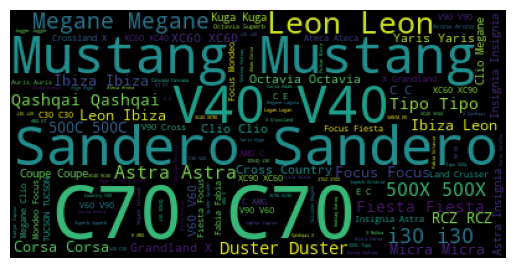

In [107]:
a = wordcloud.WordCloud().generate(" ".join(df.model.dropna()))
plt.imshow(a)
plt.axis("off")
plt.show()

In [194]:
df.to_csv("as24_cars_cleaned.csv", index=False)

# PART- 2 `( Handling With Missing Vales )`

In [2]:
#importing essenstial libraries
import numpy as np
import pandas as pd
import seaborn as sns 
import matplotlib.pyplot as plt
import re

import warnings
warnings.filterwarnings("ignore")
warnings.warn("this will not show")

#Remove display restrictions
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)

pd.set_option('display.max_rows', None)
pd.set_option('display.expand_frame_repr', True)
pd.set_option('display.width', 1000)  # Adjust the desired width

In [3]:
df = pd.read_csv("as24_cars_cleaned.csv")

In [4]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 28630 entries, 0 to 28629
Data columns (total 36 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   make_model                28630 non-null  object 
 1   make                      28630 non-null  object 
 2   model                     28630 non-null  object 
 3   price                     28630 non-null  int64  
 4   body_type                 28630 non-null  object 
 5   type                      28630 non-null  object 
 6   doors                     28271 non-null  float64
 7   country_version           16889 non-null  object 
 8   offer_number              23100 non-null  object 
 9   first_registration        28628 non-null  object 
 10  gearbox                   28382 non-null  object 
 11  fuel_type                 26843 non-null  object 
 12  colour                    26906 non-null  object 
 13  seller                    28630 non-null  object 
 14  seats 

In [5]:
df.shape

(28630, 36)

In [6]:
df.head()

,make_model,make,model,price,body_type,type,doors,country_version,offer_number,first_registration,gearbox,fuel_type,colour,seller,seats,gears,drivetrain,cylinders,empty_weight,model_code,general_inspection,full_service_history,emission_class,production_date,previous_owner,energy_efficiency_class,co_efficiency,warranty_in_month,engine_size_cc,power_hp,fuel_consumption_comb,fuel_consumption_city,fuel_consumption_country,age_in_months,mileage_km,co_emissions_g_km
0,Mercedes-Benz A 160,Mercedes-Benz,A 160,16950,Compact,Used,5.0,Spain,7468157,2016-06-01,Manual,Diesel,Black,Dealer,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,24.0,NaN,NaN,NaN,NaN,NaN,85.0,120200.0,NaN
1,Mercedes-Benz EQE 350,Mercedes-Benz,EQE 350,80900,Compact,Pre-registered,4.0,Spain,7054863,2022-06-01,Automatic,Electric,NaN,Dealer,5.0,9.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,24.0,1.0,292.0,NaN,NaN,NaN,12.0,5000.0,0.0
2,Mercedes-Benz A 45 AMG,Mercedes-Benz,A 45 AMG,69900,Compact,Used,5.0,Spain,7410454,2020-07-01,Automatic,Gasoline,Grey,Dealer,5.0,8.0,4WD,4.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,12.0,1991.0,421.0,8.4,10.9,5.8,35.0,18900.0,NaN
3,Mercedes-Benz A 35 AMG,Mercedes-Benz,A 35 AMG,46990,Compact,Used,5.0,Spain,7464503,2020-01-01,Automatic,Gasoline,Yellow,Dealer,5.0,7.0,4WD,4.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,12.0,1991.0,306.0,7.3,9.3,6.1,42.0,18995.0,NaN
4,Mercedes-Benz A 45 AMG,Mercedes-Benz,A 45 AMG,16800,Compact,Used,5.0,Spain,7127931,2015-09-01,Automatic,Diesel,White,Dealer,5.0,7.0,4WD,4.0,1545.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,12.0,2143.0,136.0,4.9,5.7,4.4,94.0,197000.0,NaN


In [7]:
#calculate the percentage of missing values in each column of the dataframe.
null_ratios = df.isnull().sum()/df.shape[0]*100
df.isnull().sum()/df.shape[0]*100

make_model                   0.000000
make                         0.000000
model                        0.000000
price                        0.000000
body_type                    0.000000
type                         0.000000
doors                        1.253929
country_version             41.009431
offer_number                19.315403
first_registration           0.006986
gearbox                      0.866224
fuel_type                    6.241705
colour                       6.021656
seller                       0.000000
seats                       10.915124
gears                       33.796717
drivetrain                  40.995459
cylinders                   34.152986
empty_weight                37.974153
model_code                  70.775410
general_inspection          57.198743
full_service_history        56.112469
emission_class              37.621376
production_date             79.364303
previous_owner              51.047852
energy_efficiency_class     72.741879
co_efficienc

### Columns with NaN

In [8]:
columns_with_null = null_ratios[null_ratios > 0]
null_ratios[null_ratios > 0]

doors                        1.253929
country_version             41.009431
offer_number                19.315403
first_registration           0.006986
gearbox                      0.866224
fuel_type                    6.241705
colour                       6.021656
seats                       10.915124
gears                       33.796717
drivetrain                  40.995459
cylinders                   34.152986
empty_weight                37.974153
model_code                  70.775410
general_inspection          57.198743
full_service_history        56.112469
emission_class              37.621376
production_date             79.364303
previous_owner              51.047852
energy_efficiency_class     72.741879
co_efficiency               72.741879
warranty_in_month           52.968914
engine_size_cc               4.900454
power_hp                     1.997904
fuel_consumption_comb       18.934684
fuel_consumption_city       30.097800
fuel_consumption_country    30.080335
age_in_month

### Check all columns values regarding null values


In [61]:
for c in df.columns:
    print(f"Total Numbers of null values in column {c} : {df[c].isnull().sum()}")

Total Numbers of null values in column make_model : 0
Total Numbers of null values in column make : 0
Total Numbers of null values in column model : 0
Total Numbers of null values in column price : 0
Total Numbers of null values in column body_type : 0
Total Numbers of null values in column type : 0
Total Numbers of null values in column doors : 0
Total Numbers of null values in column country_version : 10681
Total Numbers of null values in column offer_number : 5058
Total Numbers of null values in column first_registration : 0
Total Numbers of null values in column gearbox : 0
Total Numbers of null values in column fuel_type : 1651
Total Numbers of null values in column colour : 1598
Total Numbers of null values in column seller : 0
Total Numbers of null values in column seats : 2939
Total Numbers of null values in column gears : 8802
Total Numbers of null values in column drivetrain : 10998
Total Numbers of null values in column cylinders : 8977
Total Numbers of null values in column

### Global functions to help filling missing values

In [9]:
# function for first looking to the columns

def first_looking(col):
    print("column name    : ", col)
    print("--------------------------------")
    print("per_of_nulls   : ", "%", round(df[col].isnull().sum()/df.shape[0]*100, 2))
    print("num_of_nulls   : ", df[col].isnull().sum())
    print("num_of_uniques : ", df[col].nunique())
    print(df[col].value_counts(dropna = False))

In [38]:
# function for handling missing values with the most existing value (mode) in the relevant column according to single-stage grouping

def fill_most(df, group_col, col_name):
    '''Fills the missing values with the most existing value (mode) in the relevant column according to single-stage grouping'''
    for group in list(df[group_col].unique()):
        cond = df[group_col]==group
        mode = list(df[cond][col_name].mode())
        if mode != []:
            df.loc[cond, col_name] = df.loc[cond, col_name].fillna(df[cond][col_name].mode()[0])
        else:
            df.loc[cond, col_name] = df.loc[cond, col_name].fillna(df[col_name].mode()[0])
    print("Number of NaN : ",df[col_name].isnull().sum())
    print("------------------")
    print(df[col_name].value_counts(dropna=False))

In [ ]:
# function for handling missing values with "ffill and bfill method" according to single-stage grouping

def fill_prop(df, group_col, col_name):
    for group in list(df[group_col].unique()):
        cond = df[group_col]==group
        df.loc[cond, col_name] = df.loc[cond, col_name].fillna(method="ffill").fillna(method="bfill")
    df[col_name] = df[col_name].fillna(method="ffill").fillna(method="bfill")
    print("Number of NaN : ",df[col_name].isnull().sum())
    print("------------------")
    print(df[col_name].value_counts(dropna=False))

In [ ]:
# function for handling missing values with "mode" or "median" or "ffill"

def fill(df, group_col1, group_col2, col_name, method): 
    if method == "mode":
        for group1 in list(df[group_col1].unique()):
            for group2 in list(df[group_col2].unique()):
                cond1 = df[group_col1]==group1
                cond2 = (df[group_col1]==group1) & (df[group_col2]==group2)
                mode1 = list(df[cond1][col_name].mode())
                mode2 = list(df[cond2][col_name].mode())
                if mode2 != []:
                    df.loc[cond2, col_name] = df.loc[cond2, col_name].fillna(df[cond2][col_name].mode()[0])
                elif mode1 != []:
                    df.loc[cond2, col_name] = df.loc[cond2, col_name].fillna(df[cond1][col_name].mode()[0])
                else:
                    df.loc[cond2, col_name] = df.loc[cond2, col_name].fillna(df[col_name].mode()[0])
                
    elif method == "median":
        for group1 in list(df[group_col1].unique()):
            for group2 in list(df[group_col2].unique()):
                cond1 = df[group_col1]==group1
                cond2 = (df[group_col1]==group1) & (df[group_col2]==group2)
                df.loc[cond2, col_name] = df.loc[cond2, col_name].fillna(df[cond2][col_name].median()).fillna(df[cond1][col_name].median()).fillna(df[col_name].median())
                
    elif method == "ffill":           
        for group1 in list(df[group_col1].unique()):
            for group2 in list(df[group_col2].unique()):
                cond2 = (df[group_col1]==group1) & (df[group_col2]==group2)
                df.loc[cond2, col_name] = df.loc[cond2, col_name].fillna(method="ffill").fillna(method="bfill")
                
        for group1 in list(df[group_col1].unique()):
            cond1 = df[group_col1]==group1
            df.loc[cond1, col_name] = df.loc[cond1, col_name].fillna(method="ffill").fillna(method="bfill")            
           
        df[col_name] = df[col_name].fillna(method="ffill").fillna(method="bfill")
    
    print("Number of NaN : ",df[col_name].isnull().sum())
    print("------------------")
    print(df[col_name].value_counts(dropna=False))

### Fill missing values column by column

### doors

In [16]:
first_looking("doors")

column name    :  doors
--------------------------------
per_of_nulls   :  % 0.0
num_of_nulls   :  0
num_of_uniques :  7
5.0              17481
2.0               5523
4.0               3001
3.0               2259
not available      359
6.0                  5
1.0                  2
Name: doors, dtype: int64


In [11]:
df['doors'].fillna('not available', inplace=True)

In [12]:
df["doors"].value_counts(dropna=False)

5.0              17481
2.0               5523
4.0               3001
3.0               2259
not available      359
6.0                  5
1.0                  2
Name: doors, dtype: int64

In [13]:
df.groupby("doors").describe()

price                                                                               seats                                                  gears                                               cylinders                                               empty_weight                                                                    production_date                                                                 warranty_in_month                                                      engine_size_cc                                                                    power_hp                                                           fuel_consumption_comb                                                 fuel_consumption_city                                                       fuel_consumption_country                                                age_in_months                                                               mileage_km                                                   \
                 count          mean           std      min      25%      50%      75%        max    count      mean       std  min  25%  50%  75%   max    count      mean       std  min  25%  50%  75%   max     count      mean       std  min  25%  50%  75%   max        count         mean         std     min     25%     50%      75%      max           count         mean        std     min     25%     50%     75%     max             count       mean        std   min   25%   50%   75%    max          count         mean          std     min     25%     50%     75%      max    count        mean         std   min    25%    50%    75%    max                 count      mean       std  min  25%   50%   75%   max                 count       mean       std  min    25%    50%     75%   max                    count      mean       std  min  25%  50%   75%   max         count        mean         std     min     25%    50%    75%     max      count           mean           std      min        25%   
doors                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                   
1.0                2.0  15395.000000   5098.239892  11790.0  13592.5  15395.0  17197.5    19000.0      1.0  4.000000       NaN  4.0  4.0  4.0  4.0   4.0      1.0  5.000000       NaN  5.0  5.0  5.0  5.0   5.0       2.0  2.000000  2.828427  0.0  1.0  2.0  3.0   4.0          1.0   976.000000         NaN   976.0   976.0   976.0   976.00    976.0             1.0  2017.000000        NaN  2017.0  2017.0  2017.0  2017.0  2017.0               1.0  60.000000        NaN  60.0  60.0  60.0  60.0   60.0            2.0  1321.000000   111.722871  1242.0  1281.5  1321.0  1360.5   1400.0      2.0   85.000000    4.242641  82.0   83.5   85.0   86.5   88.0                   1.0  5.200000       NaN  5.2  5.2  5.20  5.20   5.2                   0.0        NaN       NaN  NaN    NaN    NaN     NaN   NaN                      0.0       NaN       NaN  NaN  NaN  NaN   NaN   NaN           2.0  379.000000  429.920923    75.0  227.00  379.0  531.0   683.0        2.0   31550.000000  23970.919882  14600.0   23075.00   
2.0          

### mileage_km

In [19]:
first_looking("mileage_km")

column name    :  mileage_km
--------------------------------
per_of_nulls   :  % 0.0
num_of_nulls   :  1
num_of_uniques :  14183
10.0         586
1.0          172
50.0         133
100.0        119
5000.0       118
5.0          114
20.0         101
15.0          91
100000.0      79
3000.0        77
90000.0       72
8000.0        66
2.0           66
160000.0      64
6000.0        64
60000.0       62
10000.0       60
150000.0      59
140000.0      59
15000.0       58
1500.0        54
80000.0       54
120000.0      53
130000.0      53
85000.0       52
1000.0        51
110000.0      50
200000.0      50
9900.0        49
50000.0       48
65000.0       48
170000.0      48
9500.0        48
75000.0       47
89000.0       47
125000.0      45
55000.0       45
70000.0       44
2500.0        43
4500.0        43
25000.0       42
30000.0       42
20000.0       41
500.0         41
9.0           41
45000.0       40
3500.0        40
190000.0      40
99000.0       40
180000.0      39
12.0          38
900

In [22]:
cond1 = (df['mileage_km'] < 10000)
cond2 = ((df['mileage_km'] >= 10000) & (df['mileage_km'] < 50000))
cond3 = ((df['mileage_km'] >= 50000) & (df['mileage_km'] < 100000))
cond4 = (df['mileage_km'] >= 100000)

In [24]:
#df.loc[cond1,'age_in_month'] = df.loc[cond1,'age_in_month'].replace('-', 0)
#df.loc[cond2,'age_in_month'] = df.loc[cond2,'age_in_month'].replace('-', 1)
#df.loc[cond3,'age_in_month'] = df.loc[cond3,'age_in_month'].replace('-', 2)
#df.loc[cond4,'age_in_month'] = df.loc[cond4,'age_in_month'].replace('-', 3)

In [27]:
df.mileage_km.value_counts()

10.0         586
1.0          172
50.0         133
100.0        119
5000.0       118
5.0          114
20.0         101
15.0          91
100000.0      79
3000.0        77
90000.0       72
8000.0        66
2.0           66
160000.0      64
6000.0        64
60000.0       62
10000.0       60
150000.0      59
140000.0      59
15000.0       58
1500.0        54
80000.0       54
130000.0      53
120000.0      53
85000.0       52
1000.0        51
110000.0      50
200000.0      50
9900.0        49
65000.0       48
9500.0        48
170000.0      48
50000.0       48
89000.0       47
75000.0       47
55000.0       45
125000.0      45
70000.0       44
2500.0        43
4500.0        43
30000.0       42
25000.0       42
500.0         41
9.0           41
20000.0       41
3500.0        40
190000.0      40
45000.0       40
99000.0       40
180000.0      39
12.0          38
9000.0        38
105000.0      38
35000.0       38
28000.0       37
150.0         37
2000.0        37
40000.0       36
12000.0       

In [31]:
df.groupby(['make_model',"body_type"]).price.describe()

count           mean            std       min        25%       50%         75%        max
make_model               body_type                                                                                                   
Dacia                     Compact             3.0   21431.000000    1661.743663   19515.0   20907.00   22299.0    22389.00    22479.0
                          Sedan               1.0    9999.000000            NaN    9999.0    9999.00    9999.0     9999.00     9999.0
                          Station wagon       1.0   21799.000000            NaN   21799.0   21799.00   21799.0    21799.00    21799.0
Dacia Break               Station wagon       1.0   20500.000000            NaN   20500.0   20500.00   20500.0    20500.00    20500.0
Dacia Dokker              Compact             1.0   11930.000000            NaN   11930.0   11930.00   11930.0    11930.00    11930.0
                          Off-Road/Pick-up    2.0   12490.000000       0.000000   12490.0   12490.00   12490.0    12490.00    12490.0
                          Sedan               1.0    8900.000000            NaN    8900.0    8900.00    8900.0     8900.00     8900.0
                          Station wagon      52.0   13344.115385    3269.214577    3890.0   11987.50   13945.0    14990.00    19997.0
Dacia Duster              Convertible         1.0   16900.000000            NaN   16900.0   16900.00   16900.0    16900.00    16900.0
                          Off-Road/Pick-up  321.0   16678.940810    4506.607325    5700.0   13500.00   16590.0    19900.00    29950.0
                          Sedan               4.0   15835.000000     827.385440   14950.0   15362.50   15745.0    16217.50    16900.0
                          Station wagon      23.0   16169.565217    6985.354470    4800.0   12125.00   16790.0    19395.00    27960.0
Dacia Jogger              Off-Road/Pick-up    1.0   24280.000000            NaN   24280.0   24280.00   24280.0    24280.00    24280.0
                          Sedan               1.0   22140.000000            NaN   22140.0   22140.00   22140.0    22140.00    22140.0
                          Station wagon      84.0   25307.440476    1856.494308   18160.0   24900.00   26298.0    26298.00    26298.0
Dacia Lodgy               Compact             1.0   16500.000000            NaN   16500.0   16500.00   16500.0    16500.00    16500.0
                          Sedan               2.0   19400.000000    7778.174593   13900.0   16650.00   19400.0    22150.00    24900.0
                          Station wagon      69.0   12835.333333    3690.459670    4999.0   10650.00   12490.0    15935.00    24900.0
Dacia Logan               Compact            13.0    9634.769231    1719.612318    6250.0    8695.00    9399.0    10900.00    11950.0
                          Sedan              35.0    8749.857143    4266.424403    1650.0    7490.00    7990.0    11145.00    17685.0
                          Station wagon     151.0    9039.933775    3453.851575    1490.0    6450.00    9117.0    10990.00    17990.0
Dacia Sandero             Compact           340.0   11976.252941    3164.736432    2300.0   10499.00   12572.0    14409.00    21990.0
                          Convertible         1.0   12900.000000            NaN   12900.0   12900.00   12900.0    12900.00    12900.0
                          Coupe               2.0   11400.000000    2121.320344    9900.0   10650.00   11400.0    12150.00    12900.0
                          Off-Road/Pick-up   50.0   16616.440000    3256.390378    7000.0   14124.00   18990.0    18990.00    18990.0
                          Sedan             333.0   11747.858859    3550.860138    2400.0    8990.00   11208.0    13900.00    19990.0
                          Station wagon       4.0    9763.250000    2044.025827    6990.0    8871.75   10249.0    11140.50    11565.0
Dacia Spring              Compact            27.0   22753.666667     912.015899   19269.0   22985.00   22985.0    22985.00    23090.0
                        

### body_type

In [32]:
first_looking("body_type")

column name    :  body_type
--------------------------------
per_of_nulls   :  % 0.0
num_of_nulls   :  0
num_of_uniques :  6
 Station wagon       5448
 Off-Road/Pick-up    5415
 Compact             5387
 Sedan               5043
 Coupe               4009
 Convertible         3328
Name: body_type, dtype: int64


### power_hp

In [33]:
first_looking("power_hp")

column name    :  power_hp
--------------------------------
per_of_nulls   :  % 2.0
num_of_nulls   :  572
num_of_uniques :  347
150.0    1992
131.0    1356
120.0    1182
110.0    1166
90.0     1110
140.0    1033
116.0    1002
101.0     893
190.0     787
69.0      701
95.0      685
136.0     681
NaN       572
75.0      515
125.0     477
200.0     458
170.0     422
163.0     418
109.0     349
179.0     339
122.0     318
184.0     296
235.0     249
160.0     247
156.0     246
177.0     241
114.0     240
105.0     236
300.0     234
204.0     232
280.0     224
91.0      213
111.0     204
86.0      200
197.0     199
132.0     185
72.0      176
141.0     163
392.0     155
80.0      149
194.0     143
99.0      139
250.0     138
165.0     134
60.0      133
82.0      133
224.0     130
245.0     130
102.0     128
92.0      127
275.0     126
145.0     124
73.0      120
258.0     119
450.0     118
328.0     117
220.0     115
71.0      112
135.0     111
310.0     105
306.0     104
230.0     103
118.

In [34]:
df["power_hp"].fillna("-", inplace=True)

In [35]:
df.groupby(["make_model", "body_type","power_hp"]).price.describe()

count          mean            std        min         25%        50%         75%        max
make_model               body_type         power_hp                                                                                             
Dacia                     Compact          45.0        3.0  2.143100e+04    1661.743663    19515.0    20907.00    22299.0    22389.00    22479.0
                          Sedan            54.0        1.0  9.999000e+03            NaN     9999.0     9999.00     9999.0     9999.00     9999.0
                          Station wagon    110.0       1.0  2.179900e+04            NaN    21799.0    21799.00    21799.0    21799.00    21799.0
Dacia Break               Station wagon    -           1.0  2.050000e+04            NaN    20500.0    20500.00    20500.0    20500.00    20500.0
Dacia Dokker              Compact          90.0        1.0  1.193000e+04            NaN    11930.0    11930.00    11930.0    11930.00    11930.0
                          Off-Road/Pick-up 102.0       2.0  1.249000e+04       0.000000    12490.0    12490.00    12490.0    12490.00    12490.0
                          Sedan            75.0        1.0  8.900000e+03            NaN     8900.0     8900.00     8900.0     8900.00     8900.0
                          Station wagon    75.0       11.0  1.112091e+04    2907.677611     4790.0     9990.00    12490.0    12690.00    14500.0
                                           83.0        2.0  4.745000e+03    1209.152596     3890.0     4317.50     4745.0     5172.50     5600.0
                                           90.0        8.0  1.469562e+04     769.022745    13475.0    14287.50    14990.0    15055.00    15700.0
                                           95.0       10.0  1.380750e+04    1306.830878    11980.0    12467.50    14417.5    14845.00    14845.0
                                           101.0       1.0  1.099000e+04            NaN    10990.0    10990.00    10990.0    10990.00    10990.0
                                           102.0       8.0  1.425475e+04    2292.803072    10990.0    12392.25    14985.0    15992.25    16900.0
                                           109.0       4.0  1.746000e+04    2088.444397    14980.0    16420.00    17440.0    18480.00    19980.0
                                           116.0       5.0  1.200380e+04    2307.884789     9950.0     9990.00    11699.0    12890.00    15490.0
                                           131.0       3.0  1.718233e+04    2849.102724    14300.0    15775.00    17250.0    18623.50    19997.0
Dacia Duster              Convertible      114.0       1.0  1.690000e+04            NaN    16900.0    16900.00    16900.0    16900.00    16900.0
                          Off-Road/Pick-up 86.0        1.0  5.700000e+03            NaN     5700.0     5700.00     5700.0     5700.00     5700.0
                                           90.0        7.0  1.275214e+04    2023.828585     9500.0    11740.00    12495.0    14445.00    14900.0
                                           91.0        5.0  2.115800e+04    1759.366363    18540.0    20990.00    21390.0    21390.00    23480.0
                                           95.0        2.0  1.549000e+04       0.000000    15490.0    15490.00    15490.0    15490.00    15490.0
                                           101.0      18.0  1.931133e+04    1914.053629    15640.0    18044.25    19900.0    20610.00    22200.0
                                           102.0       1.0  1.620000e+04            NaN    16200.0    16200.00    16200.0    16200.00    16200.0
                                           105.0      14.0  9.252429e+03    2825.325624     5900.0     7081.25     8675.0    11099.75    15490.0
                                           107.0       1.0  1.050000e+04            NaN    10500.0    10500.00    10500.0    10500.00    10500.0
                                           109.0      48.0  1.337904e+04    2651.965244     7500.0    11665.00    12674.5    14922.50    1

### fuel_consumption_comp

In [37]:
first_looking("fuel_consumption_comb")

column name    :  fuel_consumption_comb
--------------------------------
per_of_nulls   :  % 18.93
num_of_nulls   :  5421
num_of_uniques :  160
NaN     5421
5.0      818
4.9      809
4.5      690
5.1      639
0.0      637
4.7      615
4.8      609
5.4      595
5.6      594
4.3      564
5.3      553
4.6      548
5.2      546
4.2      539
4.1      517
3.8      516
5.5      502
5.7      501
5.9      497
4.0      483
4.4      442
6.4      438
6.0      423
6.3      412
5.8      395
3.7      359
3.9      350
3.6      325
7.0      308
6.5      289
3.4      287
6.1      281
6.2      275
6.6      273
6.9      269
7.4      265
7.1      253
6.7      251
6.8      226
7.3      220
7.2      200
8.0      194
8.4      193
7.6      181
3.5      167
8.2      166
7.8      165
7.7      165
7.5      156
12.0     110
3.3      107
9.0      106
9.2      103
12.5     102
8.6       95
9.8       93
8.9       92
3.0       84
7.9       83
8.7       79
9.6       77
9.5       77
1.7       77
8.3       75
1.5       7

In [39]:
fill_most(df, "make_model", "fuel_consumption_comb")

Number of NaN :  0
------------------
5.0     1594
4.9     1103
4.5     1041
0.0      826
5.1      802
4.7      744
5.4      728
4.8      713
4.3      703
5.6      667
4.1      661
3.8      657
3.7      640
5.7      637
4.2      629
4.0      615
4.4      615
4.6      615
5.2      580
5.5      570
5.3      561
3.9      529
5.9      514
6.4      503
6.3      484
6.0      429
5.8      398
3.6      389
12.0     386
3.4      346
7.0      326
8.2      326
6.5      322
7.4      316
6.1      303
6.6      284
6.2      282
6.9      276
7.1      260
6.7      253
6.8      244
7.3      232
8.4      227
7.7      222
7.2      217
8.0      211
7.5      199
7.6      181
7.8      171
3.5      167
8.9      163
9.0      141
9.2      123
12.5     118
10.1     112
1.5      110
1.9      108
3.3      108
8.6       95
9.8       95
8.3       92
8.7       86
1.7       85
8.5       84
3.0       84
7.9       83
9.5       83
9.4       81
10.0      81
9.7       78
8.8       78
9.6       78
11.8      74
11.4      74


### fuel_consumption_city

In [65]:
first_looking("fuel_consumption_city")

column name    :  fuel_consumption_city
--------------------------------
per_of_nulls   :  % 30.12
num_of_nulls   :  7947
num_of_uniques :  193
NaN     7947
5.8      475
6.4      455
5.7      429
5.3      422
5.9      407
6.0      402
5.5      394
6.5      390
6.3      386
0.0      375
6.1      366
6.6      365
6.2      363
5.6      351
5.0      316
5.2      315
5.4      302
6.7      292
6.8      288
4.4      288
7.8      284
5.1      270
7.0      269
4.2      268
7.6      253
4.3      244
4.7      238
8.5      237
7.5      230
7.1      219
7.9      217
4.9      217
4.6      204
4.8      201
7.2      198
7.3      194
9.3      193
4.5      192
6.9      185
8.2      183
8.9      180
7.4      178
8.6      175
9.1      174
8.0      173
8.8      170
7.7      169
8.1      166
10.1     161
3.7      161
8.7      149
9.0      146
4.1      145
8.4      131
10.4     124
11.5     124
9.6      117
10.0     112
11.2     107
3.8      107
9.5      106
10.2     105
10.9     104
8.3      102
4.0       9

In [66]:
fill_most(df, "make_model", "fuel_consumption_city")

Number of NaN :  0
------------------
5.8     1361
6.4      813
5.5      756
5.3      677
5.7      667
5.0      560
6.0      558
0.0      544
4.3      534
5.4      533
6.7      526
4.4      521
7.0      517
6.5      505
6.6      503
5.6      499
6.2      489
6.8      467
4.2      462
6.3      461
5.9      419
4.7      394
6.1      370
7.1      367
5.1      355
3.0      335
7.3      332
18.3     332
5.2      331
11.2     309
7.8      291
4.9      285
7.6      273
7.5      253
8.5      252
4.6      242
7.9      240
8.1      236
8.6      230
4.5      226
8.9      225
9.3      225
9.1      224
4.0      217
4.8      210
10.1     207
7.2      205
3.8      200
3.7      199
8.2      199
6.9      195
7.4      193
8.8      191
9.0      189
7.7      186
8.0      184
3.2      159
8.7      159
4.1      150
10.3     137
11.5     137
8.4      136
10.0     133
10.4     128
9.5      123
9.6      122
10.2     115
10.9     112
8.3      111
14.0     102
9.7       95
9.4       93
14.4      93
13.0      91


### fuel_consumption_country

In [64]:
first_looking("fuel_consumption_country")

column name    :  fuel_consumption_country
--------------------------------
per_of_nulls   :  % 30.1
num_of_nulls   :  7942
num_of_uniques :  111
NaN     7942
4.3      829
4.0      741
4.2      707
4.7      684
5.0      653
3.9      627
3.6      615
4.5      610
3.8      610
4.6      605
4.9      604
4.1      586
5.1      554
4.4      542
3.7      508
5.7      436
5.2      424
4.8      411
5.3      397
5.4      376
0.0      364
5.5      364
5.6      360
5.8      335
3.4      320
3.3      307
5.9      288
3.5      272
6.5      265
6.2      255
3.2      239
6.0      234
6.1      224
6.3      185
6.4      183
6.7      175
7.0      163
6.9      148
3.0      136
6.8      127
3.1      109
8.7      106
7.8      101
6.6       99
7.1       98
7.6       89
9.1       84
8.1       82
7.3       77
7.2       76
7.4       75
8.5       74
8.2       69
8.3       68
7.7       67
8.8       64
8.0       60
7.9       55
9.3       53
9.6       43
7.5       39
8.9       35
2.9       34
9.0       33
8.4      

In [67]:
fill_most(df, "make_model", "fuel_consumption_country")

Number of NaN :  0
------------------
4.3     2130
5.0     1306
4.0     1093
4.2      993
4.7      951
3.9      928
4.1      906
3.6      896
3.7      888
3.8      880
4.4      816
4.5      768
5.1      681
4.9      659
4.6      631
5.5      607
6.5      561
0.0      533
5.2      506
5.6      487
5.3      487
4.8      472
3.3      471
5.7      468
5.4      460
5.9      434
3.5      425
5.8      363
3.4      344
8.5      338
6.2      315
3.0      311
3.2      285
6.0      246
6.1      239
7.0      236
6.7      215
3.1      201
6.4      200
6.3      189
6.9      181
6.8      146
7.6      142
7.8      136
8.7      118
7.1      117
7.2      108
6.6       99
7.3       91
8.3       86
9.1       84
9.0       82
8.1       82
7.4       77
8.8       74
8.0       72
7.7       71
8.2       69
7.9       56
9.3       54
9.6       45
7.5       42
8.9       36
2.9       34
8.6       34
9.8       30
8.4       30
10.5      27
9.5       24
9.7       24
11.0      23
9.2       22
11.2      18
10.0      15


### Handling Duplicates

In [42]:
df.duplicated().sum()

2011

In [46]:
df.drop_duplicates(inplace=True)

### Check all Columns null values

In [52]:
# Check all columns values regarding null values
for c in df.columns:
    print(f"Total Numbers of null values in column {c} : {df[c].isnull().sum()}")

Total Numbers of null values in column make_model : 0
Total Numbers of null values in column make : 0
Total Numbers of null values in column model : 0
Total Numbers of null values in column price : 0
Total Numbers of null values in column body_type : 0
Total Numbers of null values in column type : 0
Total Numbers of null values in column doors : 0
Total Numbers of null values in column country_version : 10873
Total Numbers of null values in column offer_number : 5170
Total Numbers of null values in column first_registration : 0
Total Numbers of null values in column gearbox : 234
Total Numbers of null values in column fuel_type : 1662
Total Numbers of null values in column colour : 1670
Total Numbers of null values in column seller : 0
Total Numbers of null values in column seats : 2996
Total Numbers of null values in column gears : 8988
Total Numbers of null values in column drivetrain : 11191
Total Numbers of null values in column cylinders : 9160
Total Numbers of null values in colu

### age_in_months

In [51]:
df.dropna(subset=['age_in_months'], inplace=True)

In [53]:
# Check all columns values regarding null values
for c in df.columns:
    print(f"Total Numbers of null values in column {c} : {df[c].isnull().sum()}")

Total Numbers of null values in column make_model : 0
Total Numbers of null values in column make : 0
Total Numbers of null values in column model : 0
Total Numbers of null values in column price : 0
Total Numbers of null values in column body_type : 0
Total Numbers of null values in column type : 0
Total Numbers of null values in column doors : 0
Total Numbers of null values in column country_version : 10873
Total Numbers of null values in column offer_number : 5170
Total Numbers of null values in column first_registration : 0
Total Numbers of null values in column gearbox : 234
Total Numbers of null values in column fuel_type : 1662
Total Numbers of null values in column colour : 1670
Total Numbers of null values in column seller : 0
Total Numbers of null values in column seats : 2996
Total Numbers of null values in column gears : 8988
Total Numbers of null values in column drivetrain : 11191
Total Numbers of null values in column cylinders : 9160
Total Numbers of null values in colu

In [54]:
df.dropna(subset=['mileage_km'], inplace=True)

In [55]:
df.dropna(subset=['gearbox'], inplace=True)

In [56]:
# Check all columns values regarding null values
for c in df.columns:
    print(f"Total Numbers of null values in column {c} : {df[c].isnull().sum()}")

Total Numbers of null values in column make_model : 0
Total Numbers of null values in column make : 0
Total Numbers of null values in column model : 0
Total Numbers of null values in column price : 0
Total Numbers of null values in column body_type : 0
Total Numbers of null values in column type : 0
Total Numbers of null values in column doors : 0
Total Numbers of null values in column country_version : 10681
Total Numbers of null values in column offer_number : 5058
Total Numbers of null values in column first_registration : 0
Total Numbers of null values in column gearbox : 0
Total Numbers of null values in column fuel_type : 1651
Total Numbers of null values in column colour : 1598
Total Numbers of null values in column seller : 0
Total Numbers of null values in column seats : 2939
Total Numbers of null values in column gears : 8802
Total Numbers of null values in column drivetrain : 10998
Total Numbers of null values in column cylinders : 8977
Total Numbers of null values in column

In [59]:
first_looking("age_in_months")


column name    :  age_in_months
--------------------------------
per_of_nulls   :  % 0.0
num_of_nulls   :  0
num_of_uniques :  637
 10.0      444
 12.0      414
 11.0      394
 49.0      390
 48.0      380
 50.0      379
 61.0      369
 13.0      364
 54.0      360
 52.0      333
 60.0      325
 18.0      319
 62.0      314
 24.0      310
 14.0      304
 51.0      304
 64.0      298
 9.0       298
 35.0      296
 59.0      282
 53.0      277
 17.0      274
 66.0      272
 47.0      272
 25.0      263
 63.0      262
 27.0      260
 15.0      255
 23.0      252
 56.0      247
 42.0      241
 75.0      235
 76.0      234
 41.0      234
 65.0      225
 16.0      225
 20.0      217
 74.0      215
 57.0      212
 21.0      211
 36.0      211
 73.0      209
 78.0      206
 31.0      205
 55.0      204
 30.0      203
 33.0      200
 72.0      192
 46.0      192
 22.0      190
 68.0      188
 34.0      187
 70.0      179
 28.0      178
 69.0      173
 19.0      168
 45.0      167
 26.0      165

In [60]:
# Check all columns values regarding null values
for c in df.columns:
    print(f"Total Numbers of null values in column {c} : {df[c].isnull().sum()}")

Total Numbers of null values in column make_model : 0
Total Numbers of null values in column make : 0
Total Numbers of null values in column model : 0
Total Numbers of null values in column price : 0
Total Numbers of null values in column body_type : 0
Total Numbers of null values in column type : 0
Total Numbers of null values in column doors : 0
Total Numbers of null values in column country_version : 10681
Total Numbers of null values in column offer_number : 5058
Total Numbers of null values in column first_registration : 0
Total Numbers of null values in column gearbox : 0
Total Numbers of null values in column fuel_type : 1651
Total Numbers of null values in column colour : 1598
Total Numbers of null values in column seller : 0
Total Numbers of null values in column seats : 2939
Total Numbers of null values in column gears : 8802
Total Numbers of null values in column drivetrain : 10998
Total Numbers of null values in column cylinders : 8977
Total Numbers of null values in column

### fuel type

In [76]:
first_looking("fuel_type")

column name    :  fuel_type
--------------------------------
per_of_nulls   :  % 6.26
num_of_nulls   :  1651
num_of_uniques :  31
Gasoline                                                                                              8148
Diesel                                                                                                7681
Super 95                                                                                              3832
Regular/Benzine 91                                                                                    2500
NaN                                                                                                   1651
Super E10 95                                                                                          1298
Regular/Benzine E10 91                                                                                 277
Others                                                                                                 198
Super Plus 98 

In [83]:
df.groupby(["make_model", "fuel_type"]).count()

make  model  price  body_type  type  doors  country_version  offer_number  first_registration  gearbox  colour  seller  seats  gears  drivetrain  cylinders  empty_weight  model_code  general_inspection  full_service_history  emission_class  production_date  previous_owner  energy_efficiency_class  co_efficiency  warranty_in_month  engine_size_cc  power_hp  fuel_consumption_comb  fuel_consumption_city  fuel_consumption_country  age_in_months  mileage_km  co_emissions_g_km
make_model               fuel_type                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                      
Dacia                    Gasoline                                               1      1      1          1     1      1                0             0                   1        1       1       1      1      1           0          1             1           0                   1                     0               0                0               0                        0              0                  0               1         1                      1                      1                         1              1           1                  0
                         Super 95                                               1      1      1          1     1      1                1             1                   1        1       1       1      1      0           0          0             0           1                   0                     0               1                0               1                        1              1                  0               1         1                      1                      1                         1              1           1                  1
Dacia Break              Gasoline                                               1      1      1          1     1      1                0             0                   1        1       1       1      0      0           0          0             0           0                   0                     0               0                0               0                        0              0                  1               0         1                      1                      1                         1              1           1                  0
Dacia Dokker             CNG                                                    1      1      1          1     1      1                1             1                   1        1       1       1      0      0           0          0             0           0                   0                     0               0                0               0                        0              0                  0               1         1                      1                      1                         1              1           1                  0
                         Diesel                                                31     31     31         31    31     31               27            27                  31       31      30      31      7      6           1          5             6           2                   2                     2               4                0               3                        1              1                 21              24        31                     31                     31                        31             31          31                  5
                         Gasoline                                               8      8      8          8     8      8                3             3                   8        8       8       8      6    

In [90]:
df_fuel_nan = df[df['fuel_type'].isna()]
df_fuel_nan.groupby(['make','model']).count()

make_model  price  body_type  type  doors  country_version  offer_number  first_registration  gearbox  fuel_type  colour  seller  seats  gears  drivetrain  cylinders  empty_weight  model_code  general_inspection  full_service_history  emission_class  production_date  previous_owner  energy_efficiency_class  co_efficiency  warranty_in_month  engine_size_cc  power_hp  fuel_consumption_comb  fuel_consumption_city  fuel_consumption_country  age_in_months  mileage_km  co_emissions_g_km
make          model                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                               
Dacia                                 3      3          3     3      3                3             3                   3        3          0       3       3      3      1           1          0             1           1                   0                     2               2                1               3                        3              3                  0               1         3                      3                      3                         3              3           3                  0
              Spring                 36     36         36    36     36               34            35                  36       36          0      36      36     36     27          10          2            29          27                  32                    31              29                0              28                       33             33                  0               0        36                     36                     36                        36             36          36                  0
Fiat                                  1      1          1     1      1                1             1                   1        1          0       1       1      1      1           1          0             1           0                   1                     1               1                1               1                        1              1                  0               0         1                      1                      1                         1              1           1                  0
              500                    83     83         83    83     83               33            66                  83       83          0      81      83     80     69          60         54            56          11                  28                    23              70               18              38                       14             14                 46              70        83                     83                     83                        83             83          83                 55
              500C                   40     40         40    40     40               21            36                  40       40          0      39      40     40     38          33         29            34           8                  19                    14              35               16               9                       15             15                 20              30        40                     40                     40                        40             40          40                 26
              500e                   24     24         24    24     24               18            18                  24       24          0      24      24     22     17          13          3            21          15                  18                    17               3               10              17                       15             15                  7               5        24                     24     

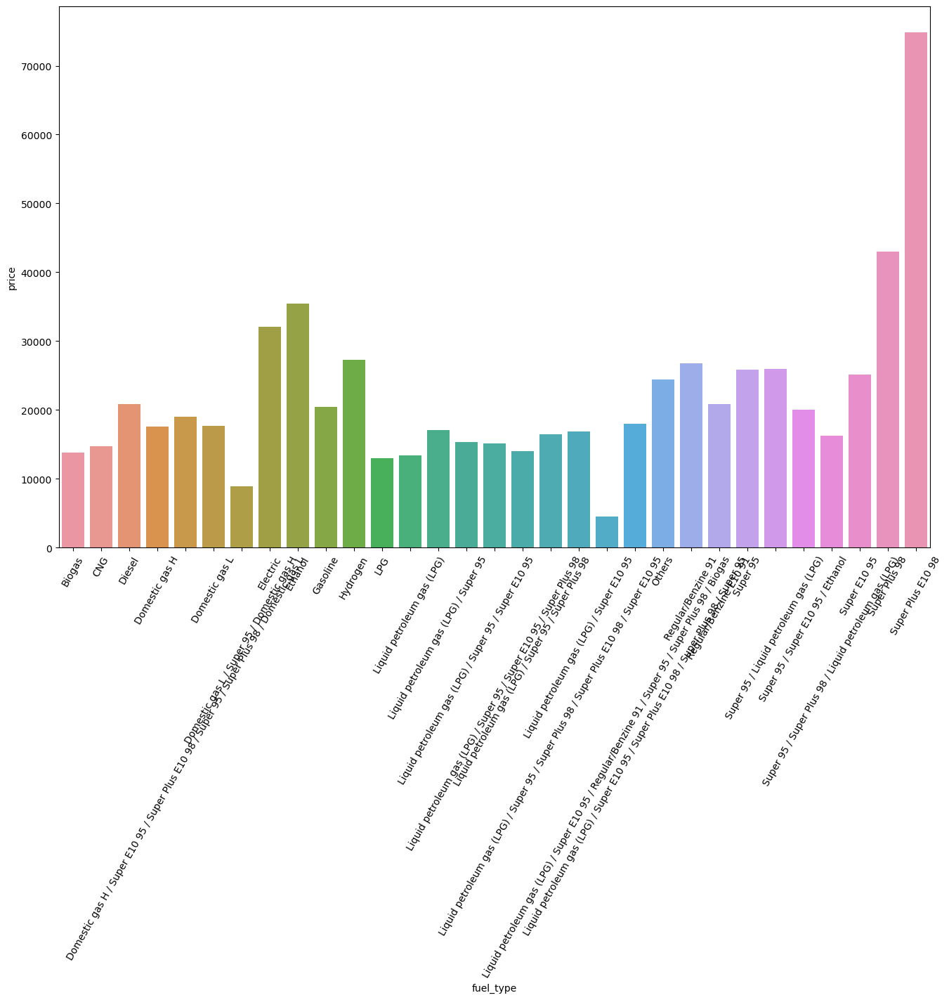

In [100]:
plt.figure(figsize=(16,10))
sns.barplot(x =h.index , y = h , hue = )
plt.xticks(rotation = 60);

In [129]:
df[df.fuel_type.isna()]

,make_model,make,model,price,body_type,type,doors,country_version,offer_number,first_registration,gearbox,fuel_type,colour,seller,seats,gears,drivetrain,cylinders,empty_weight,model_code,general_inspection,full_service_history,emission_class,production_date,previous_owner,energy_efficiency_class,co_efficiency,warranty_in_month,engine_size_cc,power_hp,fuel_consumption_comb,fuel_consumption_city,fuel_consumption_country,age_in_months,mileage_km,co_emissions_g_km,emission_level
16,Mercedes-Benz A 250,Mercedes-Benz,A 250,38999,Compact,Used,4.0,NaN,j302025,2021-03-01,Automatic,NaN,Grey,Dealer,NaN,NaN,NaN,NaN,NaN,NaN,09/2022,NaN,Euro 6,2021.0,NaN,NaN,NaN,NaN,1332.0,160.0,0.0,0.0,0.0,27.0,21496.0,22.0,1
32,Mercedes-Benz A 250,Mercedes-Benz,A 250,36900,Compact,Used,5.0,Spain,7456945,2021-03-01,Automatic,NaN,White,Dealer,5.0,8.0,Front,4.0,1680.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,24.0,1332.0,218.0,1.4,0.0,0.0,27.0,11990.0,NaN,4
93,Mercedes-Benz EQS,Mercedes-Benz,EQS,168444,Compact,Pre-registered,5.0,NaN,50312,2022-07-01,Automatic,NaN,Black,Dealer,4.0,NaN,4WD,NaN,2485.0,NaN,NaN,Yes,NaN,NaN,NaN,NaN,NaN,NaN,NaN,523.0,5.0,5.8,4.3,11.0,10.0,NaN,4
94,Mercedes-Benz EQS,Mercedes-Benz,EQS,122500,Compact,Pre-registered,5.0,NaN,NaN,2022-02-01,Automatic,NaN,Black,Dealer,4.0,9.0,Rear,NaN,2380.0,NaN,02/2026,Yes,NaN,NaN,NaN,NaN,NaN,12.0,NaN,-,5.0,5.8,4.3,16.0,5712.0,NaN,4
108,Mercedes-Benz EQS,Mercedes-Benz,EQS,117500,Compact,Used,5.0,NaN,R-533-JH,2022-05-01,Automatic,NaN,Blue,Dealer,4.0,9.0,Rear,NaN,2290.0,NaN,05/2026,Yes,NaN,NaN,NaN,NaN,NaN,12.0,NaN,292.0,5.0,5.8,4.3,13.0,3808.0,NaN,4
129,Mercedes-Benz A 250,Mercedes-Benz,A 250,44500,Compact,Used,5.0,NaN,P-127-ZP,2021-04-01,Automatic,NaN,Grey,Dealer,5.0,NaN,Front,4.0,1580.0,NaN,New,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1332.0,-,1.0,0.0,0.0,26.0,14250.0,0.0,1
146,Mercedes-Benz A 250,Mercedes-Benz,A 250,31718,Compact,Used,5.0,Spain,7155178,2021-01-01,Automatic,NaN,White,Dealer,5.0,8.0,Front,4.0,1680.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,12.0,1332.0,218.0,1.4,0.0,0.0,29.0,83624.0,NaN,4
153,Mercedes-Benz A 250,Mercedes-Benz,A 250,38990,Compact,Used,4.0,Spain,7430752,2020-07-01,Automatic,NaN,White,Dealer,5.0,8.0,Front,4.0,1700.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,12.0,1332.0,218.0,1.3,0.0,0.0,35.0,32800.0,NaN,4
157,Mercedes-Benz A 250,Mercedes-Benz,A 250,36999,Compact,Used,5.0,Spain,7375273,2021-03-01,Automatic,NaN,White,Dealer,5.0,8.0,Front,4.0,1680.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,12.0,1332.0,218.0,1.4,0.0,0.0,27.0,25900.0,NaN,4
177,Mercedes-Benz A 250,Mercedes-Benz,A 250,36900,Compact,Used,5.0,Spain,7456944,2021-03-01,Automatic,NaN,Blue,Dealer,5.0,8.0,Front,4.0,1680.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,24.0,1332.0,218.0,1.4,0.0,0.0,27.0,17500.0,NaN,4


In [125]:
df.columns

Index(['make_model', 'make', 'model', 'price', 'body_type', 'type', 'doors', 'country_version', 'offer_number', 'first_registration', 'gearbox', 'fuel_type', 'colour', 'seller', 'seats', 'gears', 'drivetrain', 'cylinders', 'empty_weight', 'model_code', 'general_inspection', 'full_service_history', 'emission_class', 'production_date', 'previous_owner', 'energy_efficiency_class', 'co_efficiency', 'warranty_in_month', 'engine_size_cc', 'power_hp', 'fuel_consumption_comb', 'fuel_consumption_city', 'fuel_consumption_country', 'age_in_months', 'mileage_km', 'co_emissions_g_km', 'emission_level'], dtype='object')

In [120]:
df.groupby(['fuel_type', 'emission_level'])['price'].mean()

fuel_type                                                                                           emission_level
Biogas                                                                                              2                  13800.000000
CNG                                                                                                 2                  16930.256410
                                                                                                    4                  13108.666667
Diesel                                                                                              1                  25325.650602
                                                                                                    2                  18794.476785
                                                                                                    3                  28972.703532
                                                                                             

In [117]:
df.head()

,make_model,make,model,price,body_type,type,doors,country_version,offer_number,first_registration,gearbox,fuel_type,colour,seller,seats,gears,drivetrain,cylinders,empty_weight,model_code,general_inspection,full_service_history,emission_class,production_date,previous_owner,energy_efficiency_class,co_efficiency,warranty_in_month,engine_size_cc,power_hp,fuel_consumption_comb,fuel_consumption_city,fuel_consumption_country,age_in_months,mileage_km,co_emissions_g_km,emission_level
0,Mercedes-Benz A 160,Mercedes-Benz,A 160,16950,Compact,Used,5.0,Spain,7468157,2016-06-01,Manual,Diesel,Black,Dealer,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,24.0,NaN,-,5.4,7.2,4.6,85.0,120200.0,NaN,4
1,Mercedes-Benz EQE 350,Mercedes-Benz,EQE 350,80900,Compact,Pre-registered,4.0,Spain,7054863,2022-06-01,Automatic,Electric,NaN,Dealer,5.0,9.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,24.0,1.0,292.0,5.0,5.8,4.3,12.0,5000.0,0.0,1
2,Mercedes-Benz A 45 AMG,Mercedes-Benz,A 45 AMG,69900,Compact,Used,5.0,Spain,7410454,2020-07-01,Automatic,Gasoline,Grey,Dealer,5.0,8.0,4WD,4.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,12.0,1991.0,421.0,8.4,10.9,5.8,35.0,18900.0,NaN,4
3,Mercedes-Benz A 35 AMG,Mercedes-Benz,A 35 AMG,46990,Compact,Used,5.0,Spain,7464503,2020-01-01,Automatic,Gasoline,Yellow,Dealer,5.0,7.0,4WD,4.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,12.0,1991.0,306.0,7.3,9.3,6.1,42.0,18995.0,NaN,4
4,Mercedes-Benz A 45 AMG,Mercedes-Benz,A 45 AMG,16800,Compact,Used,5.0,Spain,7127931,2015-09-01,Automatic,Diesel,White,Dealer,5.0,7.0,4WD,4.0,1545.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,12.0,2143.0,136.0,4.9,5.7,4.4,94.0,197000.0,NaN,4


In [107]:
df.co_emissions_g_km.mean()

131.80049246643605

In [111]:
df['emission_level'] = df.co_emissions_g_km.transform(lambda x : 1 if  x < 80 else 2 if x > 80 and x< 130 else 3  if x > 130 and x< 300 else 4)

### country_version

In [101]:
first_looking("country_version")

column name    :  country_version
--------------------------------
per_of_nulls   :  % 38.54
num_of_nulls   :  8774
num_of_uniques :  22
NaN                8774
 Germany           6552
 Spain             5422
 Belgium            563
 Italy              446
 European Union     304
 Austria            241
 Netherlands        233
 France              75
 Czechia             45
 Poland              28
 Hungary             19
 United States       13
 Denmark             13
 Romania             12
 Luxembourg           6
 Slovenia             5
 Switzerland          4
 Slovakia             3
 Sweden               3
 Japan                2
 Malta                1
 Bulgaria             1
Name: country_version, dtype: int64


In [102]:
df.country_version.value_counts()

 Germany           6552
 Spain             5422
 Belgium            563
 Italy              446
 European Union     304
 Austria            241
 Netherlands        233
 France              75
 Czechia             45
 Poland              28
 Hungary             19
 United States       13
 Denmark             13
 Romania             12
 Luxembourg           6
 Slovenia             5
 Switzerland          4
 Slovakia             3
 Sweden               3
 Japan                2
 Malta                1
 Bulgaria             1
Name: country_version, dtype: int64

In [103]:
#df['country_version'].dropna(inplace=True)

In [107]:
df.dropna(subset=['country_version'], inplace=True)

### Endcheck

In [108]:
for c in df.columns:
    print(f"Total Numbers of null values in column {c} : {df[c].isnull().sum()}")

Total Numbers of null values in column index : 0
Total Numbers of null values in column make_model : 0
Total Numbers of null values in column make : 0
Total Numbers of null values in column model : 0
Total Numbers of null values in column price : 0
Total Numbers of null values in column body_type : 0
Total Numbers of null values in column type : 0
Total Numbers of null values in column doors : 0
Total Numbers of null values in column country_version : 0
Total Numbers of null values in column offer_number : 1335
Total Numbers of null values in column first_registration : 0
Total Numbers of null values in column gearbox : 0
Total Numbers of null values in column fuel_type : 782
Total Numbers of null values in column colour : 661
Total Numbers of null values in column seller : 0
Total Numbers of null values in column seats : 2104
Total Numbers of null values in column gears : 4887
Total Numbers of null values in column drivetrain : 6352
Total Numbers of null values in column cylinders : 5

# PART- 3 `( Handling With Outliers )`

In [3]:
#importing essenstial libraries
import numpy as np
import pandas as pd
import seaborn as sns 
import matplotlib.pyplot as plt
import re

import warnings
warnings.filterwarnings("ignore")

In [36]:
df = pd.read_csv("as24_cars_filled_nan.csv")

### Basic dataset

In [37]:
df.head().T

,0,1,2,3,4
index,1,2,3,4,5
make_model,Mercedes-Benz EQE 350,Mercedes-Benz A 45 AMG,Mercedes-Benz A 35 AMG,Mercedes-Benz A 45 AMG,Mercedes-Benz C 160
make,Mercedes-Benz,Mercedes-Benz,Mercedes-Benz,Mercedes-Benz,Mercedes-Benz
model,EQE 350,A 45 AMG,A 35 AMG,A 45 AMG,C 160
price,80900,69900,46990,16800,4690
body_type,Compact,Compact,Compact,Compact,Compact
type,Pre-registered,Used,Used,Used,Used
doors,4.0,5.0,5.0,5.0,3.0
country_version,Spain,Spain,Spain,Spain,Germany
offer_number,7054863,7410454,7464503,7127931,NaN


### mileage_km

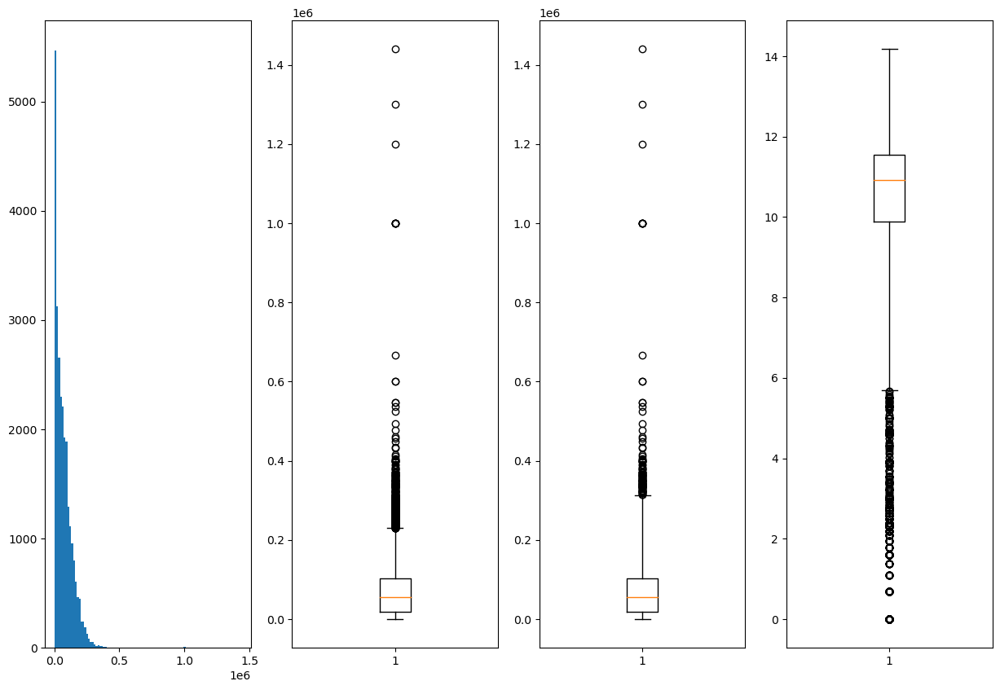

In [31]:
plt.figure(figsize=(15,10))
plt.subplot(141)
plt.hist(df.mileage_km, bins = 100)

plt.subplot(142)
plt.boxplot(df.mileage_km)

plt.subplot(143)
plt.boxplot(df.mileage_km, whis = 2.5)

plt.subplot(144)
plt.boxplot(np.log(df.mileage_km), whis = 2.5)
plt.show()

In [23]:
# calculate Q1, Q3 and IQR for 'fuel_type'
Q1 = df['mileage_km'].quantile(0.25)
Q3 = df['mileage_km'].quantile(0.75)
IQR = Q3 - Q1

# filter out rows for 'mileage_km' that are outside the IQR
df[~((df['mileage_km'] < (Q1 - 1.5 * IQR)) | (df['mileage_km'] > (Q3 + 1.5 * IQR)))]

,index,make_model,make,model,price,body_type,type,doors,country_version,offer_number,...,warranty_in_month,engine_size_cc,power_hp,fuel_consumption_comb,fuel_consumption_city,fuel_consumption_country,age_in_months,mileage_km,co_emissions_g_km,emission_level
0,0,Mercedes-Benz A 160,Mercedes-Benz,A 160,16950,Compact,Used,5.0,Spain,7468157,...,24.0,NaN,-,5.4,7.2,4.6,85.0,120200.0,NaN,4
1,1,Mercedes-Benz EQE 350,Mercedes-Benz,EQE 350,80900,Compact,Pre-registered,4.0,Spain,7054863,...,24.0,1.0,292.0,5.0,5.8,4.3,12.0,5000.0,0.0,1
2,2,Mercedes-Benz A 45 AMG,Mercedes-Benz,A 45 AMG,69900,Compact,Used,5.0,Spain,7410454,...,12.0,1991.0,421.0,8.4,10.9,5.8,35.0,18900.0,NaN,4
3,3,Mercedes-Benz A 35 AMG,Mercedes-Benz,A 35 AMG,46990,Compact,Used,5.0,Spain,7464503,...,12.0,1991.0,306.0,7.3,9.3,6.1,42.0,18995.0,NaN,4
4,4,Mercedes-Benz A 45 AMG,Mercedes-Benz,A 45 AMG,16800,Compact,Used,5.0,Spain,7127931,...,12.0,2143.0,136.0,4.9,5.7,4.4,94.0,197000.0,NaN,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
26376,28624,Volvo S60,Volvo,S60,4999,Sedan,Used,4.0,Spain,7408379,...,12.0,2521.0,209.0,9.1,12.9,6.9,226.0,166512.0,NaN,4
26377,28625,Volvo S90,Volvo,S90,37600,Sedan,Used,4.0,Spain,7449968,...,12.0,1969.0,392.0,2.0,5.3,4.3,47.0,40345.0,NaN,4
26378,28626,Volvo S40,Volvo,S40,5499,Sedan,Used,4.0,NaN,09-PF-XS,...,NaN,2435.0,170.0,9.1,13.2,6.7,231.0,145000.0,217.0,3
26379,28627,Volvo C30,Volvo,C30,7300,Sedan,Used,3.0,Belgium,NaN,...,13.0,1560.0,114.0,3.8,4.3,3.5,148.0,96000.0,99.0,2


### power_hp

In [38]:
df.power_hp.describe()

count    25836.000000
mean       161.178433
std         93.149986
min          1.000000
25%        106.000000
50%        135.000000
75%        184.000000
max        904.000000
Name: power_hp, dtype: float64

In [39]:
df.power_hp.sort_values().head(10)

5020      1.0
20374     1.0
5269      1.0
3174      1.0
7205      1.0
21051     4.0
5571      5.0
5744      5.0
23326     8.0
5380     10.0
Name: power_hp, dtype: float64

In [40]:
df.power_hp.sort_values().tail(3)

16478    900.0
18659    903.0
18553    904.0
Name: power_hp, dtype: float64

In [41]:
df.power_hp.value_counts()

150.0    1800
131.0    1333
110.0    1127
90.0     1096
120.0    1024
         ... 
670.0       1
775.0       1
506.0       1
678.0       1
904.0       1
Name: power_hp, Length: 342, dtype: int64

In [42]:
# calculate Q1, Q3 and IQR for 'fuel_type'
Q1 = df['power_hp'].quantile(0.25)
Q3 = df['power_hp'].quantile(0.75)
IQR = Q3 - Q1

# filter out rows for 'fuel_type' that are outside the IQR
#df_filtered = 
df[~((df['power_hp'] < (Q1 - 1.5 * IQR)) | (df['power_hp'] > (Q3 + 1.5 * IQR)))]


,index,make_model,make,model,price,body_type,type,doors,country_version,offer_number,...,warranty_in_month,engine_size_cc,power_hp,fuel_consumption_comb,fuel_consumption_city,fuel_consumption_country,age_in_months,mileage_km,co_emissions_g_km,emission_level
0,1,Mercedes-Benz EQE 350,Mercedes-Benz,EQE 350,80900,Compact,Pre-registered,4.0,Spain,7054863,...,24.0,1.0,292.0,5.0,5.8,4.3,12.0,5000.0,0.0,1
3,4,Mercedes-Benz A 45 AMG,Mercedes-Benz,A 45 AMG,16800,Compact,Used,5.0,Spain,7127931,...,12.0,2143.0,136.0,4.9,5.7,4.4,94.0,197000.0,NaN,4
4,5,Mercedes-Benz C 160,Mercedes-Benz,C 160,4690,Compact,Used,3.0,Germany,NaN,...,NaN,1799.0,122.0,8.2,11.6,6.2,217.0,165000.0,196.0,3
5,7,Mercedes-Benz A 220,Mercedes-Benz,A 220,26900,Compact,Used,5.0,Spain,7329555,...,24.0,1991.0,190.0,6.1,8.1,5.1,45.0,48900.0,NaN,4
7,9,Mercedes-Benz A 200,Mercedes-Benz,A 200,23900,Compact,Used,5.0,Spain,7454322,...,12.0,1991.0,139.0,5.4,6.9,4.5,59.0,21854.0,NaN,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
25830,28624,Volvo S60,Volvo,S60,4999,Sedan,Used,4.0,Spain,7408379,...,12.0,2521.0,209.0,9.1,12.9,6.9,226.0,166512.0,NaN,4
25832,28626,Volvo S40,Volvo,S40,5499,Sedan,Used,4.0,NaN,09-PF-XS,...,NaN,2435.0,170.0,9.1,13.2,6.7,231.0,145000.0,217.0,3
25833,28627,Volvo C30,Volvo,C30,7300,Sedan,Used,3.0,Belgium,NaN,...,13.0,1560.0,114.0,3.8,4.3,3.5,148.0,96000.0,99.0,2
25834,28628,Volvo S90,Volvo,S90,29900,Sedan,Used,4.0,NaN,2791,...,12.0,1969.0,254.0,6.5,8.6,5.3,68.0,94343.0,149.0,3


In [46]:
print(Q1)

106.0


In [47]:
print(Q3)

184.0


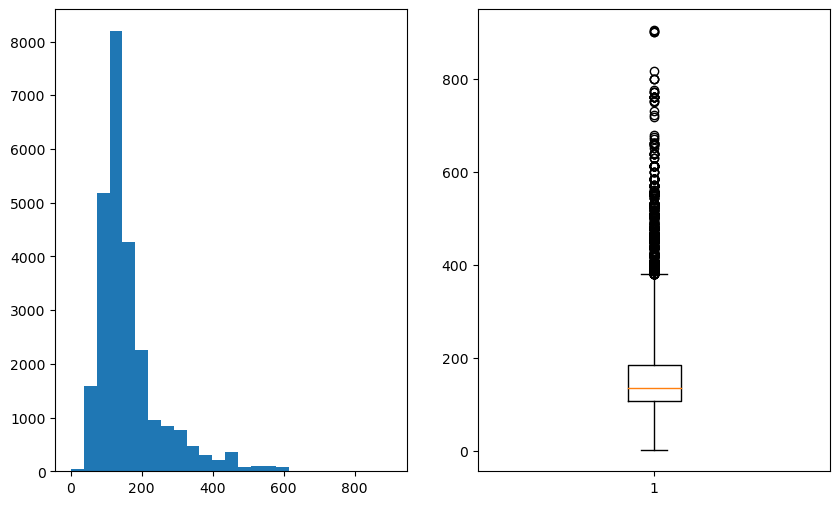

In [43]:
plt.figure(figsize = (10, 6))
plt.subplot(121)
plt.hist(df.power_hp, bins = 25)

plt.subplot(122)
plt.boxplot(df.power_hp, whis = 2.5)

plt.show()

### country_version

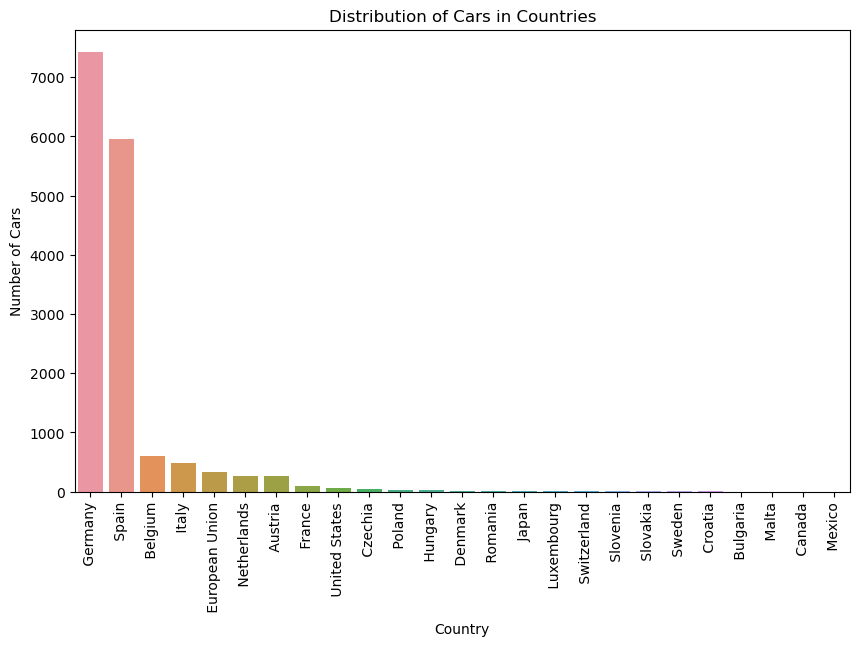

In [51]:
plt.figure(figsize=(10,6))
sns.countplot(x='country_version', data=df, order = df['country_version'].value_counts().index)
plt.title('Distribution of Cars in Countries')
plt.xlabel('Country')
plt.ylabel('Number of Cars')
plt.xticks(rotation=90)
plt.show()

In [109]:
df.groupby('country_version')['price'].mean()

country_version
 Austria           20167.020747
 Belgium           21496.436945
 Bulgaria          41990.000000
 Czechia           27409.244444
 Denmark           27310.384615
 European Union    24906.069079
 France            16064.373333
 Germany           23775.672314
 Hungary           34321.789474
 Italy             15908.320628
 Japan             28075.000000
 Luxembourg        23989.166667
 Malta             14690.000000
 Netherlands        9944.613734
 Poland            23713.392857
 Romania           20532.250000
 Slovakia          26660.000000
 Slovenia          31883.000000
 Spain             17382.993176
 Sweden            14713.333333
 Switzerland       20372.500000
 United States     30731.307692
Name: price, dtype: float64

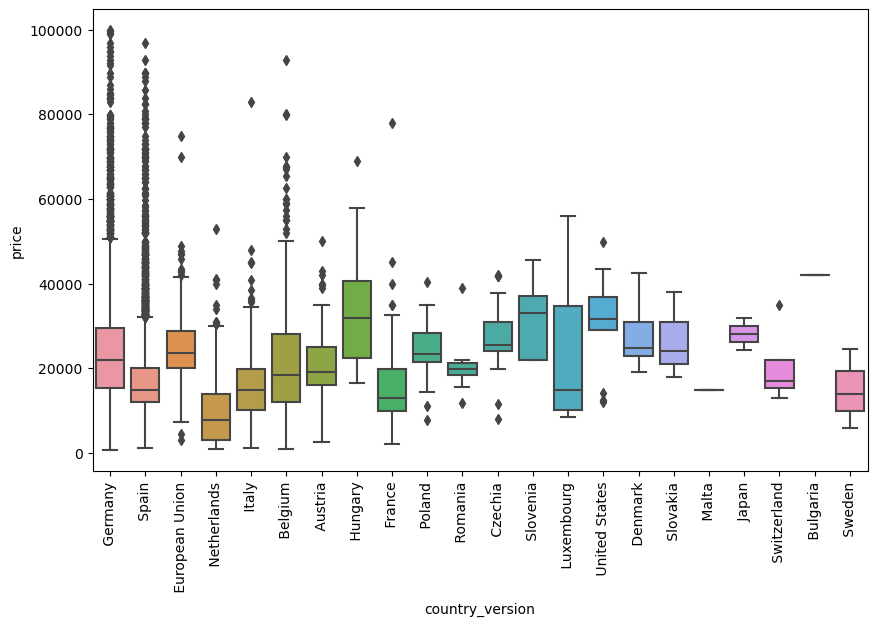

In [111]:
import seaborn as sns
import matplotlib.pyplot as plt

plt.figure(figsize=(10,6))
sns.boxplot(x='country_version', y='price', data=df)
plt.xticks(rotation=90) 
plt.show()

In [115]:
df.groupby(['make', 'country_version'])['price'].mean()

make   country_version
Dacia   Austria           17586.521739
        Belgium           10759.882353
        Czechia           24900.000000
        European Union    19436.488372
        France            12360.000000
                              ...     
Volvo   Poland            34979.000000
        Spain             21204.410758
        Sweden             9820.000000
        Switzerland       15530.000000
        United States     11890.000000
Name: price, Length: 157, dtype: float64

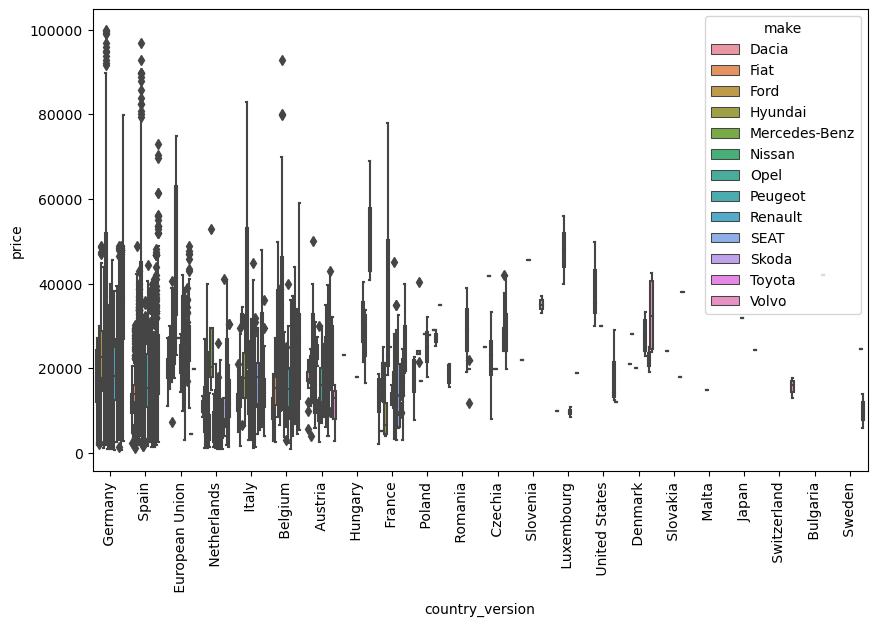

In [114]:
import seaborn as sns
import matplotlib.pyplot as plt

plt.figure(figsize=(10,6))
sns.boxplot(x='country_version', y='price', hue='make', data=df)
plt.xticks(rotation=90)  # this will rotate the country names so they don't overlap
plt.show()

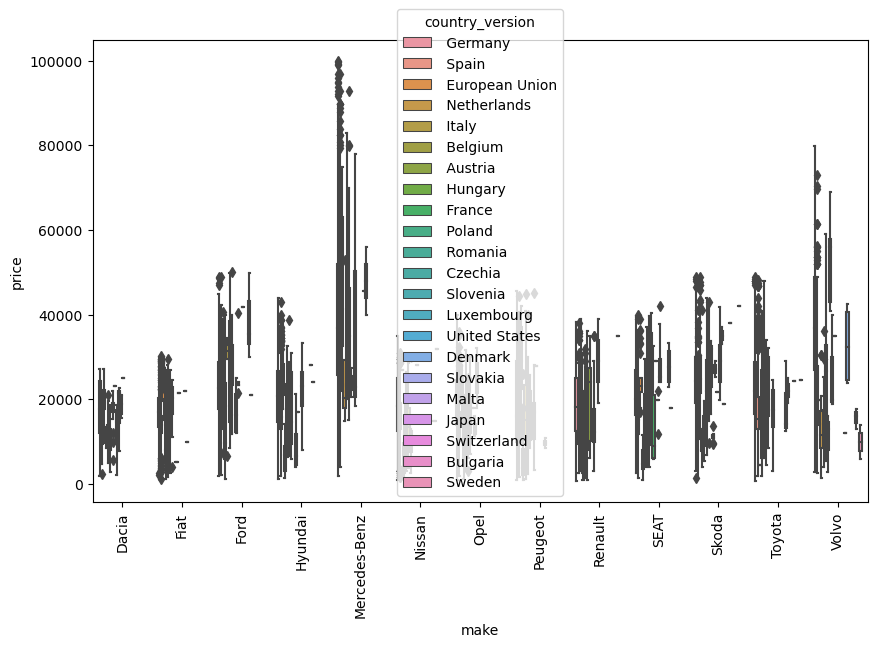

In [116]:
import seaborn as sns
import matplotlib.pyplot as plt

plt.figure(figsize=(10,6))
sns.boxplot(x='make', y='price', hue='country_version', data=df)
plt.xticks(rotation=90)  # this will rotate the country names so they don't overlap
plt.show()

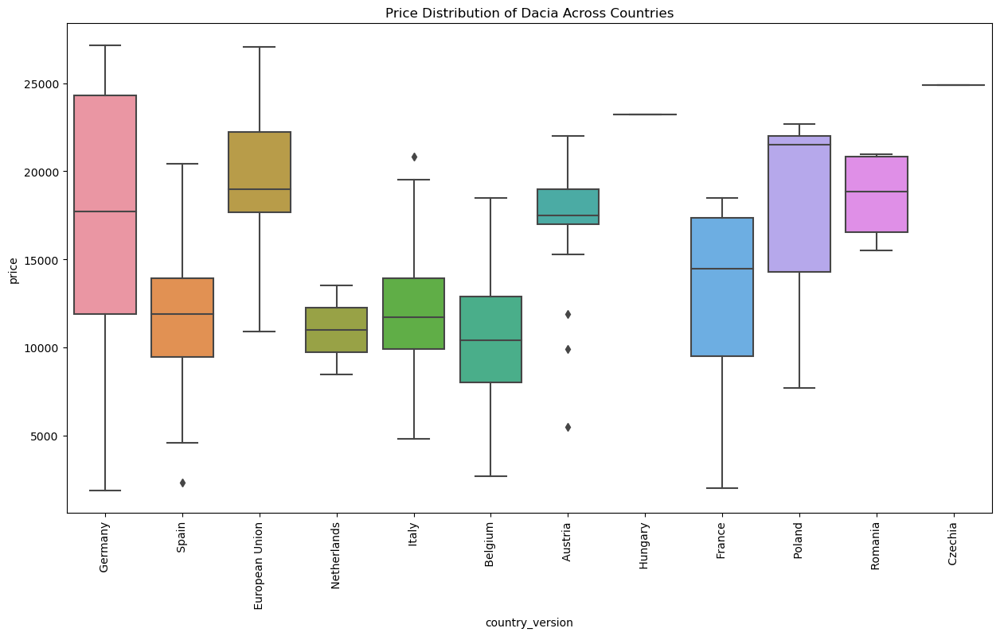

In [123]:
import seaborn as sns
import matplotlib.pyplot as plt

# Let's say we want to visualize the prices for the make 'Dacia'
specific_make_df = df[df['make'] == 'Dacia']

plt.figure(figsize=(15,8))
sns.boxplot(data=specific_make_df, x='country_version', y='price')
plt.title('Price Distribution of Dacia Across Countries')
plt.xticks(rotation=90)  # To make x-axis labels more readable
plt.show()

In [161]:
df.make_model.value_counts()

Dacia Sandero             588
SEAT Leon                 495
Hyundai i30               451
Ford Focus                346
Opel Astra                341
                         ... 
Mercedes-Benz V 250         1
Mercedes-Benz C 36 AMG      1
Mercedes-Benz C 280         1
Mercedes-Benz EQS           1
Mercedes-Benz Vito          1
Name: make_model, Length: 434, dtype: int64

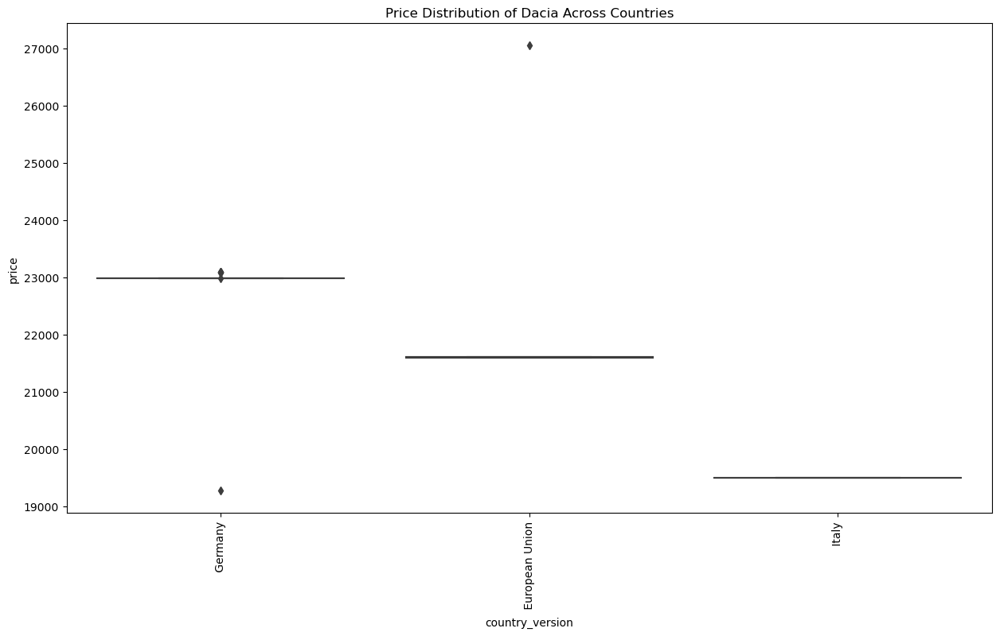

In [157]:
specific_make_df = df[df['make_model'] == 'Dacia Spring']

plt.figure(figsize=(15,8))
sns.boxplot(data=specific_make_df, x='country_version', y='price')
plt.title('Price Distribution of Dacia Across Countries')
plt.xticks(rotation=90)  # To make x-axis labels more readable
plt.show()

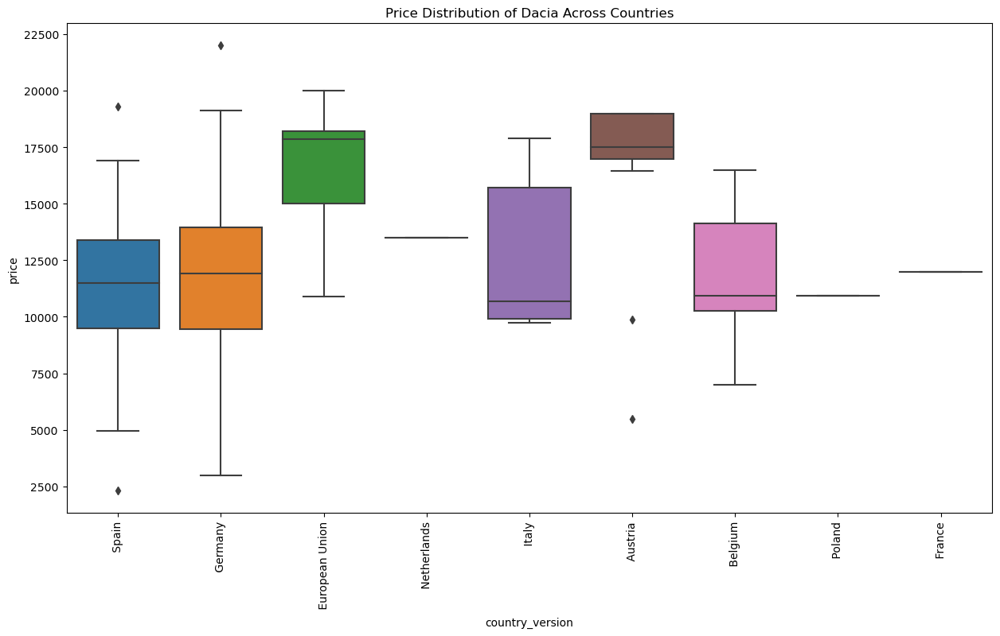

In [162]:
specific_make_df = df[df['make_model'] == 'Dacia Sandero']

plt.figure(figsize=(15,8))
sns.boxplot(data=specific_make_df, x='country_version', y='price')
plt.title('Price Distribution of Dacia Across Countries')
plt.xticks(rotation=90)  # To make x-axis labels more readable
plt.show()

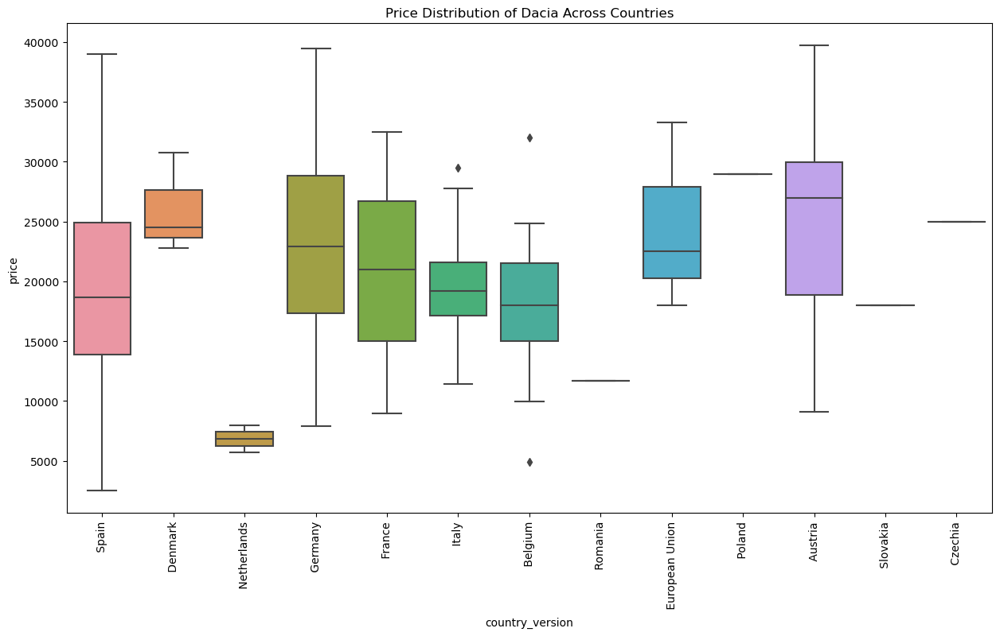

In [163]:
specific_make_df = df[df['make_model'] == 'SEAT Leon']

plt.figure(figsize=(15,8))
sns.boxplot(data=specific_make_df, x='country_version', y='price')
plt.title('Price Distribution of Dacia Across Countries')
plt.xticks(rotation=90)  # To make x-axis labels more readable
plt.show()

In [ ]:
## and so on for every make_model

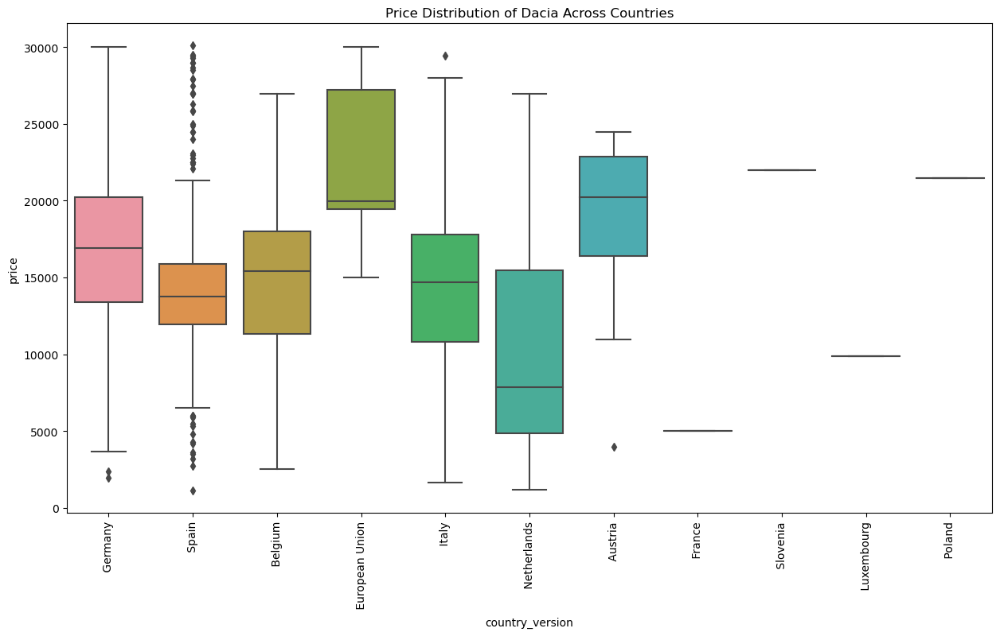

In [160]:
specific_make_df = df[df['make'] == 'Fiat']

plt.figure(figsize=(15,8))
sns.boxplot(data=specific_make_df, x='country_version', y='price')
plt.title('Price Distribution of Dacia Across Countries')
plt.xticks(rotation=90)  # To make x-axis labels more readable
plt.show()

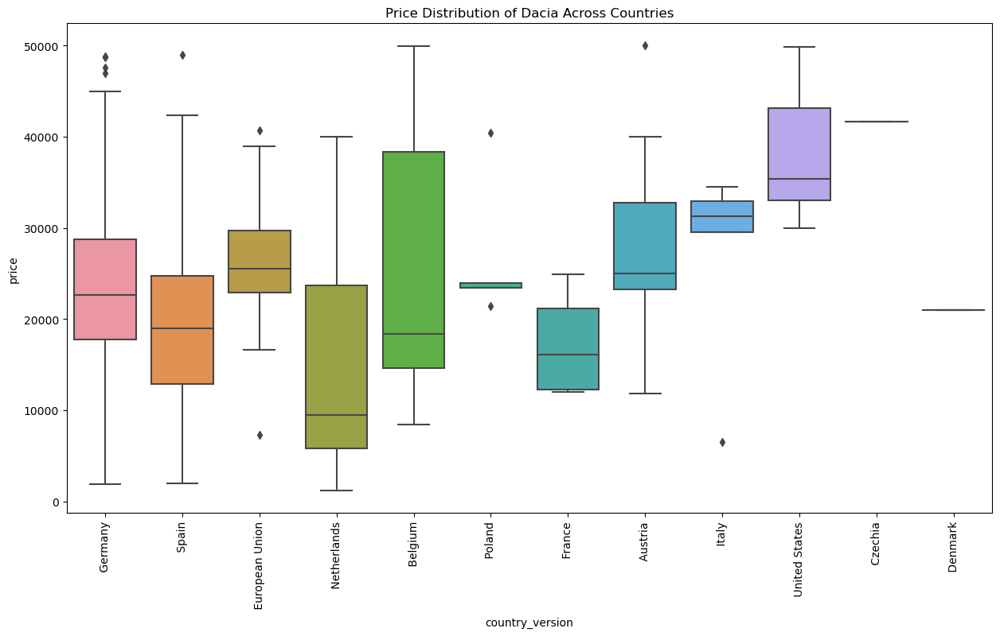

In [146]:
specific_make_df = df[df['make'] == 'Ford']

plt.figure(figsize=(15,8))
sns.boxplot(data=specific_make_df, x='country_version', y='price')
plt.title('Price Distribution of Dacia Across Countries')
plt.xticks(rotation=90)  # To make x-axis labels more readable
plt.show()

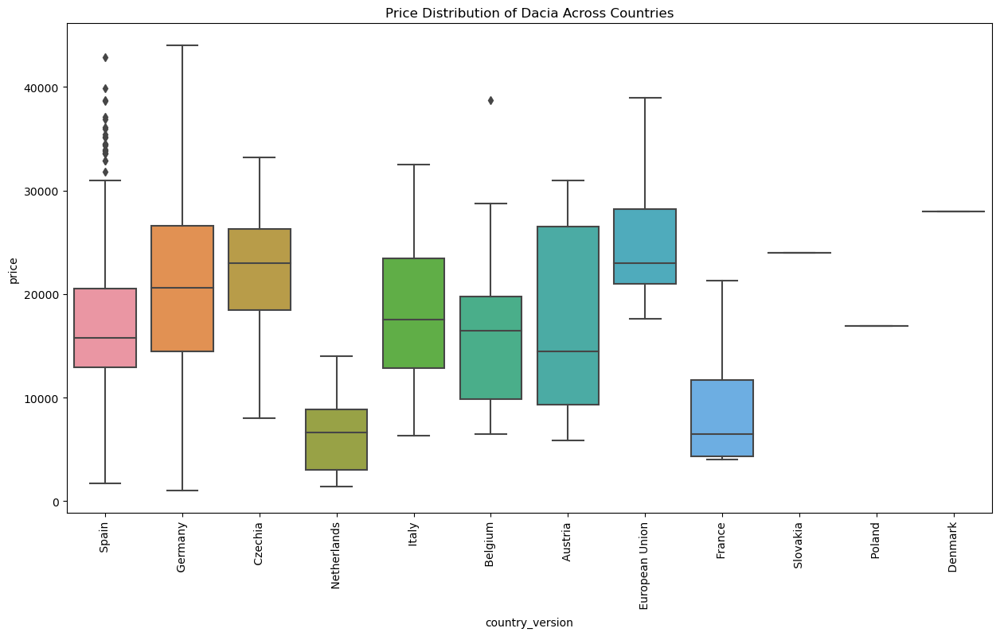

In [145]:
specific_make_df = df[df['make'] == 'Hyundai']

plt.figure(figsize=(15,8))
sns.boxplot(data=specific_make_df, x='country_version', y='price')
plt.title('Price Distribution of Dacia Across Countries')
plt.xticks(rotation=90)  # To make x-axis labels more readable
plt.show()

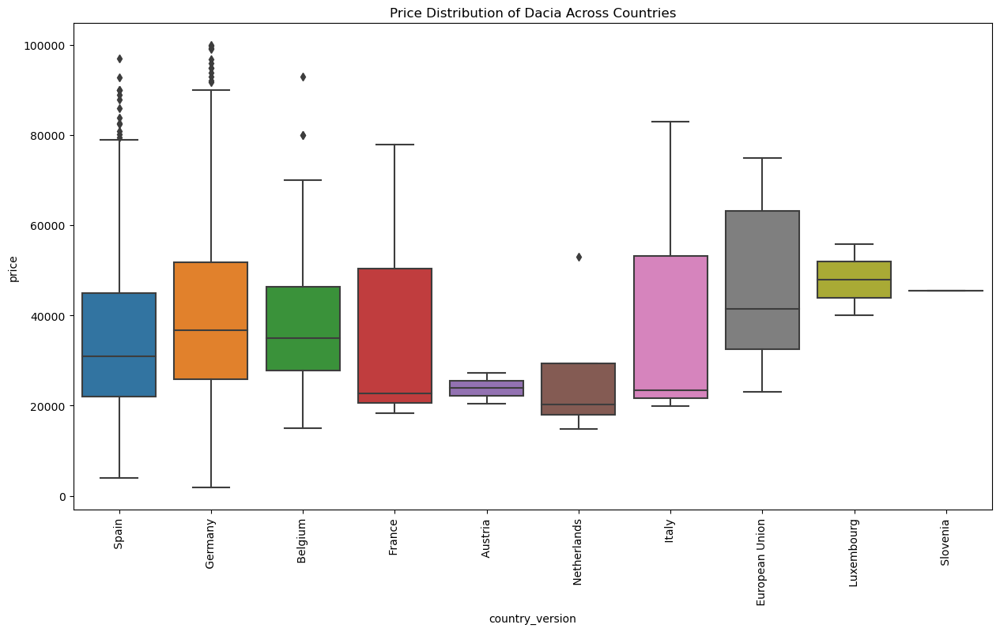

In [144]:
specific_make_df = df[df['make'] == 'Mercedes-Benz']

plt.figure(figsize=(15,8))
sns.boxplot(data=specific_make_df, x='country_version', y='price')
plt.title('Price Distribution of Dacia Across Countries')
plt.xticks(rotation=90)  # To make x-axis labels more readable
plt.show()

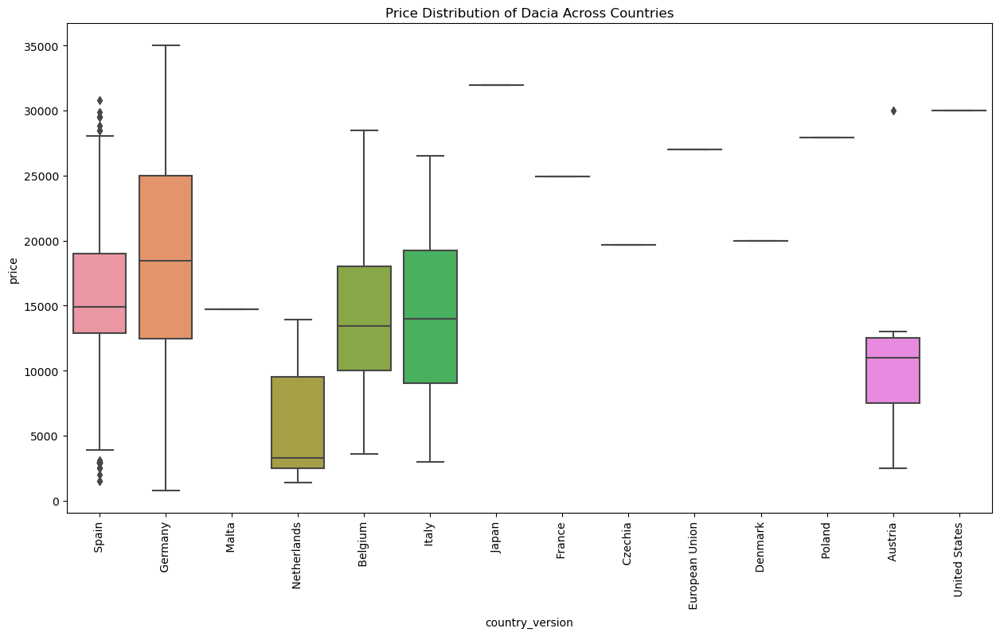

In [143]:
specific_make_df = df[df['make'] == 'Nissan']

plt.figure(figsize=(15,8))
sns.boxplot(data=specific_make_df, x='country_version', y='price')
plt.title('Price Distribution of Dacia Across Countries')
plt.xticks(rotation=90)  # To make x-axis labels more readable
plt.show()

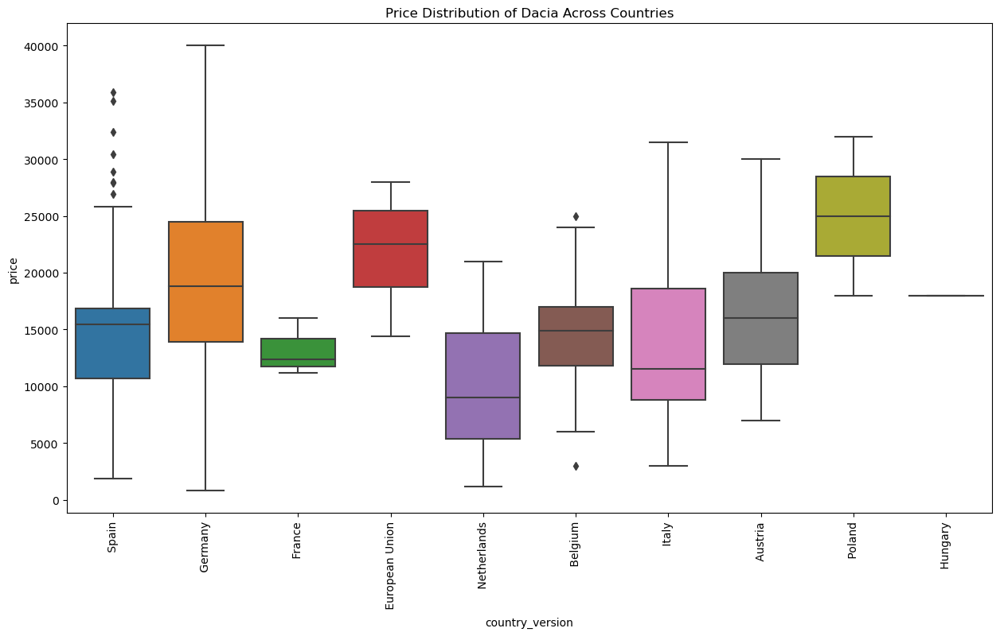

In [142]:
specific_make_df = df[df['make'] == 'Opel']

plt.figure(figsize=(15,8))
sns.boxplot(data=specific_make_df, x='country_version', y='price')
plt.title('Price Distribution of Dacia Across Countries')
plt.xticks(rotation=90)  # To make x-axis labels more readable
plt.show()

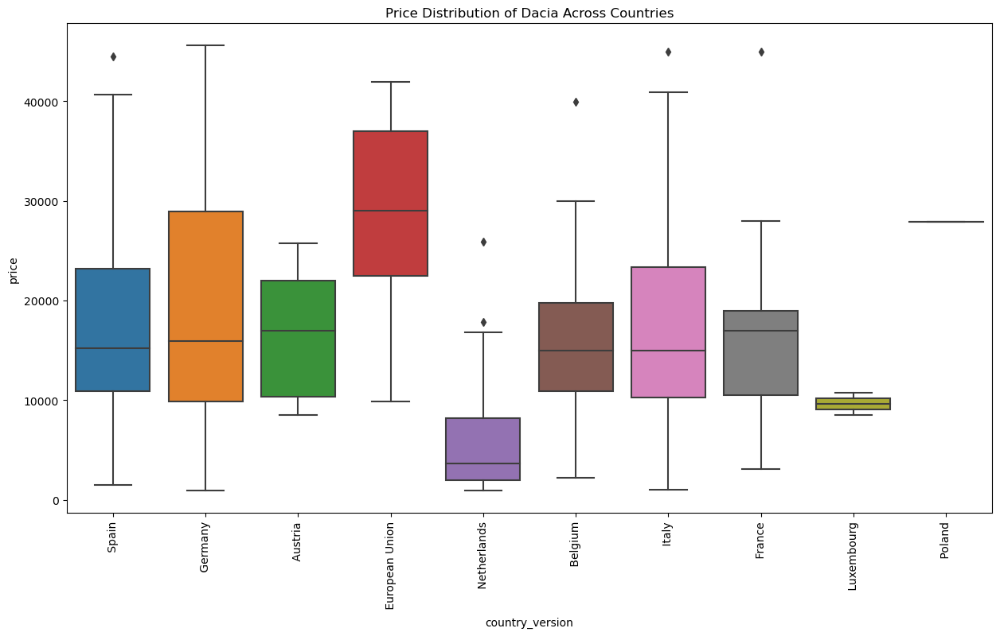

In [141]:
specific_make_df = df[df['make'] == 'Peugeot']

plt.figure(figsize=(15,8))
sns.boxplot(data=specific_make_df, x='country_version', y='price')
plt.title('Price Distribution of Dacia Across Countries')
plt.xticks(rotation=90)  # To make x-axis labels more readable
plt.show()

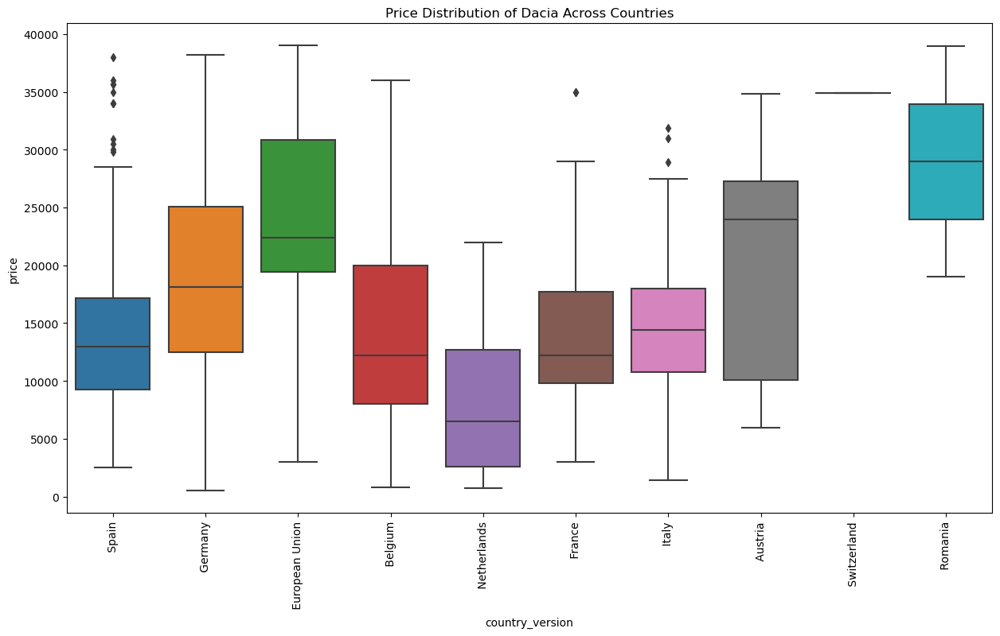

In [140]:
specific_make_df = df[df['make'] == 'Renault']

plt.figure(figsize=(15,8))
sns.boxplot(data=specific_make_df, x='country_version', y='price')
plt.title('Price Distribution of Dacia Across Countries')
plt.xticks(rotation=90)  # To make x-axis labels more readable
plt.show()

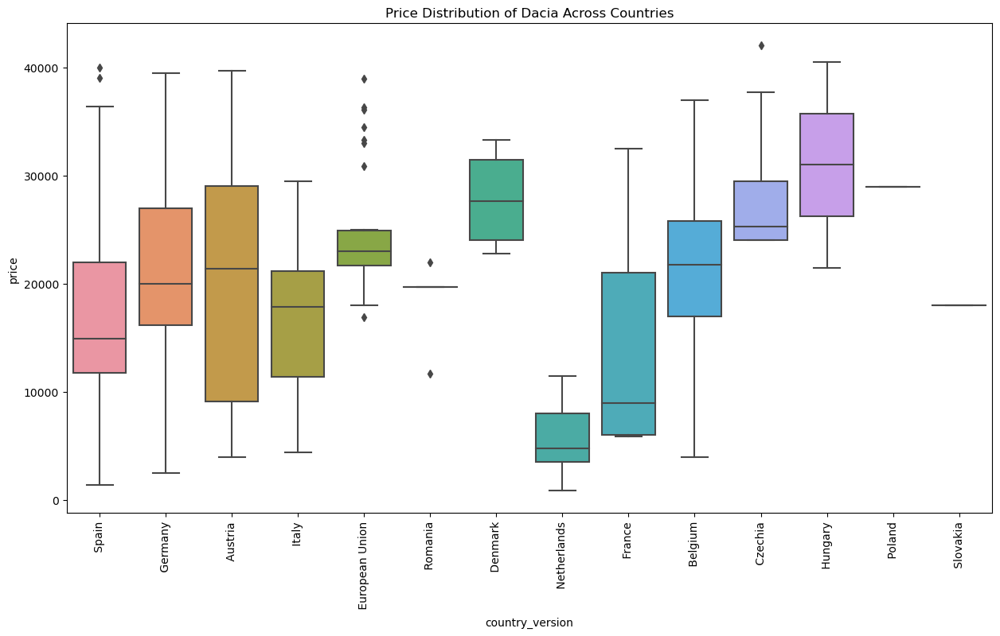

In [139]:
specific_make_df = df[df['make'] == 'SEAT']

plt.figure(figsize=(15,8))
sns.boxplot(data=specific_make_df, x='country_version', y='price')
plt.title('Price Distribution of Dacia Across Countries')
plt.xticks(rotation=90)  # To make x-axis labels more readable
plt.show()

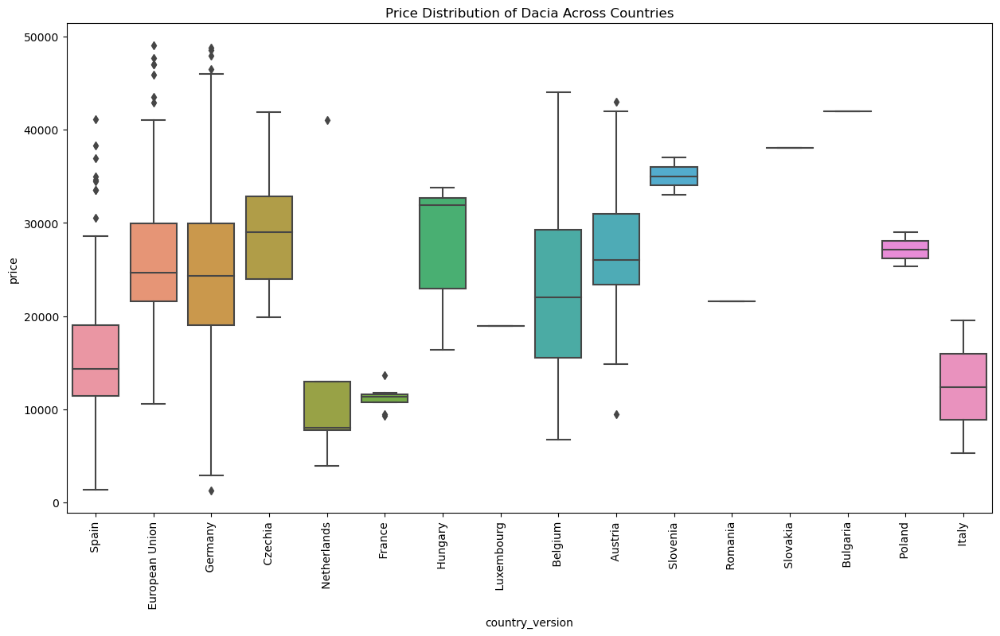

In [138]:
specific_make_df = df[df['make'] == 'Skoda']

plt.figure(figsize=(15,8))
sns.boxplot(data=specific_make_df, x='country_version', y='price')
plt.title('Price Distribution of Dacia Across Countries')
plt.xticks(rotation=90)  # To make x-axis labels more readable
plt.show()

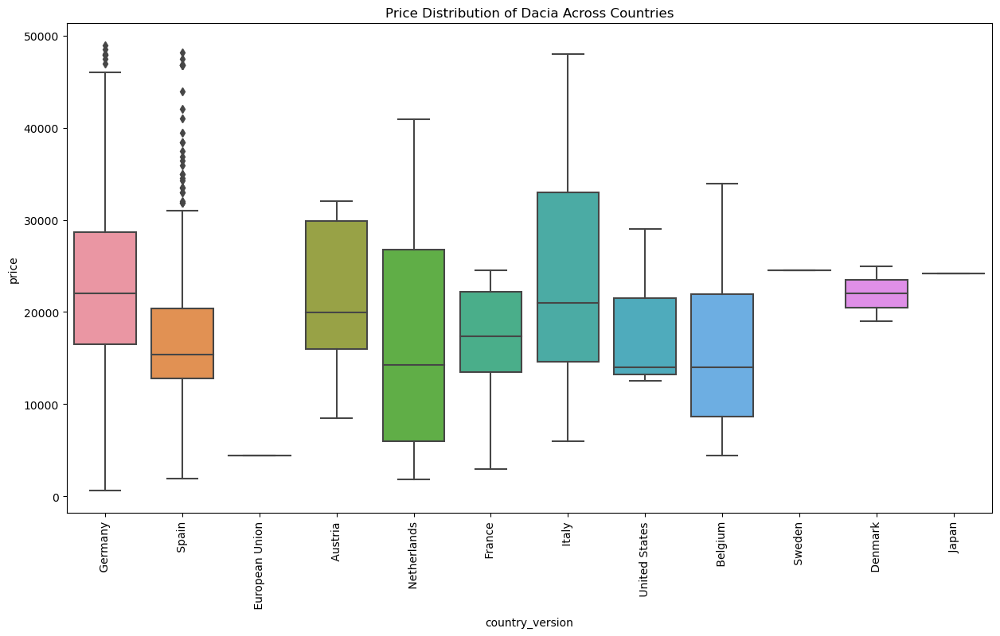

In [137]:
specific_make_df = df[df['make'] == 'Toyota']

plt.figure(figsize=(15,8))
sns.boxplot(data=specific_make_df, x='country_version', y='price')
plt.title('Price Distribution of Dacia Across Countries')
plt.xticks(rotation=90)  # To make x-axis labels more readable
plt.show()

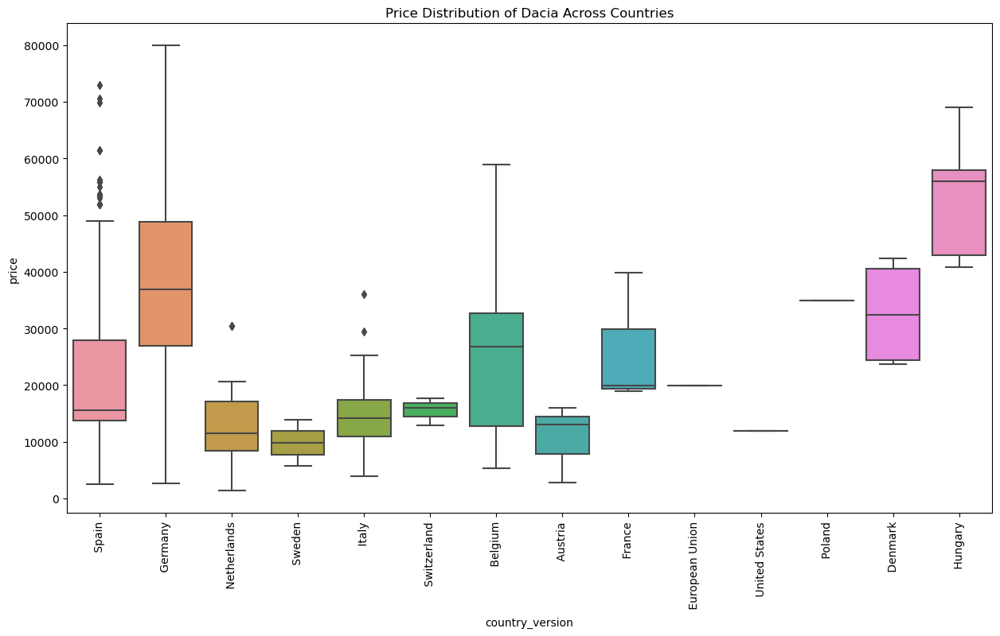

In [136]:
specific_make_df = df[df['make'] == 'Volvo']

plt.figure(figsize=(15,8))
sns.boxplot(data=specific_make_df, x='country_version', y='price')
plt.title('Price Distribution of Dacia Across Countries')
plt.xticks(rotation=90)  # To make x-axis labels more readable
plt.show()

### fuel_type

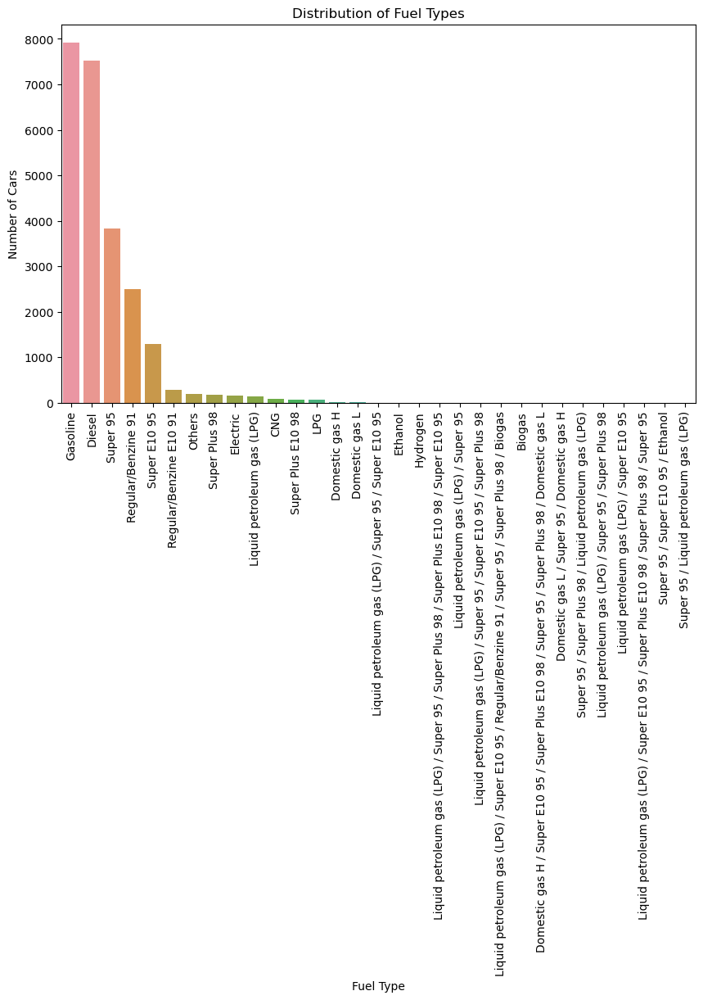

In [53]:
plt.figure(figsize=(10,6))
sns.countplot(x='fuel_type', data=df, order = df['fuel_type'].value_counts().index)
plt.title('Distribution of Fuel Types')
plt.xlabel('Fuel Type')
plt.ylabel('Number of Cars')
plt.xticks(rotation=90)
plt.show()

### fuel_consumption_comp

In [56]:
df.fuel_consumption_comb.describe()

count    25836.000000
mean         5.675824
std          2.814606
min          0.000000
25%          4.400000
50%          5.100000
75%          6.600000
max         99.900000
Name: fuel_consumption_comb, dtype: float64

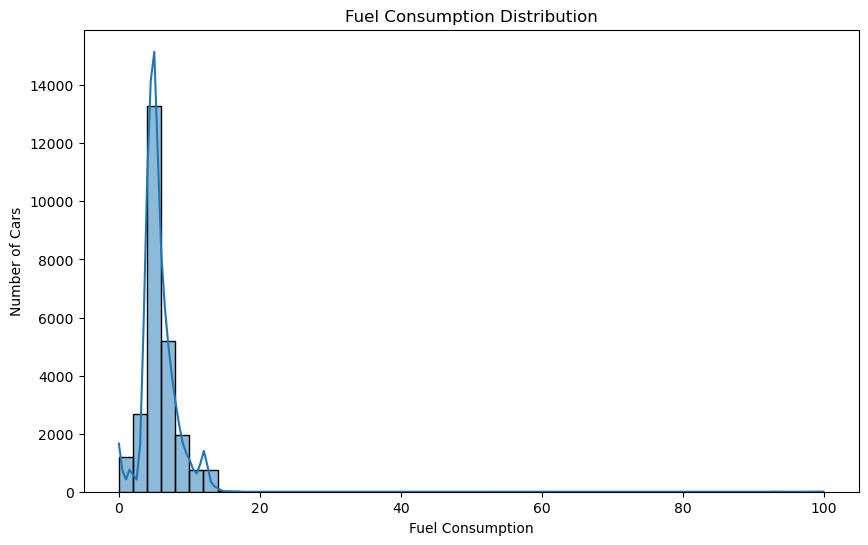

In [57]:
plt.figure(figsize=(10,6))
sns.histplot(data=df, x='fuel_consumption_comb', bins=50, kde=True)
plt.title('Fuel Consumption Distribution')
plt.xlabel('Fuel Consumption')
plt.ylabel('Number of Cars')
plt.show()


In [58]:
# calculate Q1, Q3 and IQR for 'fuel_type'
Q1 = df['fuel_consumption_comb'].quantile(0.25)
Q3 = df['fuel_consumption_comb'].quantile(0.75)
IQR = Q3 - Q1

In [62]:
print(Q1)
print(Q3)
print(IQR)

4.4
6.6
2.1999999999999993


In [65]:
# filter out rows for 'fuel_consumption_comp' that are outside the IQR
df = df[~((df['fuel_consumption_comb'] < (Q1 - 1.5 * IQR)) | (df['fuel_consumption_comb'] > (Q3 + 1.5 * IQR)))]

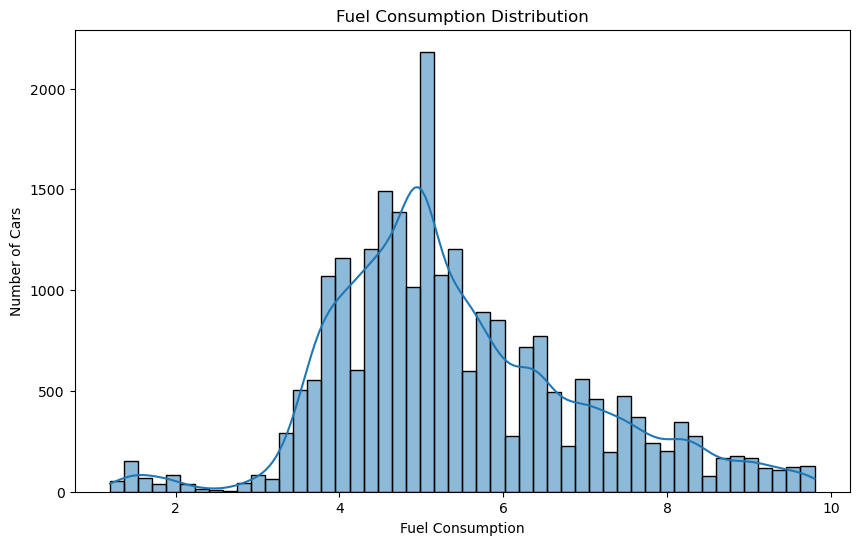

In [66]:
plt.figure(figsize=(10,6))
sns.histplot(data=df, x='fuel_consumption_comb', bins=50, kde=True)
plt.title('Fuel Consumption Distribution')
plt.xlabel('Fuel Consumption')
plt.ylabel('Number of Cars')
plt.show()

### Correlation

In [67]:
correlation_matrix = df.corr()
print(correlation_matrix)

                             index     price     seats     gears  cylinders  \
index                     1.000000 -0.053991  0.154011 -0.088525  -0.079468   
price                    -0.053991  1.000000  0.086914  0.368213   0.287347   
seats                     0.154011  0.086914  1.000000  0.100983  -0.123085   
gears                    -0.088525  0.368213  0.100983  1.000000   0.229704   
cylinders                -0.079468  0.287347 -0.123085  0.229704   1.000000   
empty_weight              0.040744  0.579571  0.206702  0.343945   0.432891   
production_date           0.021335  0.354797  0.190762  0.087004  -0.164184   
warranty_in_month        -0.034458  0.128878  0.033005  0.017968  -0.110895   
engine_size_cc           -0.012696  0.241527 -0.086259  0.285772   0.753402   
power_hp                 -0.035879  0.702535 -0.028717  0.406323   0.483160   
fuel_consumption_comb    -0.096388  0.057511 -0.270153  0.088214   0.333956   
fuel_consumption_city    -0.075345  0.064757 -0.2593

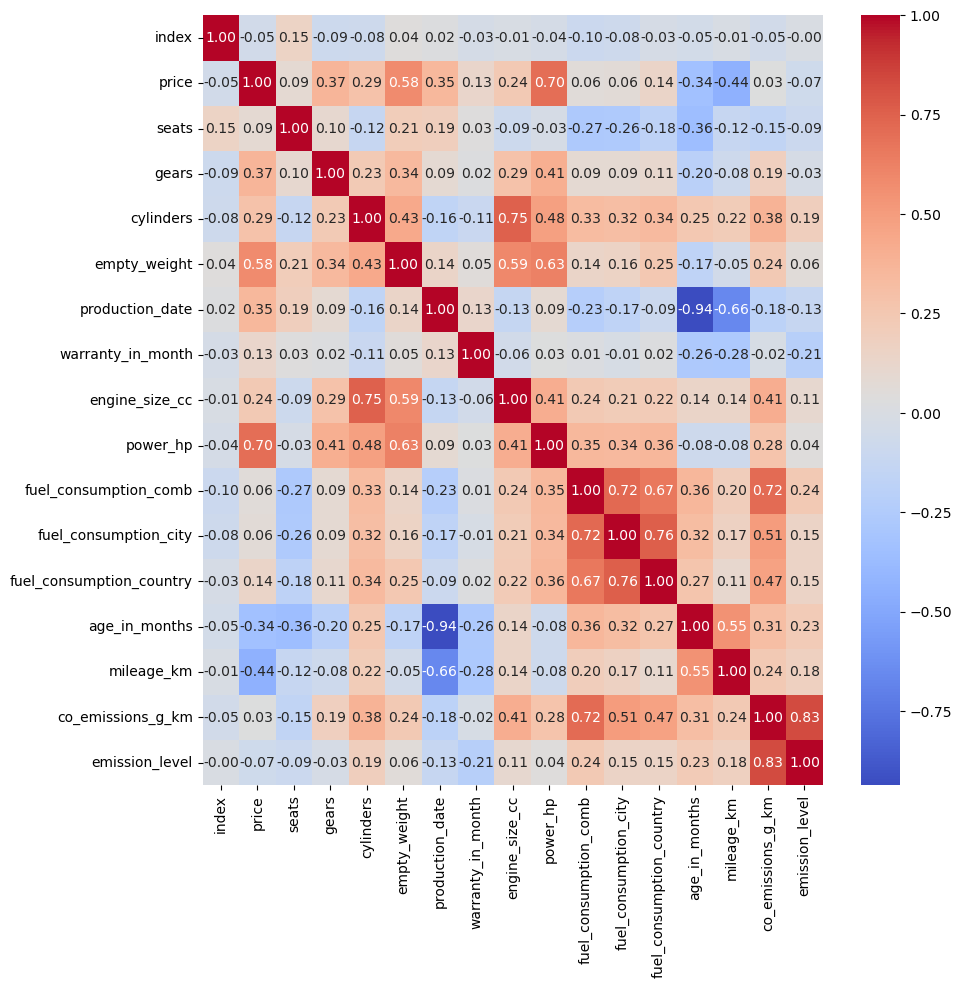

In [68]:
plt.figure(figsize=(10, 10))
sns.heatmap(correlation_matrix, annot=True, fmt=".2f", cmap='coolwarm')
plt.show()


In [70]:
# 0.9 to 1.00 | very high positive correlation
# 0.7 to 0.9  | high positive correlation
# 0.5 to 0.7  | moderate positive correlation
# 0.3 to 0.5  | low positive correlation
# 0.0 to 0.3  | negligible correlation

In [ ]:
# conclusion
Taken this into account, the most single influencable features for the price are

1. power_hp with 0.7
2. empty_weight with 0.58

### price

In [71]:
df.price.describe()

count     23428.000000
mean      21120.971701
std       16040.083582
min         500.000000
25%       11890.000000
50%       17379.500000
75%       26192.500000
max      250000.000000
Name: price, dtype: float64

In [72]:
df.price.sort_values().head(5)

18640    500
5349     500
16687    590
5191     600
5136     600
Name: price, dtype: int64

In [73]:
df.shape

(23428, 38)

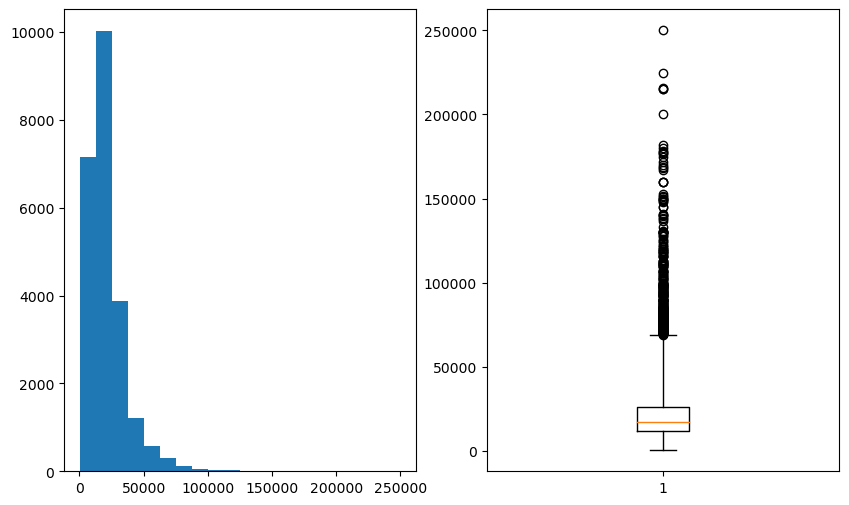

In [74]:
plt.figure(figsize=(10,6))
plt.subplot(121)
plt.hist(df.price, bins=20)

plt.subplot(122)
plt.boxplot(df.price, whis=3)

plt.show()

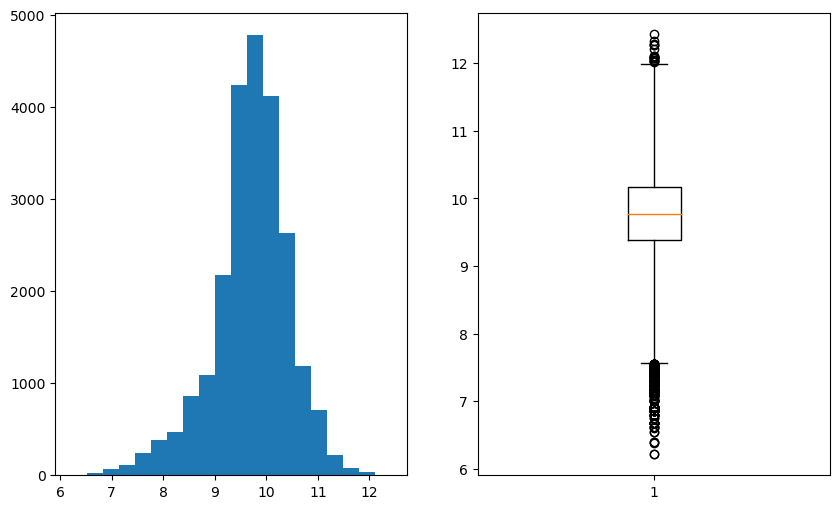

In [75]:
plt.figure(figsize=(10,6))
plt.subplot(121)
plt.hist(np.log(df.price), bins=20)

plt.subplot(122)
plt.boxplot(np.log(df.price), whis=2.3)

plt.show()

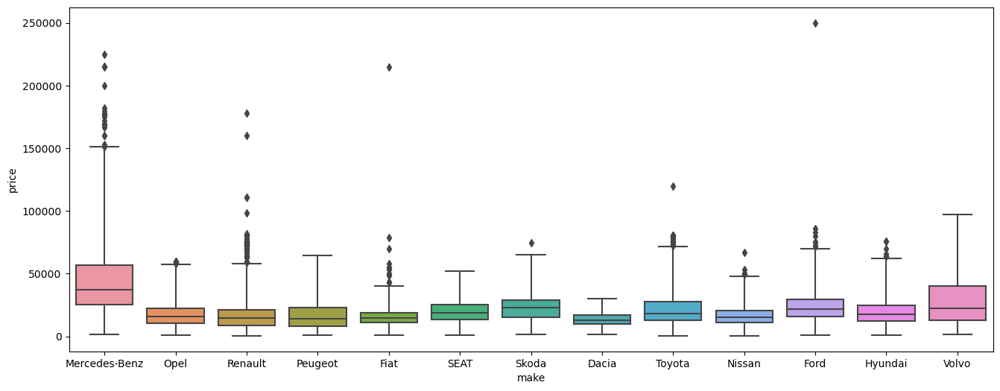

In [77]:
plt.figure(figsize=(16,6))
sns.boxplot(x="make", y="price", data=df, whis=3)
plt.show()

In [78]:
def remove_outliers(group):
    Q1 = group['price'].quantile(0.25)
    Q3 = group['price'].quantile(0.75)
    IQR = Q3 - Q1
    price_filter = (group['price'] >= Q1 - 1.5 * IQR) & (group['price'] <= Q3 + 1.5 * IQR)
    return group.loc[price_filter] 

In [80]:
df = df.groupby('make').apply(remove_outliers).reset_index(drop=True)

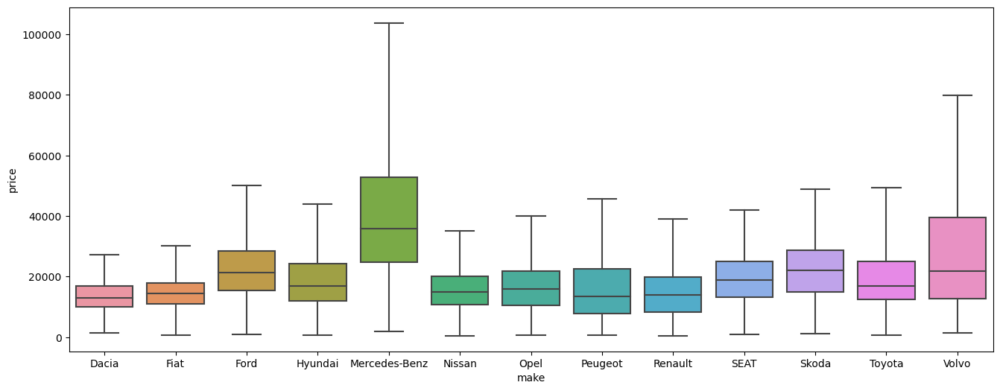

In [81]:
plt.figure(figsize=(16,6))
sns.boxplot(x="make", y="price", data=df, whis=3)
plt.show()

### Re-apply correlation after elemination of price outliers

In [83]:
correlation_matrix_cleaned_price = df.corr()
print(correlation_matrix_cleaned_price)

                             index     price     seats     gears  cylinders  \
index                     1.000000 -0.026786  0.157378 -0.088548  -0.070820   
price                    -0.026786  1.000000  0.162755  0.446982   0.226943   
seats                     0.157378  0.162755  1.000000  0.123044  -0.101370   
gears                    -0.088548  0.446982  0.123044  1.000000   0.202724   
cylinders                -0.070820  0.226943 -0.101370  0.202724   1.000000   
empty_weight              0.044682  0.569291  0.195468  0.366376   0.448168   
production_date           0.031040  0.392560  0.211405  0.108841  -0.188241   
warranty_in_month        -0.038570  0.140448  0.037647  0.016620  -0.118646   
engine_size_cc           -0.009186  0.215617 -0.077017  0.263385   0.737182   
power_hp                 -0.024328  0.693236 -0.002992  0.428042   0.461447   
fuel_consumption_comb    -0.091004  0.013013 -0.280789  0.075930   0.329649   
fuel_consumption_city    -0.071545  0.028156 -0.2691

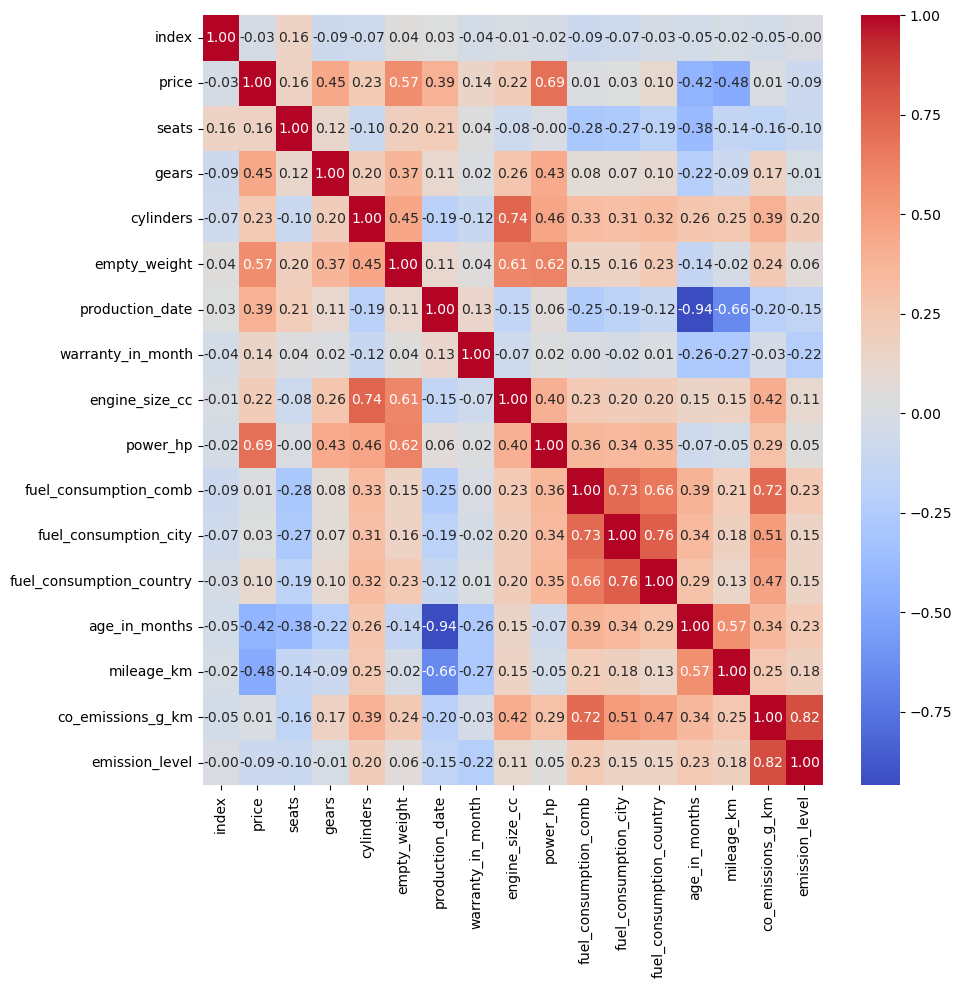

In [84]:
plt.figure(figsize=(10, 10))
sns.heatmap(correlation_matrix_cleaned_price, annot=True, fmt=".2f", cmap='coolwarm')
plt.show()

### Pairplot

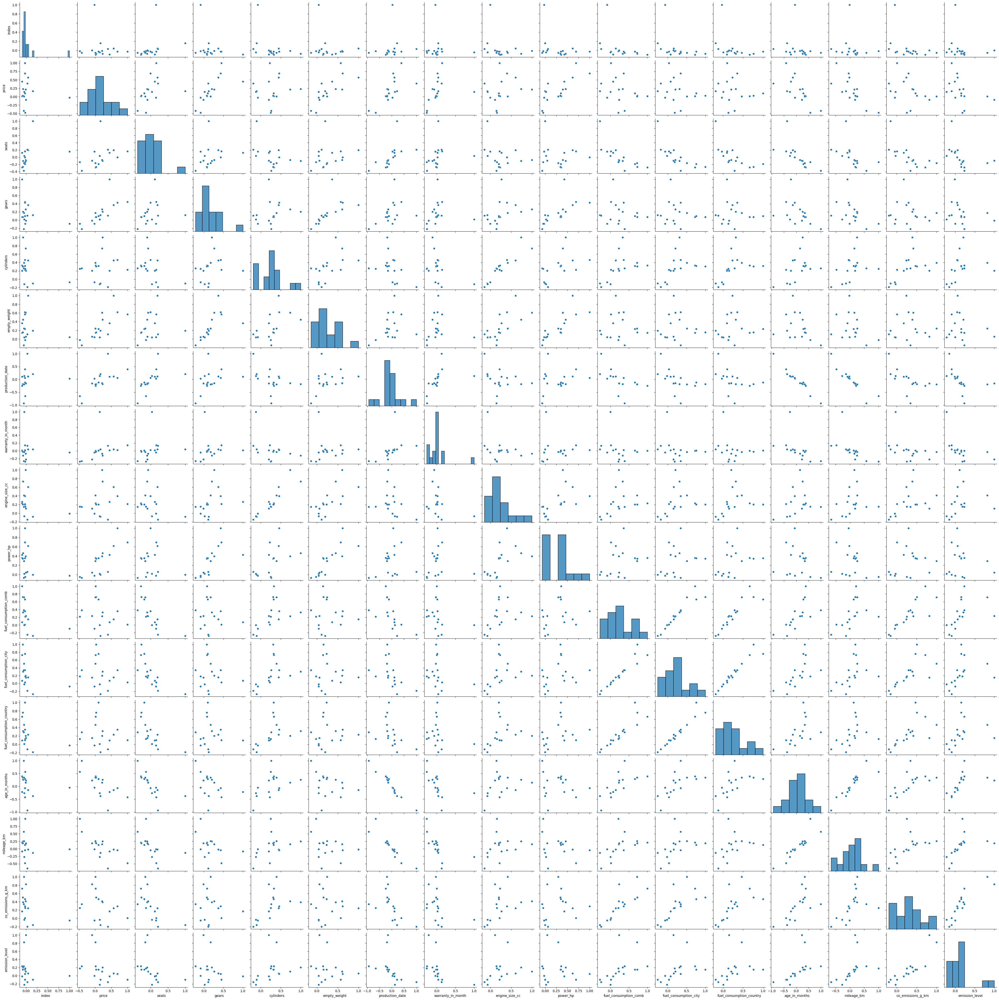

In [87]:
sns.pairplot(correlation_matrix_cleaned_price, size = 2.5)
plt.show()

# CONCLUSION
The most influencable features for the price are the "country_version" and within the country then,

1. power_hp with 0.7
2. empty_weight with 0.58
3. mileage_km with -0.48

## Export dataframe to csv file (without dummy)

In [164]:
df.to_csv("as24_cars_final.csv", index=False)